## Spherical Principal Curves 
1. initialization by principal Circle
2. principal curve

[reference]
- SOM  
Alan J. Izenman. Modern Multivariate Statistical Technique (2008) Springer.

- principal curve  
Hastie, T. and Stuetzle. Principal curves (1989) Journal of the American Statistical Association, 84:502-516.
https://web.stanford.edu/~hastie/Papers/Principal_Curves.pdf


In [21]:
import numpy as np
import matplotlib.pyplot as plt
import math as m
from mpl_toolkits.mplot3d import Axes3D
import pandas as pd
import torch
from torch.autograd import Variable
import time
import os

## 1. Earthquake Dataset

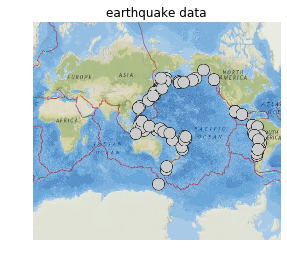

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
0,1976-01-14T16:47:33.500Z,-28.427,-177.657,33.0,8.0,ms,NaN,NaN,NaN,NaN,...,2016-11-10T02:39:03.544Z,Kermadec Islands region,earthquake,NaN,NaN,NaN,NaN,reviewed,us,us
1,1917-05-01T18:26:20.000Z,-31.080,-176.461,15.0,8.2,mw,NaN,NaN,NaN,NaN,...,2015-05-13T18:52:41.000Z,Kermadec Islands region,earthquake,NaN,NaN,NaN,NaN,automatic,iscgem,iscgem
2,1957-03-09T14:22:33.000Z,51.499,-175.626,25.0,8.6,mw,NaN,NaN,NaN,NaN,...,2018-02-23T22:35:37.825Z,"Andreanof Islands, Aleutian Islands, Alaska",earthquake,NaN,NaN,NaN,NaN,automatic,iscgem,official
3,1986-05-07T22:47:10.870Z,51.520,-174.776,33.0,8.0,mw,NaN,NaN,NaN,1.10,...,2018-01-11T21:42:14.190Z,"Andreanof Islands, Aleutian Islands, Alaska",earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv
4,2006-05-03T15:26:40.290Z,-20.187,-174.123,55.0,8.0,mwc,626.0,20.7,NaN,1.18,...,2017-11-13T16:23:42.955Z,Tonga,earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv


In [22]:
# dataset image
plt.figure()
plt.axis("off")
plt.title("earthquake data")
image= plt.imread("images/earthquake.jpg")
plt.imshow(image)
plt.show()

# load dataset
data= pd.read_csv("data/earthquake_new.csv")
data.head()

## 2. Functions

#### general utils

In [23]:
'''change representation of data_set or data_point'''
def rad2euclid(x):
    # change data representation from radian to euclidian
    # Input:= 1차원인경우 ((경도, 위도), shape: [2,]), 2차원인경우 (1행: 경도, 2행: 위도, shape: [2, n])
    # output:= input과 차원이 같음. 3차원 좌표계로 변환. (shape: [3,] or [3,n])
    if x.ndim==2:
        t1= x[0,:]
        t2= x[1,:]
        output= np.vstack((np.sin(t1)*np.cos(t2), np.sin(t1)*np.sin(t2) ,np.cos(t1)))
    elif x.ndim==1:
        t1= x[0]
        t2= x[1]
        output= np.array([np.sin(t1)*np.cos(t2), np.sin(t1)*np.sin(t2) ,np.cos(t1)])    
    else :
        raise AssertionError("input dim should be 1 or 2")
    return output


def euclid2rad(x):
    # change data representation from radian to euclidian
    # inverse function of rad2euclid
    if x.ndim==2:
        x[2,:][x[2,:]>1] = 1.
        output= np.vstack((np.arccos(x[2,:]),np.arctan2(x[1,:],x[0,:])))
    elif x.ndim==1:
        if x[2] >1:
            x[2] = 1.
        output= np.array([np.arccos(x[2]),np.arctan2(x[1],x[0])])
    else :
        raise AssertionError("input dim should be 1 or 2")
    return output


'''rotation and inverse-rotation for euclidian representation'''
def rotate(p, x):
    # 구면 위의 p가 (0,0,1)로 돌리는 rotation을 x에 적용
    # Input:= p= 구면 위의 3차원 좌표 (shape: [3,])
    #         x= 구면 위의 3차원 데이터. (shape: [3, n]) 
    # ouput:= rotated x.
    if (p[0]==0) & (p[1]==0) :
        c= 1
        s= 0
    else:
        c = p[0]/(np.sqrt(p[0]**2 + p[1]**2))
        s = p[1]/(np.sqrt(p[0]**2 + p[1]**2))
    
    R1 = np.array([[c, s, 0],
                  [-s, c, 0],
                  [0, 0, 1]])
    # R! makes p to [*, 0, *]
    
    xy= np.sqrt(p[0]**2 + p[1]**2)
    z = p[2] 
    c2 = z/np.sqrt(z**2 + xy**2)
    s2 = xy/np.sqrt(z**2 + xy**2)
    
    R2 = np.array([[c2, 0, -s2],
                  [0, 1, 0],
                  [s2, 0, c2]])
    # R2, R1 makes p to [0,0,1]
    
    output = np.dot(R2, np.dot(R1, x))
    
    return output


def inv_rotate(p, x):
    # rotate funtion과 반대로 (0,0,1)을 p로 돌리는 rotation을 x에 적용. 
    if (p[0]==0) & (p[1]==0) :
        c= 1
        s= 0
    else:
        c = p[0]/(np.sqrt(p[0]**2 + p[1]**2))
        s = p[1]/(np.sqrt(p[0]**2 + p[1]**2))
    
    R1 = np.array([[c, s, 0],
                  [-s, c, 0],
                  [0, 0, 1]])
    
    xy= np.sqrt(p[0]**2 + p[1]**2)
    z = p[2] 
    c2 = z/np.sqrt(z**2 + xy**2)
    s2 = xy/np.sqrt(z**2 + xy**2)
    
    R2 = np.array([[c2, 0, -s2],
                  [0, 1, 0],
                  [s2, 0, c2]])
        
    output = np.dot(np.linalg.inv(np.dot(R2, R1)), x)
    
    return output


'''rotation and inverse-rotation for euclidian representation'''
def exp_map(p, x):
    # tangent space to sphere at p
    # input:= 구면 위의 점 p (shape: [3,])
    #        tangent space 좌표 x (shape: [2,] or [2, n])
    # output:= x에 대응되는 구면위의 좌표 (shape: [3,] or [3, n])
    eps= 1e-5
    if x.ndim==1:
        mag= np.sqrt(np.sum(x**2))+ eps
        exp_x= np.array([x[0]*np.sin(mag)/mag, x[1]*np.sin(mag)/mag, np.cos(mag)])
        output= inv_rotate(p, exp_x)
        
    elif x.ndim==2:
        mag= np.sqrt(np.sum(x**2, axis=0))+ eps
        exp_x= np.vstack((x[0,:]*np.sin(mag)/mag, x[1,:]*np.sin(mag)/mag, np.cos(mag)))
        output= inv_rotate(p, exp_x)

    return output

def log_map(p, x):
    # sphere to tangent space at p
    # exp_map의 inverse
    rx = np.clip(rotate(p,x), a_min= -1, a_max= 1)
    eps = 1e-9
    
    if rx.ndim==2:
        theta= np.arccos(rx[2,:]) + eps
        output= np.vstack((rx[0,:]*theta/np.sin(theta), rx[1,:]*theta/np.sin(theta)))
    elif rx.ndim==1:
        theta= np.arccos(rx[2]) + eps
        output= np.array((rx[0]*theta/np.sin(theta), rx[1]*theta/np.sin(theta)))
        
    return output


'''3d plot'''
def plot_sphere(x, title, extra= None, line = False, extra2= None):
    # 구면위의 데이터들 visualization function.
    # input:= x (shape: [3, n])
    #         titile= 제목
    #         extra= 추가 데이터
    #         line= 추가 데이터를 선으로 그릴건지 여부 (아닐시 점으로 표현) 
    fig = plt.figure(figsize=(7,7))
    ax = fig.add_subplot(111, projection='3d')
    
    # plot sphere
    u1, v1 = np.mgrid[0:2*np.pi:20j, 0:np.pi:10j]
    x_ = np.cos(u1)*np.sin(v1)
    y_ = np.sin(u1)*np.sin(v1)
    z_ = np.cos(v1)
    ax.plot_wireframe(x_, y_, z_, color="g", linewidth= 0.5)
    
    #plot data
    ax.scatter(x[0,], x[1,], x[2,], c= 'b', s=4)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.set_title("{}\n".format(title), fontsize=14)

    ax.set_xlim([-1,1])
    ax.set_ylim([-1,1])
    ax.set_zlim([-1,1])
    ax.set_xticks([-1, 0, 1])
    ax.set_yticks([-1, 0, 1])
    ax.set_zticks([-1, 0, 1])

    # plot extra data or line
    if extra is not None:
        if extra.ndim==1 :
            ax.scatter(extra[0], extra[1], extra[2], c= 'r', s=3)
        elif extra.ndim==2 :
            if line is False:
                ax.plot(extra[0,:], extra[1,:], extra[2,:], c= 'm', linewidth=1)
                ax.scatter(extra[0,:], extra[1,:], extra[2,:], c= 'r', s=3)
            else : 
                ax.plot(extra[0,:], extra[1,:], extra[2,:], c= 'r', linewidth=1)
                
    if extra2 is not None:
        if extra2.ndim==1 :
            ax.scatter(extra2[0], extra2[1], extra2[2], c= 'm', s=20)
        elif extra2.ndim==2 :
            if line is False:
                ax.scatter(extra2[0,:], extra2[1,:], extra2[2,:], c= 'm', s=4)
            else : 
                ax.plot(extra2[0,:], extra2[1,:], extra2[2,:], c= 'm', linewidth=1)
    plt.show()

#### pga

In [24]:
''' calculate intrinsic mean of points on sphere'''
def intrinsic_mean(points, weights= None, is_print= False, intrinsic= True, median=False):
    # calculate intrinsic mean by gradient descent (see, Fletcher, P. T., Lu, C., Pizer, S. M. and Joshi, S. (2004). Principal geodesic analysis forthe study of nonlinear statistics of shape)
    # input:= points= input data (shape: [3,n])
    #         weights= weights for each data point ([n,])
    #        is_print= print optimization process or not
    #        intrinsic= intrinsic mean or extrinsic mean (for extrinsic principal curve)
    # output:= mean on the sphere (shape: [3,])
    N= points.shape[1]
    if weights is None:
        weights = 1./N
    else :
        weights = weights/np.sum(weights)
        weights = np.expand_dims(weights, axis=0)
    
    if intrinsic: 
        u = np.mean(weights*points, axis=1)
        u = u/np.sqrt(np.sum(u**2))

        for i in range(100):
            delta_u = np.sum(weights*log_map(u, points), axis= 1)
            u= exp_map(u, delta_u)

            if sum(delta_u**2)< 1e-10:
                if is_print is True:
                    print("optimization is ended (iter : %d)"%(i+1))
                    print("number of points:", points.shape[1])
                break            
    elif median:
        u = np.mean(weights*points, axis=1)
        u = u/np.sqrt(np.sum(u**2))

        for i in range(100):
            u_logmap = log_map(u, points)
            delta_u = np.sum(weights * u_logmap / np.sqrt(np.sum(u_logmap**2, axis=0, keepdims=True) + 1e-6), axis= 1) / np.sum(weights) / (i+1)
            u= exp_map(u, delta_u)

            if sum(delta_u**2)< 1e-10:
                if is_print is True:
                    print("optimization is ended (iter : %d)"%(i+1))
                    print("number of points:", points.shape[1])
                break                    
    else : 
        u = np.sum(weights*points, axis=1)
        u = u/np.sqrt(np.sum(u**2))
        
    return u

#### principal circle

In [25]:
'''calculate (sum of) distance for radian representation'''
def distance(p, x):
    # geodesic distance from point p to data x
    # 각 좌표들은 극좌표계로 표현됨.
    # input:= p= 구면 위의 점 (shape: [2,])
    #         x= 구면 위의 데이터 (shape: [2,] or [2, n])
    # output:= p와 x들까지의 거리 (shape: [n,])
    if x.ndim==2:
        data1 = x[0,:]
        data2 = x[1,:]
    elif x.ndim==1:
        data1 = x[0]
        data2 = x[1]
    else :
        raise AssertionError("input dim should be 1 or 2")
    d = np.cos(data1)*np.cos(p[0]) + np.sin(data1)*np.sin(p[0])*np.cos(data2-p[1])
    if x.ndim==1:
        if d > 1:
            d=1.
    output = np.arccos(d)
    return output

def circle_distance(p1, p2, p3, x):
    # eq. (6) 계산. (구면위의 원과 데이터까지의 거리 합)
    # 이 함수의 경우, input은 torch tensor
    # input:= (p1, p2, p3)= (theta_c, delta_c, r)
    #          x= 구면 위의 데이터 (shape: [2, n])
    # output:= scalar 값
    data1 = x[0,:]
    data2 = x[1,:]
    p1_= p1.expand_as(data1) 
    p2_= p2.expand_as(data2)
    
    output = torch.acos(torch.cos(data1)*torch.cos(p1_)+torch.sin(data1)*torch.sin(p1_)*torch.cos(data2-p2_))
    p3_= p3.expand_as(output)
    
    return torch.mean((m.pi/2*p3_-output)**2)

In [26]:
'''perform principal circle'''
def pga_circle(x_theta, is_print = False):
    # optimize distance between data and circle represented by 3 parameters (center, latitude)
    # input:= x_theta= 극좌표계 input data (shape: [2, n])
    # output:= 최적화된 원의 중심 점 (shape: [2,])
    #          최적화된 원의 반지름 (shape: [1,])
    x_theta_torch= Variable(torch.DoubleTensor(x_theta), requires_grad=True)
    p = Variable(torch.DoubleTensor([0,0,1]), requires_grad=True)
    lr = 1

    if is_print is True:
        print("iteration start")
        print("initial value")
        print("p : ", p.data.numpy())

    for i in range(100):
        loss = circle_distance(p[0],p[1],p[2], x_theta_torch)
        loss.backward()
        if is_print is True:
            print("\niteration : %d"%(i+1))
            print("loss : %f"%loss.data.numpy())
            print("p : ", p.data.numpy())
            print(p.grad)

        p.data[:2] -= lr*p.grad.data[:2]
        p.data[2] -= 0.05*p.grad.data[2]

        if np.sum(np.abs(p.grad.data.numpy())) < 1e-4 :
            if is_print is True:
                print("\noptimization is succeeded, iteration : %d"%i)
                print("p : ", p.data.numpy())
            break

        p.grad.data.zero_()
    
    # p3 is longitude of circle
    p3 = (p.data.numpy()[2])*m.pi/2
    
    # p_ is center of circle
    p_= np.array([np.sin(p.data.numpy()[0])*np.cos(p.data.numpy()[1]),
             np.sin(p.data.numpy()[0])*np.sin(p.data.numpy()[1]) ,np.cos(p.data.numpy()[0])])

    return p_, p3

### Principal Curve
1. initialial projection on principal circle
2. train curve  
1) update points on curve (by weighted expectation)  
2) project data points on curve  
3) calculate distance

hyperpameters   
-neighborhood ratio

In [55]:
def plot_curve(x, points, exact, intrinsic, median, n_point, q, save_figure=False, data_name='', lambda_arr=None):
    # curve 그리는 함수
    if lambda_arr is not None:
        points = points[:, np.argsort(lambda_arr)]
    
    fig = plt.figure(figsize=(7,7))
    ax = fig.add_subplot(111, projection='3d')

    # draw sphere
    u1, v1 = np.mgrid[0:2*np.pi:20j, 0:np.pi:10j]
    x_ = np.cos(u1)*np.sin(v1)
    y_ = np.sin(u1)*np.sin(v1)
    z_ = np.cos(v1)
    ax.plot_wireframe(x_, y_, z_, color="g", linewidth= 0.5)

    ax.scatter(x[0,], x[1,], x[2,], c= 'b', s=4)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.set_xlim([-1,1])
    ax.set_ylim([-1,1])
    ax.set_zlim([-1,1])
    ax.set_xticks([-1, 0, 1])
    ax.set_yticks([-1, 0, 1])
    ax.set_zticks([-1, 0, 1])
    
#     points_add= points
    points_add = []
    n = points.shape[1]
    for i in range(n):
        a = points[:, i]
        b = points[:, (i+1)%n]

        rot_a = rotate(a, np.stack([a,b], axis=1))
        center= rad2euclid(np.array([m.pi/2., euclid2rad(rot_a)[1,1] + m.pi/2.]))
        rot_c = euclid2rad(rotate(center, rot_a))

        a_ = rot_c[:,0]
        b_ = rot_c[:,1]
        theta1 = np.minimum(a_[1], b_[1])
        theta2 = np.maximum(a_[1], b_[1])

        if (theta2 - theta1) > m.pi:
            theta_inter = np.linspace(theta2, theta1 + m.pi*2, (theta1 + m.pi*2 - theta2)//(m.pi/20) + 2)
            theta_inter[theta_inter>m.pi] -= m.pi*2
        else :
            theta_inter = np.linspace(theta1, theta2, (theta2 - theta1)//(m.pi/40) + 2)
        
        x_inter = np.stack([np.array([a_[0] for _ in range(theta_inter.shape[0])]), theta_inter], axis=0)
        x_inter = inv_rotate(a, inv_rotate(center, rad2euclid(x_inter)))
        points_add.append(x_inter[:,:-1])

    points_add= np.concatenate(points_add, axis=1)
    points_add= np.concatenate([points_add, points[:,0:1]], axis=1)
    
    if exact:
        if intrinsic:
            title= "ours (intrinsic)"
        elif median:
            title= "ours (median)"
        else:
            title= "ours (extrinsic)"
    else:
        title= "Haubreg's"
    ax.set_title("{}\n(T= {}/ q= {})\n".format(title, n_point, q), fontsize=14)

    ax.plot(points_add[0,:], points_add[1,:], points_add[2,:], c= 'm', linewidth=1)
    ax.scatter(points[0,:], points[1,:], points[2,:], c= 'r', s=3)
    
    if save_figure:
        os.makedirs("results/Figures/{}".format(data_name), exist_ok=True)
        if exact:
            if intrinsic:
                title= "ours_intrinsic"
            else:
                title= "ours_extrinsic"
        else:
            title= "Haubreg"
        plt.savefig("results/Figures/{}/{}.jpg".format(data_name, "{}_n{}_q{}".format(title, n_point, q)))
        
    plt.show()

    
def plot_projection(x, points, projected, exact, intrinsic, median, n_point, q, save_figure=False, data_name='', lambda_arr=None):
    # curve 그리는 함수
    if lambda_arr is not None:
        points = points[:, np.argsort(lambda_arr)]
    
    fig = plt.figure(figsize=(7,7))
    ax = fig.add_subplot(111, projection='3d')

    # draw sphere
    u1, v1 = np.mgrid[0:2*np.pi:20j, 0:np.pi:10j]
    x_ = np.cos(u1)*np.sin(v1)
    y_ = np.sin(u1)*np.sin(v1)
    z_ = np.cos(v1)
    ax.plot_wireframe(x_, y_, z_, color="g", linewidth= 0.5)

    ax.scatter(x[0,], x[1,], x[2,], c= 'b', s=4)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.set_xlim([-1,1])
    ax.set_ylim([-1,1])
    ax.set_zlim([-1,1])
    ax.set_xticks([-1, 0, 1])
    ax.set_yticks([-1, 0, 1])
    ax.set_zticks([-1, 0, 1])
    
    points_add = []
    n = points.shape[1]
    for i in range(n):
        a = points[:, i]
        b = points[:, (i+1)%n]

        rot_a = rotate(a, np.stack([a,b], axis=1))
        center= rad2euclid(np.array([m.pi/2., euclid2rad(rot_a)[1,1] + m.pi/2.]))
        rot_c = euclid2rad(rotate(center, rot_a))

        a_ = rot_c[:,0]
        b_ = rot_c[:,1]
        theta1 = np.minimum(a_[1], b_[1])
        theta2 = np.maximum(a_[1], b_[1])

        if (theta2 - theta1) > m.pi:
            theta_inter = np.linspace(theta2, theta1 + m.pi*2, (theta1 + m.pi*2 - theta2)//(m.pi/20) + 2)
            theta_inter[theta_inter>m.pi] -= m.pi*2
        else :
            theta_inter = np.linspace(theta1, theta2, (theta2 - theta1)//(m.pi/40) + 2)
        
        x_inter = np.stack([np.array([a_[0] for _ in range(theta_inter.shape[0])]), theta_inter], axis=0)
        x_inter = inv_rotate(a, inv_rotate(center, rad2euclid(x_inter)))
        points_add.append(x_inter[:,:-1])

    points_add= np.concatenate(points_add, axis=1)
    points_add= np.concatenate([points_add, points[:,0:1]], axis=1)
    
    if exact:
        if intrinsic:
            title= "ours (intrinsic)"
        elif median:
            title= "ours (median)"
        else:
            title= "ours (extrinsic)"
    else:
        title= "Haubreg's"
    ax.set_title("{}\n(T= {}/ q= {})\n".format(title, n_point, q), fontsize=14)

    ax.plot(points_add[0,:], points_add[1,:], points_add[2,:], c= 'm', linewidth=1)
    ax.scatter(projected[0,:], projected[1,:], projected[2,:], c= 'g', s=3)

    for j in range(x.shape[1]):
        project_line = np.stack([x[:, j], projected[:, j]], axis=1)
        ax.plot(project_line[0,:], project_line[1,:], project_line[2,:], c= 'b', linewidth=1)
    
    if save_figure:
        os.makedirs("results/Figures/{}".format(data_name), exist_ok=True)
        if exact:
            if intrinsic:
                title= "ours_intrinsic"
            else:
                title= "ours_extrinsic"
        else:
            title= "Haubreg"
        plt.savefig("results/Figures/{}/{} (projected).jpg".format(data_name, "{}_n{}_q{}".format(title, n_point, q)))
        
    plt.show()

    
def project_seg(x,a,b,exact = True):
    # projection on geodesic segment a-b
    # input:= x= 3차원 구면위의 데이터 (shape: [3,])
    #         a, b= 구면 위의 두 점 (각각 shape: [3,])
    #         exact= exact projection을 할지 여부 (False일시 a,b 중에서 x와 가까운 점을 고르게 됨)
    # output:= dist= projected point까지의 거리
    #          x_proj= projected point
    if exact == True:
        # projection of x on a-b
        rot_a = rotate(a, np.stack([x,a,b], axis=1))
        center= rad2euclid(np.array([m.pi/2., euclid2rad(rot_a)[1,2] + m.pi/2.]))
        rot_c = euclid2rad(rotate(center, rot_a))
        x_ = rot_c[:,0]
        a_ = rot_c[:,1]
        b_ = rot_c[:,2]
        x_proj = np.copy(x_)
        x_proj[0] = m.pi/2.
        dist = np.abs(x_[0]- m.pi/2.)

        # the longitude angle is from -pi ~ pi
        if (np.maximum(a_[1], b_[1]) - np.minimum(a_[1], b_[1]))>m.pi:
            if (x_proj[1] <= np.minimum(a_[1], b_[1])) or (x_proj[1] > np.maximum(a_[1], b_[1])):
                pass
            else :
                if (x_proj[1] - np.minimum(a_[1], b_[1])) <= (np.maximum(a_[1], b_[1]) - x_proj[1]):
                    x_proj[1] = np.minimum(a_[1], b_[1])
                else :
                    x_proj[1] = np.maximum(a_[1], b_[1])
        else :
            if (x_proj[1] > np.minimum(a_[1], b_[1])) and (x_proj[1] <= np.maximum(a_[1], b_[1])):
                pass
            else :
                if x_proj[1]>=0:
                    if (x_proj[1] - np.maximum(a_[1], b_[1])) > (2*m.pi - (x_proj[1] - np.minimum(a_[1], b_[1]))):
                        x_proj[1] = np.minimum(a_[1], b_[1])
                    else :
                        x_proj[1] = np.maximum(a_[1], b_[1])                    
                else :
                    if (2*m.pi - (np.maximum(a_[1], b_[1]) - x_proj[1])) > (np.minimum(a_[1], b_[1])- x_proj[1]):
                        x_proj[1] = np.minimum(a_[1], b_[1])
                    else :
                        x_proj[1] = np.maximum(a_[1], b_[1])

        dist = distance(x_, x_proj)
        x_proj = inv_rotate(a,inv_rotate(center, np.expand_dims(rad2euclid(x_proj), axis=1)))
    else :
        x_ = euclid2rad(x)
        a_ = euclid2rad(a)
        b_ = euclid2rad(b)
        if distance(x_,a_) <= distance(x_,b_):
            dist =  distance(x_,a_)
            x_proj = a
        else :
            dist = distance(x_,b_)
            x_proj = b
    return dist, x_proj
    

def project_curve(data, points, exact = True):
    # project data on curve
    # ouput order is same as data order
    # input:= data= 3차원 데이터 (shape: [3, n])
    #         points= curve의 point들 (shape: [3, n_points])
    # output:= dist_arr= data와 curve까지의 거리들 (shape: [n,])
    #          transpose(projs)= projected data on the curve (shape: [3, n])
    #          lambda_arr= curve의 시작점과 projected point까지의 curve상의 거리 (expection step에서 필요, shape= [n, ])
    #          sum(geodesic_arr)= curve의 길이
    n_data = data.shape[1]
    n_points= points.shape[1]
    dist_arr = []
    projs = []
    lambda_arr = []
    geodesic_arr = [0]
    
    points_rad = euclid2rad(points)
    # curve의 points들의 geodesic거리 list
    for i in range(n_points-1):            
        geodesic_arr.append(geodesic_arr[i] + distance(points_rad[:,i], points_rad[:,i+1]))
    curve_len = geodesic_arr[-1] + distance(points_rad[:,-1], points_rad[:,0])

    for i in range(n_data):
        d_min=10
        proj_min = []
        seg_num= 0
        for j in range(n_points-1):
            d, proj = project_seg(data[:,i], points[:,j], points[:,j+1], exact = exact)
            if d <= d_min:
                d_min = d
                proj_min = np.squeeze(proj).tolist()
                seg_num = j

        dist_arr.append(d_min)
        projs.append(proj_min)
        lambda_arr.append(geodesic_arr[seg_num]+ distance(euclid2rad(points[:,seg_num]), euclid2rad(np.array(proj_min))))
        
    return np.array(dist_arr), np.transpose(np.array(projs)), np.array(lambda_arr), curve_len, geodesic_arr


def expectation(data, points, lambda_arr, geodesic_arr, curve_len, fraction, intrinsic, median, is_print):
    # update the curve
    # input:= data= 3차원 데이터 (shape: [3, n])
    #         points= curve의 point들 (shape: [3, n_points])
    #         lambda_arr= curve의 시작점과 projected point까지의 curve상의 거리 (shape= [n, ])
    #         curve_len= curve의 길이
    #         fraction= neighborhood hyperparameter
    #         intrinsic= mean을 intrinsic으로 할지 extrinsic으로 할지
    # output:= updated points (shape: [3, n_points])     
    n_point= points.shape[1]
    n_data= data.shape[1]
    
    thres = fraction * curve_len
    updated_points = np.copy(points)
    if is_print:
        print("curve length: {:.1f}".format(curve_len))
        
    positive = 0
    weight = np.zeros(shape=(n_point, n_data))
    for i in range(n_point):
        for j in range(n_data):
            dist = min(np.abs(geodesic_arr[i] - lambda_arr[j]),
                       curve_len - np.abs(geodesic_arr[i] - lambda_arr[j]))
            weight[i][j] = max(1 - (dist / thres)**2, 0)**2

        if np.sum(weight[i]>0) > 0:
            updated_points[:,i]= intrinsic_mean(data[:,weight[i]>0], weight[i][weight[i]>0], is_print= False, intrinsic=intrinsic, median=median)
            positive += np.sum(weight[i]>0)
        else:
            continue
    
    if is_print:
        print("positive data: ", positive//n_point)
        
    return updated_points

    
def train_principal_curve(data, init_project, iter, neigh_ratio= 0.35, exact=True, intrinsic=True, median=False,
                          is_print=False, print_last=True, save_fig=False, data_name='', thres=1e-2):
    # given data와 initialized curve에 대해 curve를 fitting하는 함수
    # input:= data= 3차원 데이터 (shape: [3, n])
    #         init_project= curve의 point들 (shape: [3, n_points])
    #         iter= iteration 횟수
    #         neigh_ratio= neighborhood hyperparameter
    #         exact= exact projection을 할지 아니면 Hauberg 방식의 projection을 할지 
    #         intrinsic= intrinsic principal curve or extrinsic
    # output:= points= principal curve (shape: [3, n_points])
    #          total_dist= reconstruction error
    #          lambda_arr= for ordering points (shape: [n_points, ])
    
    points= init_project
    n_point= points.shape[1]
    d, projected, lambda_arr, curve_len, geodesic_arr = project_curve(data, points, exact = exact)
            
    if is_print==True:
        plot_curve(data, points, exact, intrinsic, median, n_point, neigh_ratio)
        plot_projection(x, points, projected, exact, intrinsic, median. n_point, neigh_ratio)
        
    total_dist= sum(d**2)

    for i in range(iter):
        points = expectation(data, points, lambda_arr, geodesic_arr, curve_len, neigh_ratio, intrinsic, median, is_print)        
        d, projected, lambda_arr, curve_len, geodesic_arr= project_curve(data, points, exact = exact)
                
        if abs((total_dist- sum(d**2))/total_dist) < thres :
            break
        else :
            total_dist = sum(d**2)
            
        if is_print==True:
            plot_curve(data, points, exact, intrinsic, median, n_point, neigh_ratio)
            plot_projection(data, points, projected, exact, intrinsic, median, n_point, neigh_ratio)
            print("error: {:5.3f}".format(total_dist))
            print("distinct projection : {} / {} ".format(len(np.unique(lambda_arr)), len(lambda_arr)))

    total_dist = sum(d**2)
    if print_last:
        plot_curve(data, points, exact, intrinsic, median, n_point, neigh_ratio, save_fig, data_name)
        plot_projection(data, points, projected, exact, intrinsic, median, n_point, neigh_ratio, save_fig, data_name)        
        print("\niteration ended at %d"%i)
        print("total distance is %5.3f"%total_dist)
        print("distinct projection : {} / {} ".format(len(np.unique(lambda_arr)), len(lambda_arr)))
    points = points[:, np.argsort(geodesic_arr)]   
    
    return points, total_dist, lambda_arr


def cv_train_principal_curve(data, init_project, iter, neigh_ratio= 0.35, exact=True, is_print=True, cv=5, intrinsic=True,
                             median=False, thres=1e-2):
    # cross-validation하는 함수
    # input:= data= 3차원 데이터 (shape: [3, n])
    #         init_project= curve의 point들 (shape: [3, n_points])
    #         iter= iteration 횟수
    #         neigh_ratio= neighborhood hyperparameter
    #         exact= exact projection을 할지 아니면 Hauberg 방식의 projection을 할지 
    #         intrinsic= intrinsic principal curve or extrinsic
    #         cv= cross-validation fold 수
    # output:= points= principal curve (shape: [3, n_points])
    #          cross-validation reconstruction error
    # init
    data_len = data.shape[1]
    random_index= np.arange(data_len)
    np.random.shuffle(random_index)
    test_len = int(data_len/cv)
    cv_error= 0
    
    for k in range(cv):
        test_index= random_index[k*test_len:(k+1)*test_len]
        test_data = data[:,test_index]
        train_index= [i for i in range(data.shape[1]) if i not in test_index]
        train_data = data[:,train_index]
        
        d, projected, lambda_arr, curve_len, geodesic_arr = project_curve(data, points, exact = exact)
        if is_print==True:
            plot_curve(train_data, points, lambda_arr, d, 0)
        total_dist= sum(d**2)

        for i in range(iter):
            points = expectation(x, points, lambda_arr, geodesic_arr, curve_len, neigh_ratio, intrinsic, median, is_print)        
            d, projected, lambda_arr, curve_len, geodesic_arr = project_curve(data, points, exact = exact)
            
            if is_print==True:
                plot_curve(train_data, points, lambda_arr, d, i+1)
           
            if abs((total_dist- sum(d**2))/total_dist) < thres :
                print(k)
                total_dist = sum(d**2)
                print("train total distance is %5.3f"%total_dist)
                d, projected, lambda_arr, curve_len, geodesic_arr = project_curve(data, points, exact = exact)
                test_dist = sum(d**2)
                cv_error += test_dist
                print("test total distance is %5.3f"%test_dist)
                break
            else :
                total_dist = sum(d**2)
                
    print("cv error : %5.3f"%(cv_error/cv))
    return points , cv_error/cv

## 3. Experiments
### 1) Earthquake data

(2, 77)


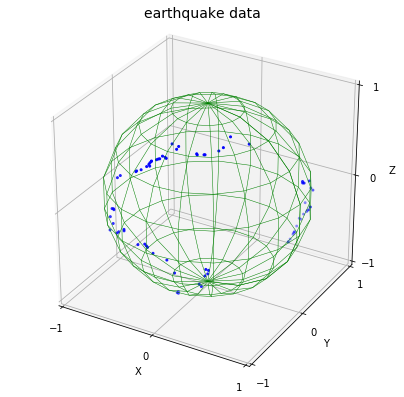

In [58]:
# select latitude and longitude column
THETA= np.array(np.vstack((data['latitude'].values, data['longitude'].values))/360.*m.pi*2)
t1= m.pi/2- THETA[0]
t2= THETA[1] + 5*m.pi/8

x= np.vstack((np.sin(t1)*np.cos(t2), np.sin(t1)*np.sin(t2) ,np.cos(t1)))
x_theta= np.vstack((t1,t2))
data_len= x.shape[1]

print(THETA.shape)
plot_sphere(x,"earthquake data")

#### Experimental Results

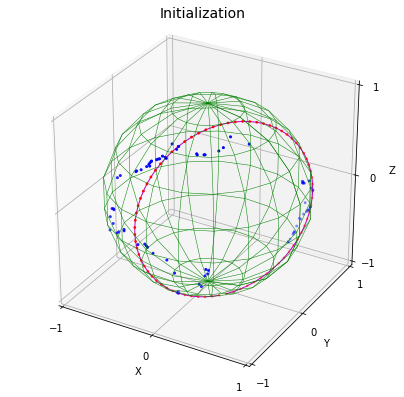

c:\users\lg\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:47: DeprecationWarning: object of type <class 'numpy.float64'> cannot be safely interpreted as an integer.
c:\users\lg\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:44: DeprecationWarning: object of type <class 'numpy.float64'> cannot be safely interpreted as an integer.


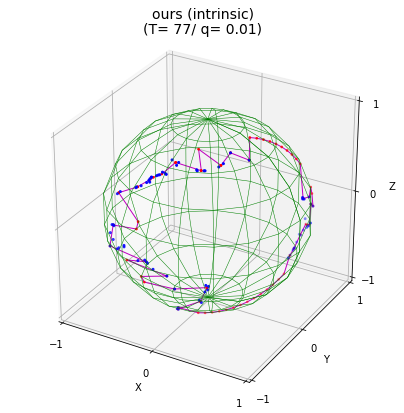

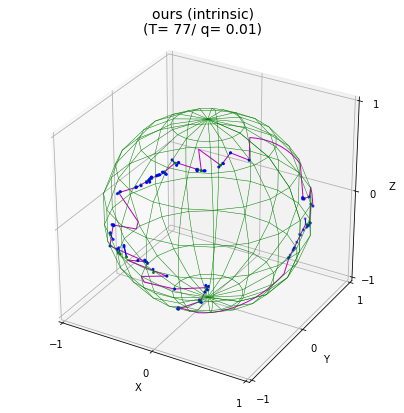


iteration ended at 4
total distance is 0.061
distinct projection : 75 / 77 
training time 22.554 s


In [29]:
n = 77
q = 0.01
thres = 1e-2

# initialization (principal circle)
p_, p3 = pga_circle(x_theta, False)

init_project = np.zeros(shape=[2, n])
init_project[0, :] = p3
init_project[1, :] = np.arange(0, 2*m.pi, 2*m.pi/n)
init_project = inv_rotate(p_, rad2euclid(init_project))

plot_sphere(x, "Initialization", extra= init_project)

# iteration
start_time= time.time()
points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=True,
                                     print_last=True, save_fig=True, data_name="earthquake", thres=0.01)
end_time= time.time()
print("training time %.3f s"%(end_time-start_time))

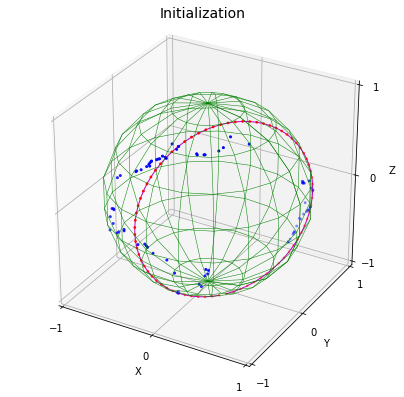

c:\users\lg\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:47: DeprecationWarning: object of type <class 'numpy.float64'> cannot be safely interpreted as an integer.
c:\users\lg\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:44: DeprecationWarning: object of type <class 'numpy.float64'> cannot be safely interpreted as an integer.


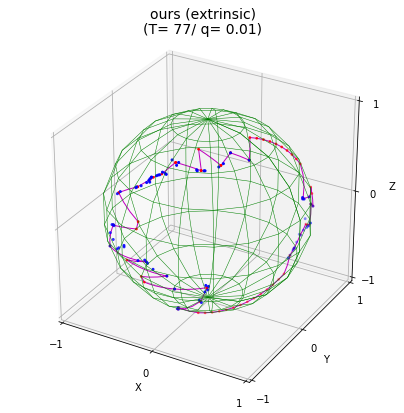

c:\users\lg\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:129: DeprecationWarning: object of type <class 'numpy.float64'> cannot be safely interpreted as an integer.
c:\users\lg\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:126: DeprecationWarning: object of type <class 'numpy.float64'> cannot be safely interpreted as an integer.


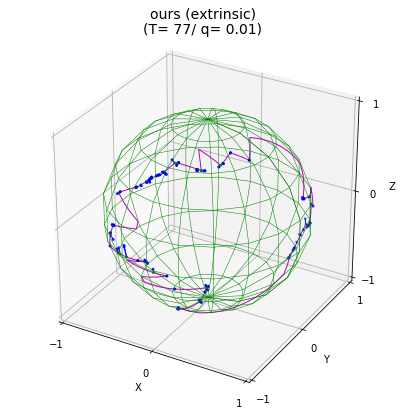


iteration ended at 4
total distance is 0.061
distinct projection : 75 / 77 
training time 33.523 s


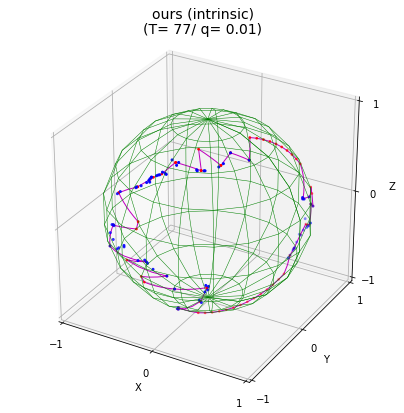

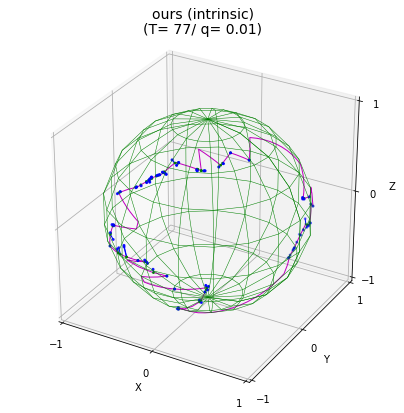


iteration ended at 4
total distance is 0.061
distinct projection : 75 / 77 
training time 34.452 s


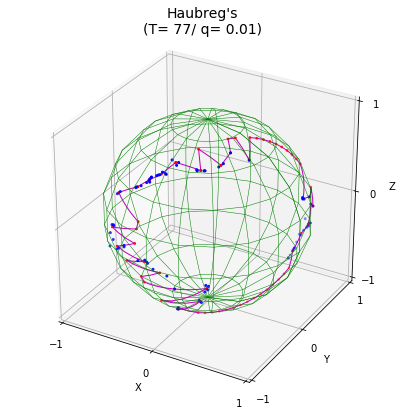

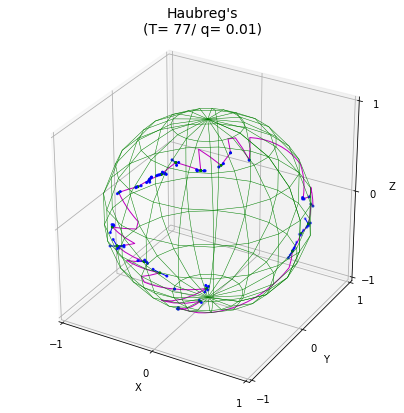


iteration ended at 8
total distance is 0.227
distinct projection : 28 / 77 
training time 9.178 s


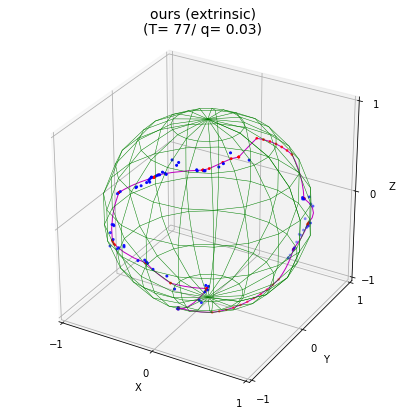

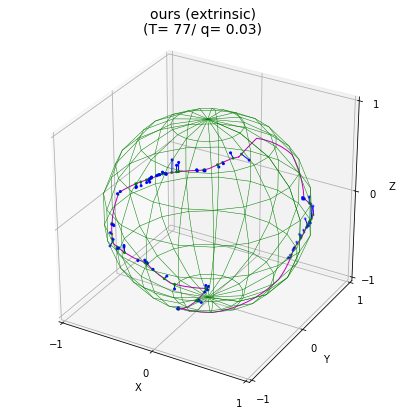


iteration ended at 9
total distance is 0.175
distinct projection : 77 / 77 
training time 61.820 s


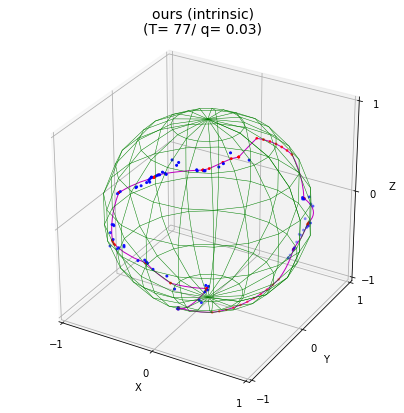

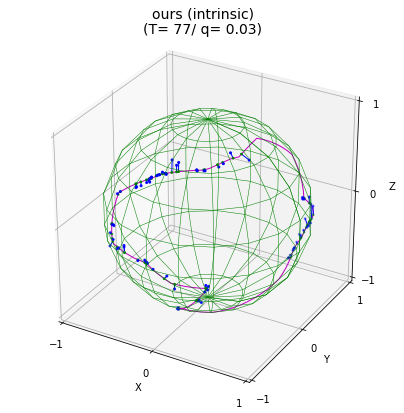


iteration ended at 9
total distance is 0.175
distinct projection : 77 / 77 
training time 62.047 s


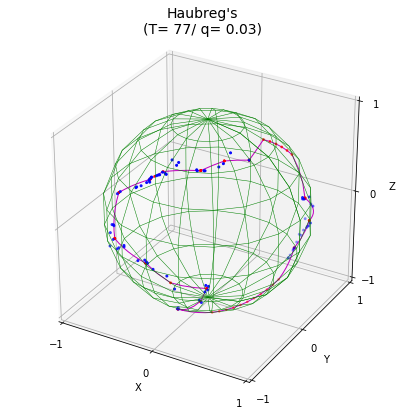

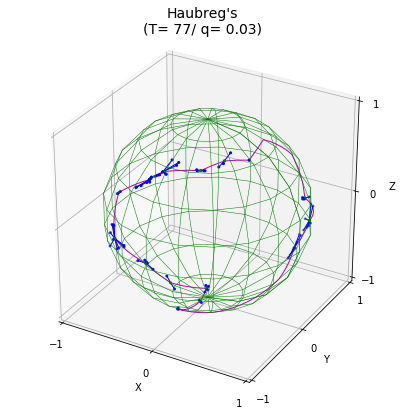


iteration ended at 9
total distance is 0.688
distinct projection : 21 / 77 
training time 8.856 s


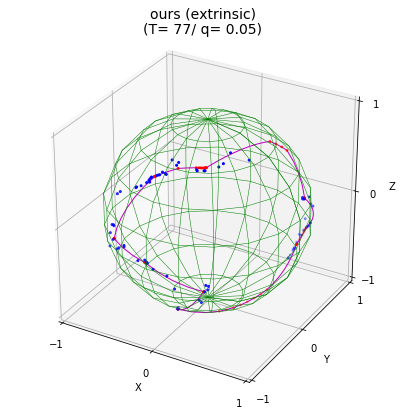

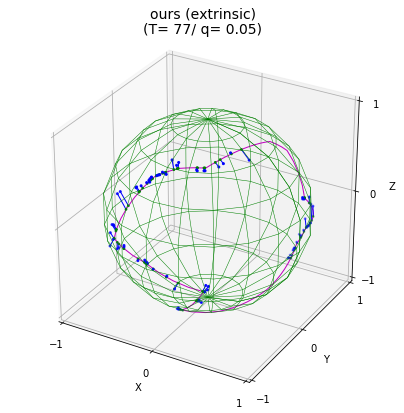


iteration ended at 9
total distance is 0.359
distinct projection : 74 / 77 
training time 59.188 s


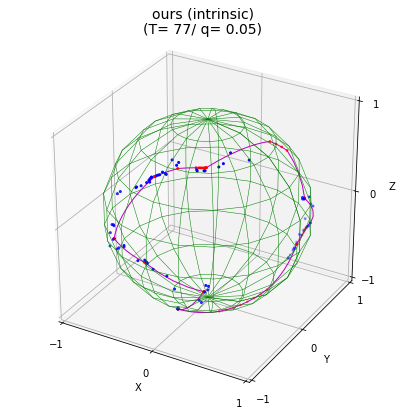

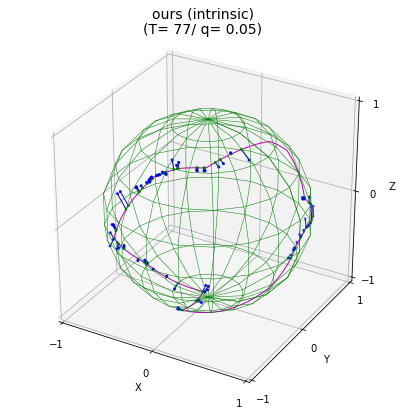


iteration ended at 9
total distance is 0.359
distinct projection : 73 / 77 
training time 61.726 s


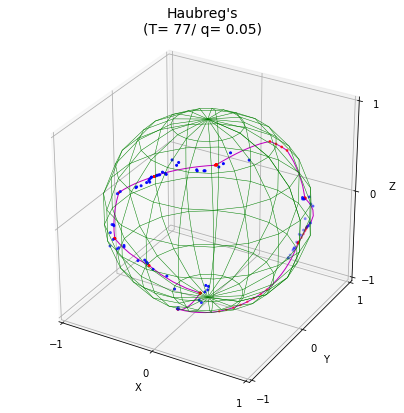

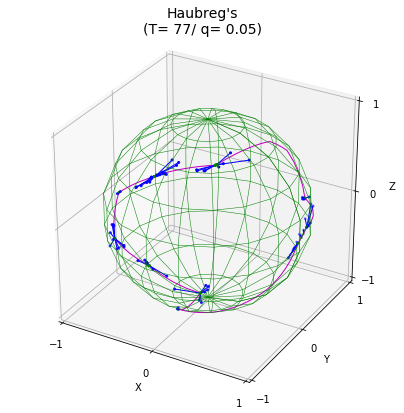


iteration ended at 9
total distance is 1.313
distinct projection : 15 / 77 
training time 9.547 s


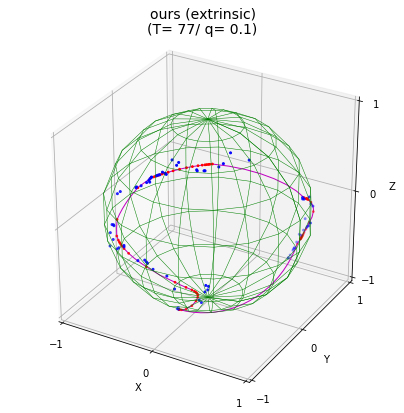

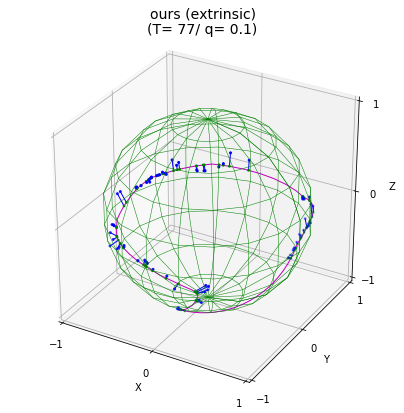


iteration ended at 2
total distance is 0.463
distinct projection : 76 / 77 
training time 21.615 s


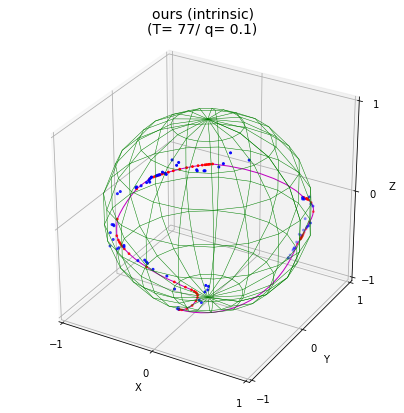

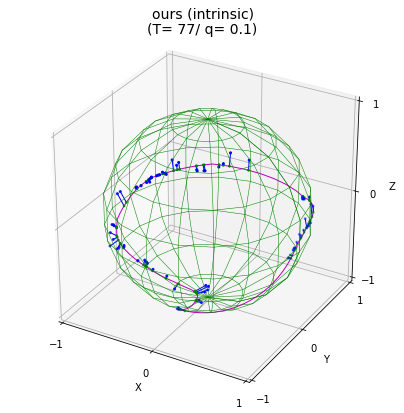


iteration ended at 2
total distance is 0.467
distinct projection : 76 / 77 
training time 23.263 s


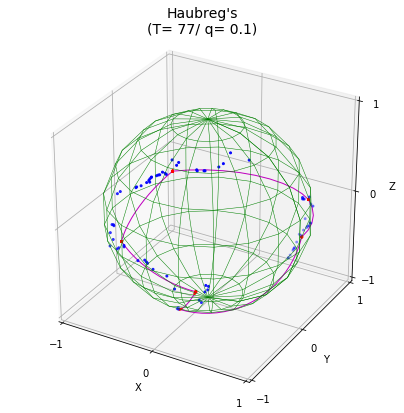

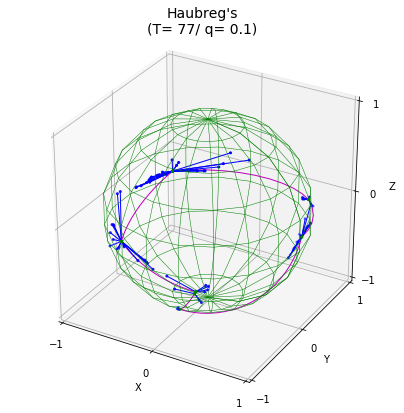


iteration ended at 9
total distance is 4.920
distinct projection : 9 / 77 
training time 9.567 s


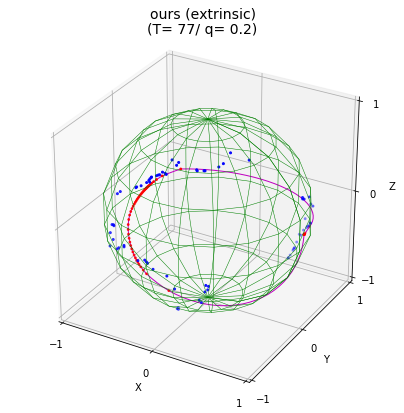

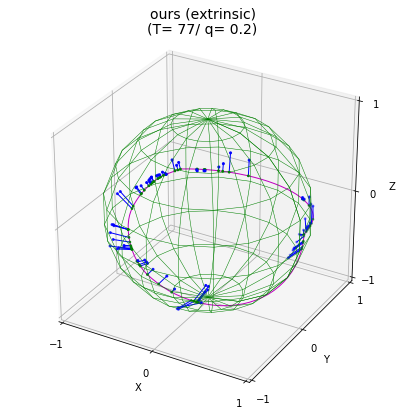


iteration ended at 4
total distance is 2.662
distinct projection : 74 / 77 
training time 32.521 s


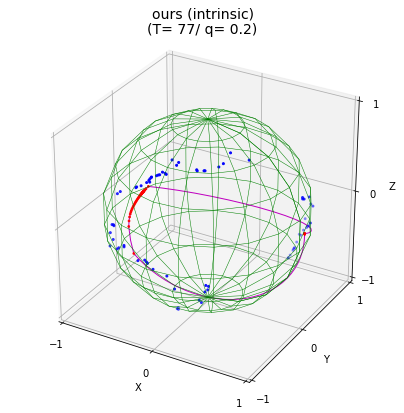

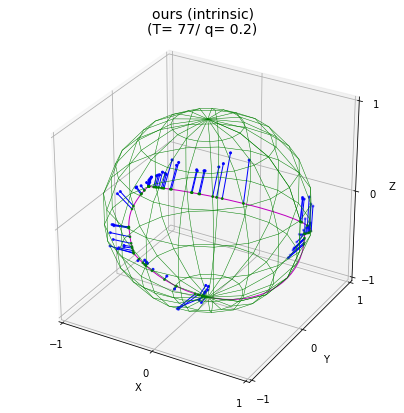


iteration ended at 9
total distance is 4.391
distinct projection : 72 / 77 
training time 56.612 s


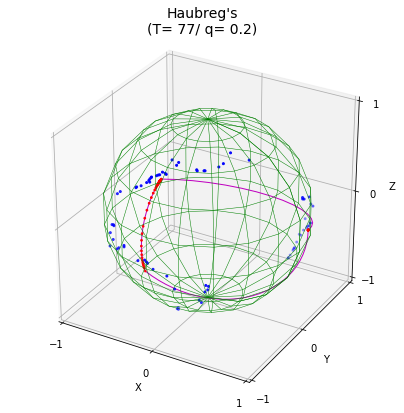

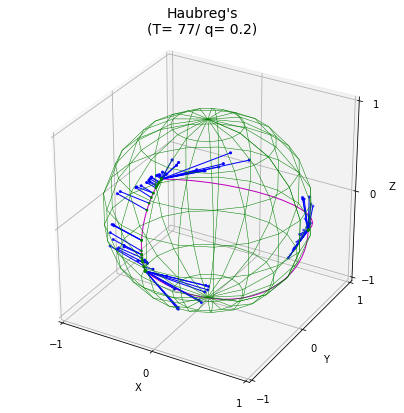


iteration ended at 9
total distance is 12.067
distinct projection : 22 / 77 
training time 8.789 s


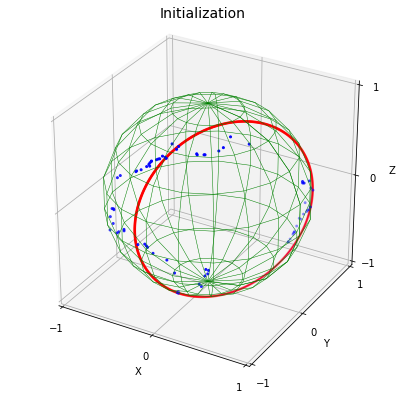

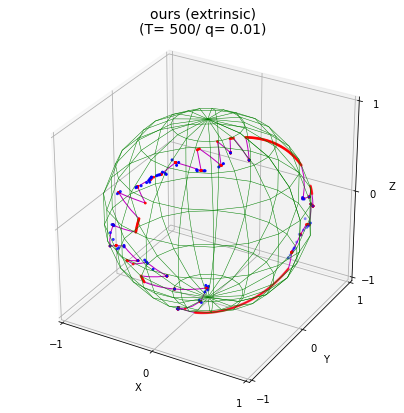

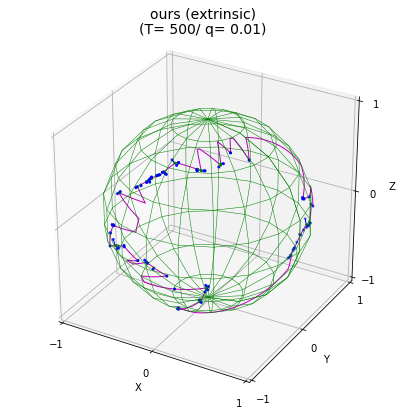


iteration ended at 9
total distance is 0.036
distinct projection : 75 / 77 
training time 377.168 s


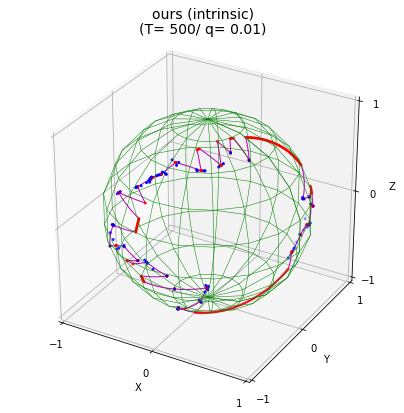

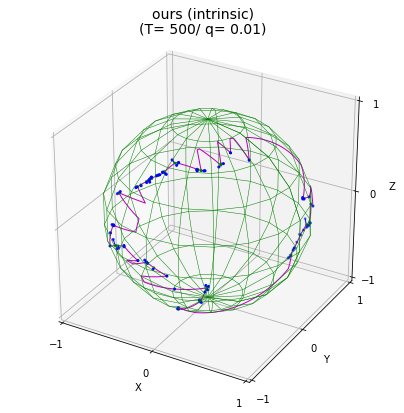


iteration ended at 9
total distance is 0.036
distinct projection : 75 / 77 
training time 399.673 s


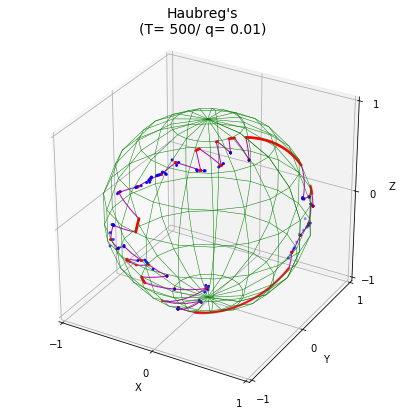

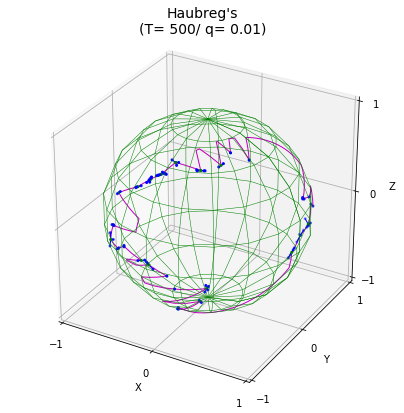


iteration ended at 9
total distance is 0.127
distinct projection : 35 / 77 
training time 58.415 s


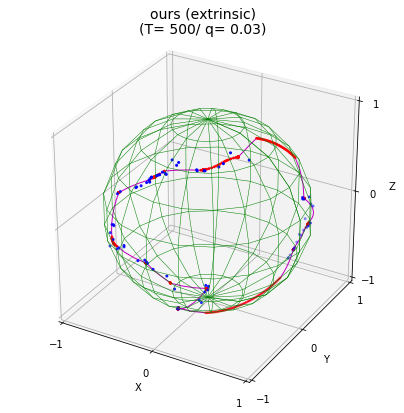

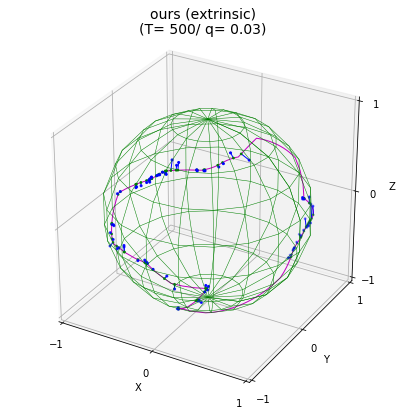


iteration ended at 9
total distance is 0.159
distinct projection : 76 / 77 
training time 400.657 s


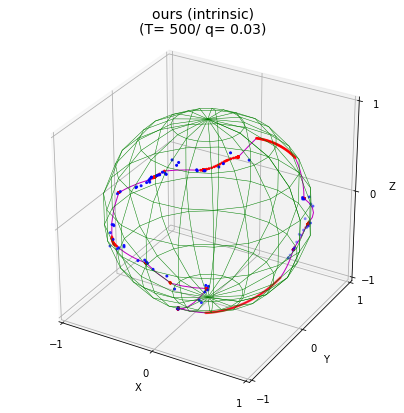

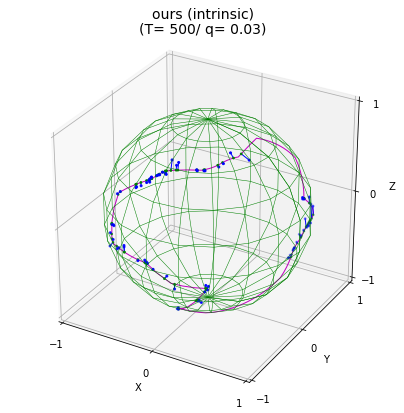


iteration ended at 9
total distance is 0.159
distinct projection : 76 / 77 
training time 367.169 s


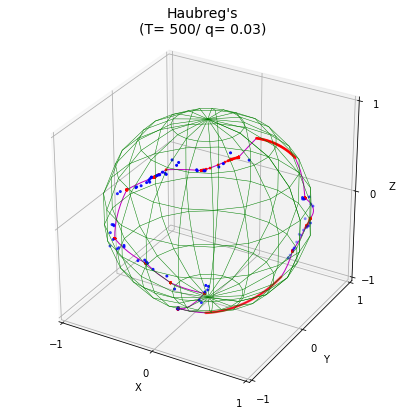

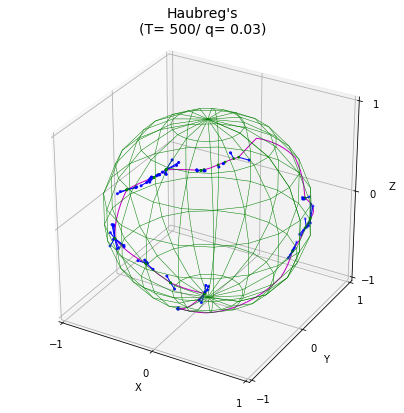


iteration ended at 9
total distance is 0.619
distinct projection : 32 / 77 
training time 51.439 s


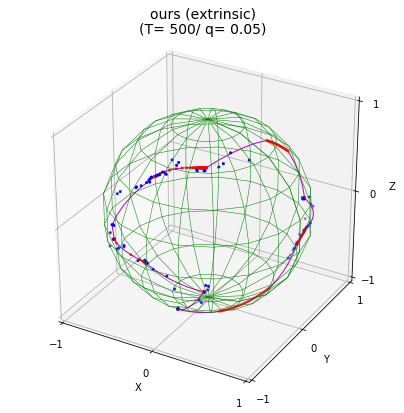

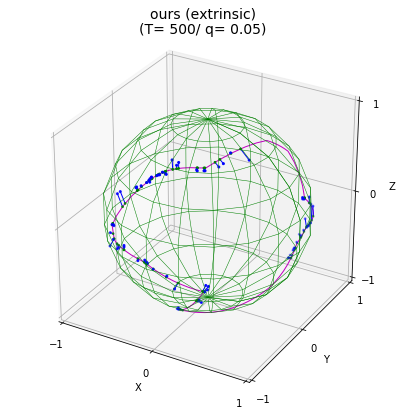


iteration ended at 9
total distance is 0.298
distinct projection : 75 / 77 
training time 352.977 s


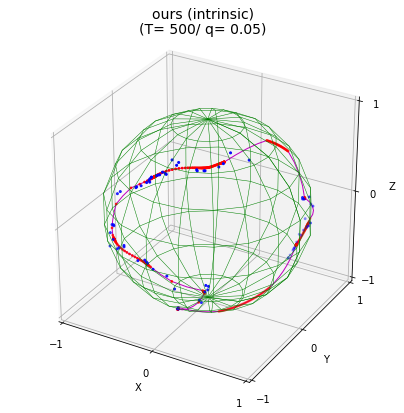

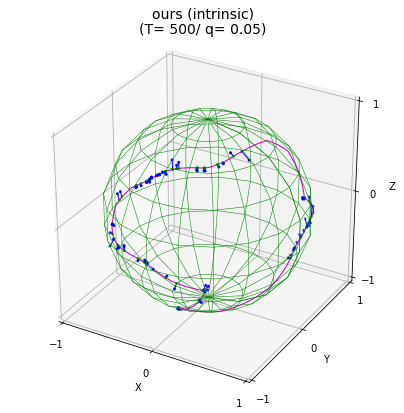


iteration ended at 4
total distance is 0.200
distinct projection : 75 / 77 
training time 196.624 s


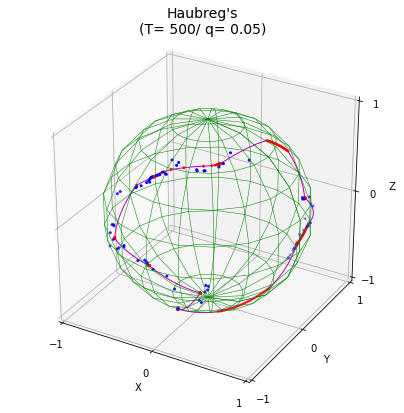

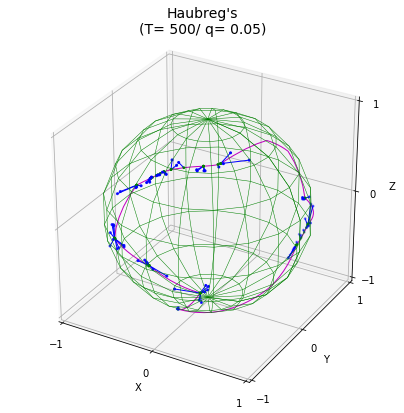


iteration ended at 9
total distance is 0.967
distinct projection : 28 / 77 
training time 46.218 s


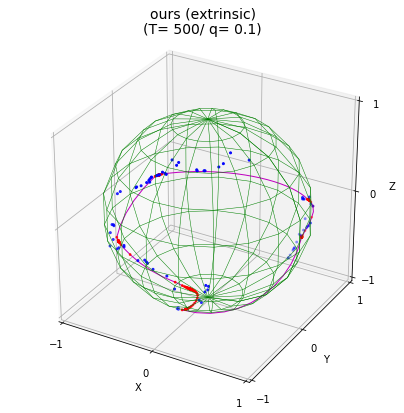

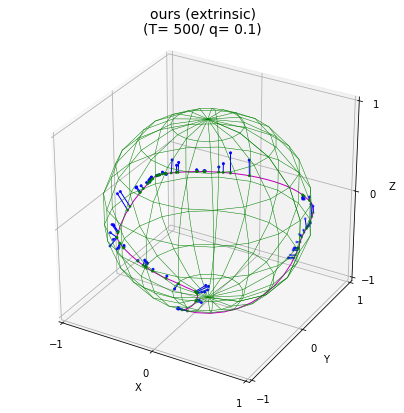


iteration ended at 9
total distance is 0.715
distinct projection : 75 / 77 
training time 353.985 s


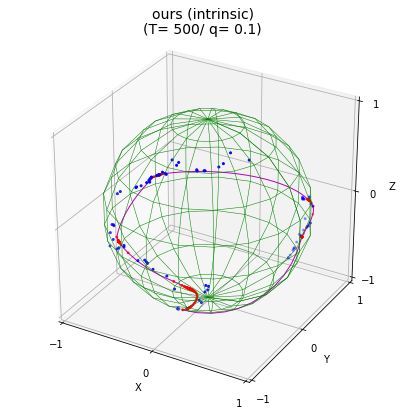

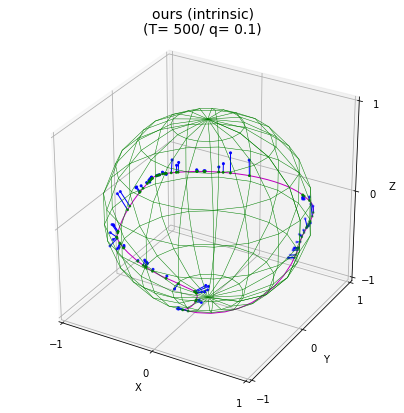


iteration ended at 9
total distance is 0.732
distinct projection : 74 / 77 
training time 356.579 s


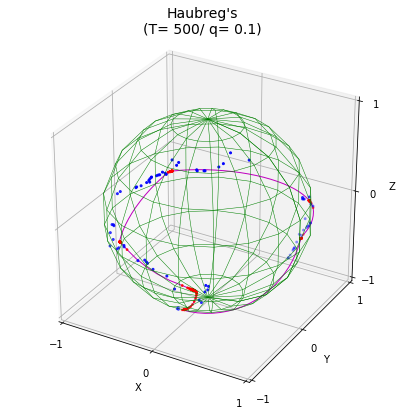

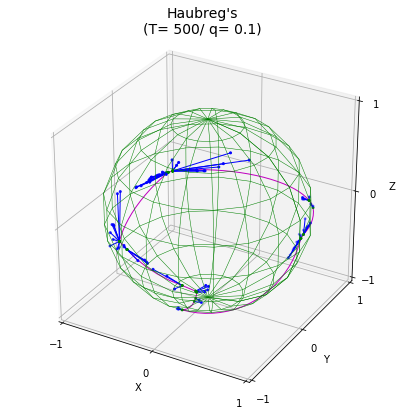


iteration ended at 9
total distance is 3.903
distinct projection : 18 / 77 
training time 45.778 s


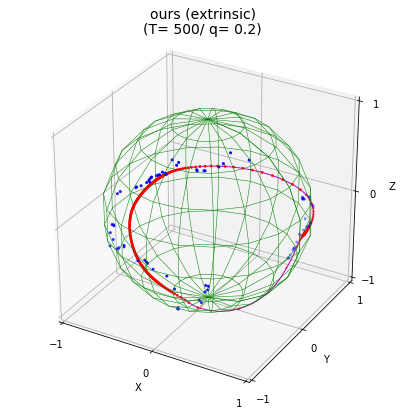

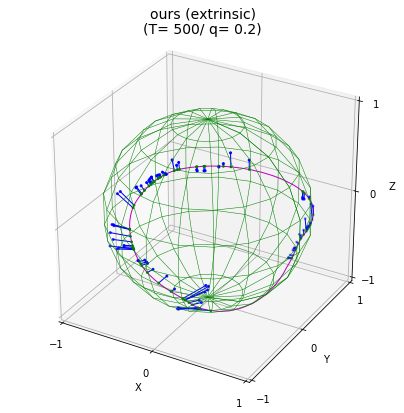


iteration ended at 2
total distance is 2.193
distinct projection : 75 / 77 
training time 125.356 s


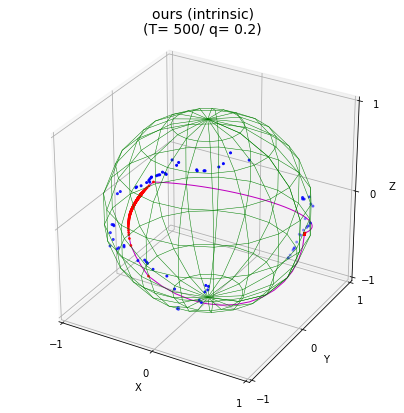

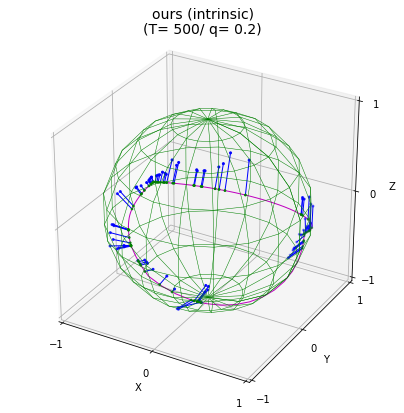


iteration ended at 9
total distance is 3.460
distinct projection : 72 / 77 
training time 348.264 s


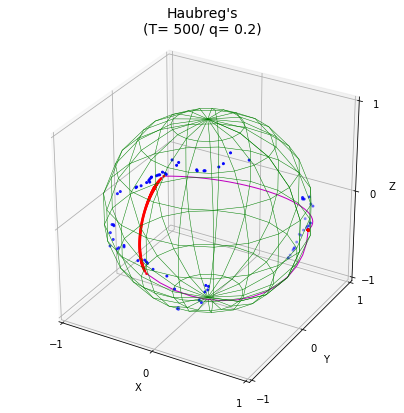

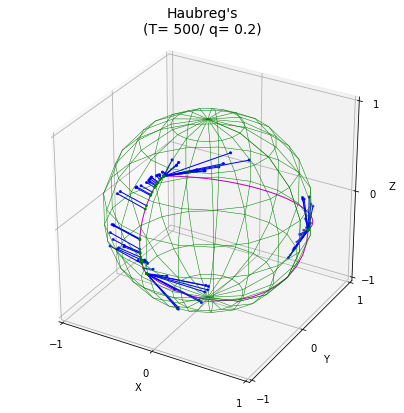


iteration ended at 9
total distance is 11.300
distinct projection : 30 / 77 
training time 48.034 s


In [59]:
n_points= [77, 500]; neighs= [0.01, 0.03, 0.05, 0.1, 0.2]
data_name= 'earthquake'

# initialization (principal circle)
p_, p3 = pga_circle(x_theta, False)

# initial projection
for n in n_points:
    init_project = np.zeros(shape=[2, n])
    init_project[0, :] = p3
    init_project[1, :] = np.arange(0, 2*m.pi, 2*m.pi/n)
    init_project = inv_rotate(p_, rad2euclid(init_project))

    plot_sphere(x, "Initialization", extra= init_project)    
    
    for q in neighs:
        # iteration
        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=False,
                                             print_last=True, save_fig=True, data_name=data_name)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=True,
                                             print_last=True, save_fig=True, data_name=data_name)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=False, intrinsic=False,
                                             print_last=True, save_fig=True, data_name=data_name)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

#### Robust Principal Curve

(2, 200)


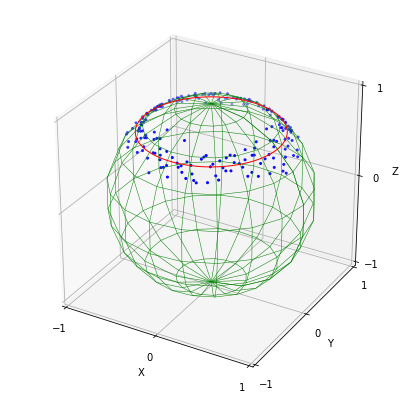

In [147]:
n_data = 200

# data generation
x = np.linspace(0,np.pi*2,n_data) + np.pi 
y = np.array([np.pi/4]*n_data)
data_sim2 = np.vstack((x, y))
print(data_sim2.shape)

noise1 = np.random.normal(0, 0.1, n_data)
noise2 = np.random.normal(0, 1, n_data)

t1= data_sim2[1]
t2= data_sim2[0]
x_true= np.vstack((np.sin(t1)*np.cos(t2), np.sin(t1)*np.sin(t2) ,np.cos(t1)))

t1= data_sim2[1,np.arange(n_data)] + noise1
t2= data_sim2[0,np.arange(n_data)] #+ noise2
x= np.vstack((np.sin(t1)*np.cos(t2), np.sin(t1)*np.sin(t2) ,np.cos(t1)))

x_theta= np.vstack((t1,t2))
data_len= x.shape[1]

plot_sphere(x, "", extra =x_true, line=True)

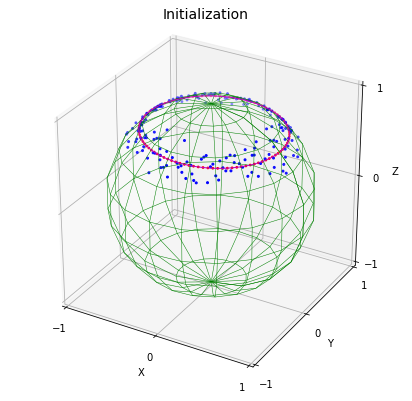

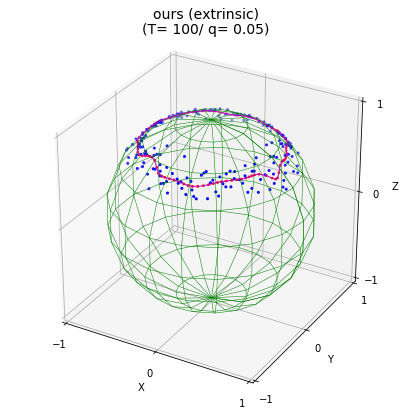

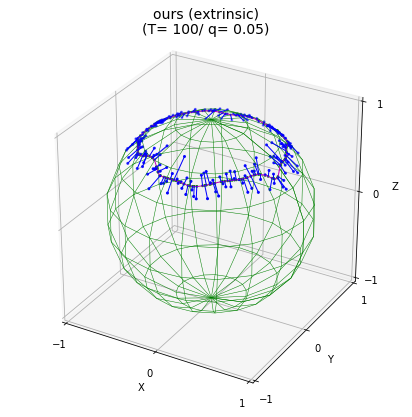


iteration ended at 3
total distance is 1.573
distinct projection : 198 / 200 
training time 24.766 s


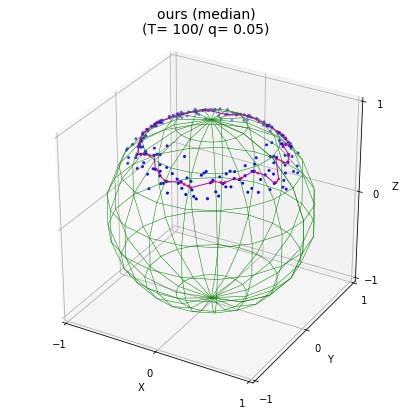

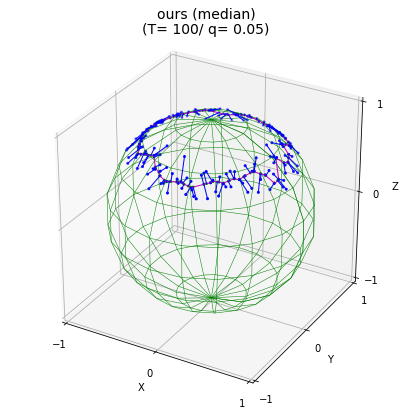


iteration ended at 3
total distance is 1.413
distinct projection : 184 / 200 
training time 26.595 s


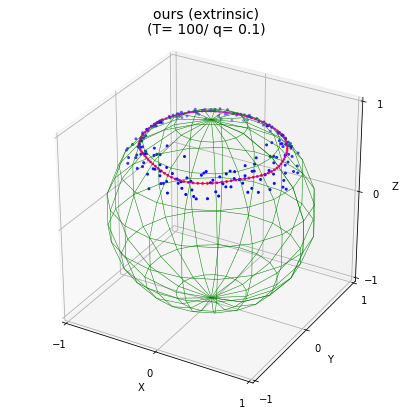

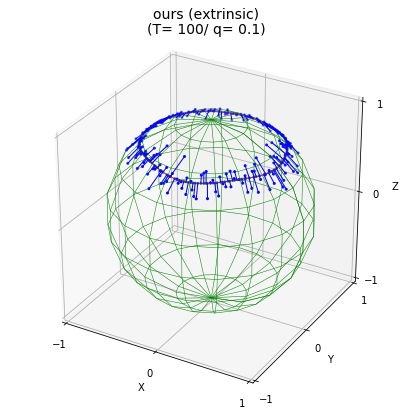


iteration ended at 0
total distance is 1.961
distinct projection : 200 / 200 
training time 10.422 s


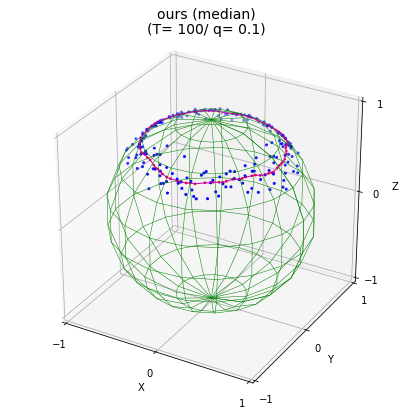

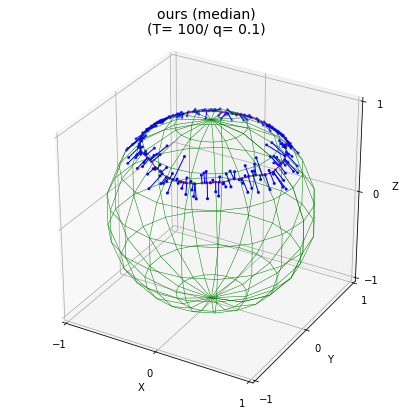


iteration ended at 1
total distance is 1.847
distinct projection : 195 / 200 
training time 15.912 s


In [148]:
n_points = [100]
q_list = [0.05, 0.1]
thres = 1e-2

# initialization (principal circle)
p_, p3 = pga_circle(x_theta, False)

for n in n_points:
    init_project = np.zeros(shape=[2, n])
    init_project[0, :] = p3
    init_project[1, :] = np.arange(0, 2*m.pi, 2*m.pi/n)
    init_project = inv_rotate(p_, rad2euclid(init_project))

    plot_sphere(x, "Initialization", extra= init_project)

    for q in q_list:
        # iteration
        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=False, median=False,
                                             print_last=True, save_fig=True, data_name="earthquake", thres=0.02)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=False, median=True,
                                             print_last=True, save_fig=True, data_name="earthquake", thres=0.02)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

0.58994378627


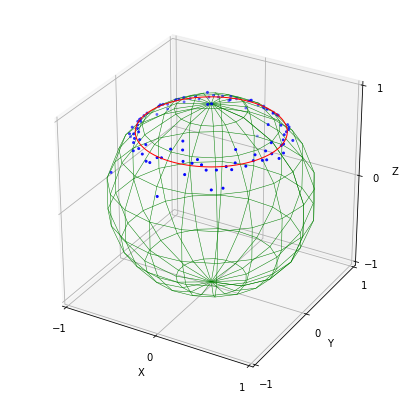

In [151]:
n_data = 100

# data generation
x = np.linspace(0,np.pi*2,n_data) + np.pi 
y = np.array([np.pi/4]*n_data)
data_sim2 = np.vstack((x, y))

noise1 = np.random.standard_cauchy(n_data) * 0.05
print(np.std(noise1))
noise2 = np.random.normal(0, 1, n_data)

t1= data_sim2[1]
t2= data_sim2[0]
x_true= np.vstack((np.sin(t1)*np.cos(t2), np.sin(t1)*np.sin(t2) ,np.cos(t1)))

t1= data_sim2[1,np.arange(n_data)] + noise1
t2= data_sim2[0,np.arange(n_data)] #+ noise2
x= np.vstack((np.sin(t1)*np.cos(t2), np.sin(t1)*np.sin(t2) ,np.cos(t1)))

x_theta= np.vstack((t1,t2))
data_len= x.shape[1]

plot_sphere(x, "", extra =x_true, line=True)

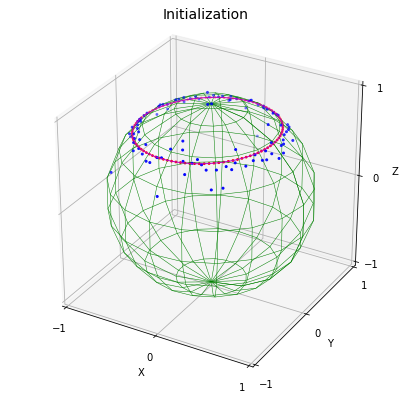

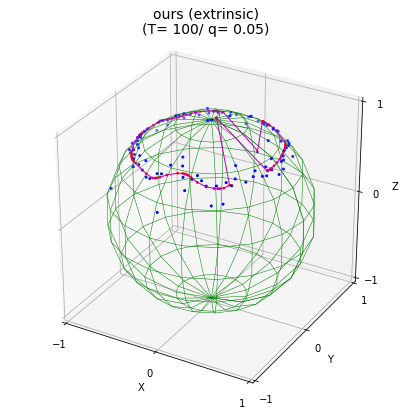

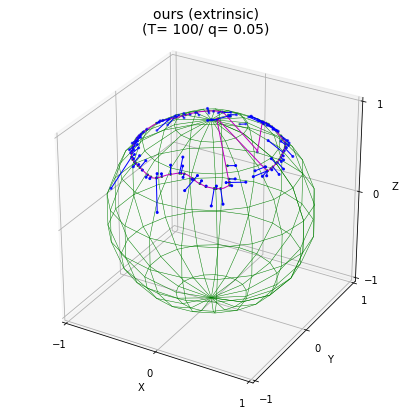


iteration ended at 6
total distance is 1.296
distinct projection : 97 / 100 
training time 19.912 s


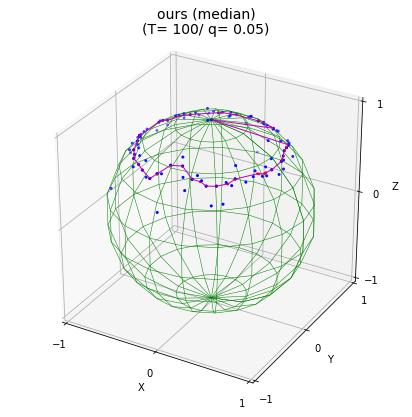

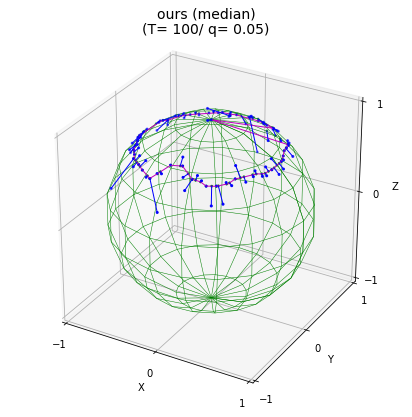


iteration ended at 6
total distance is 1.491
distinct projection : 96 / 100 
training time 25.821 s


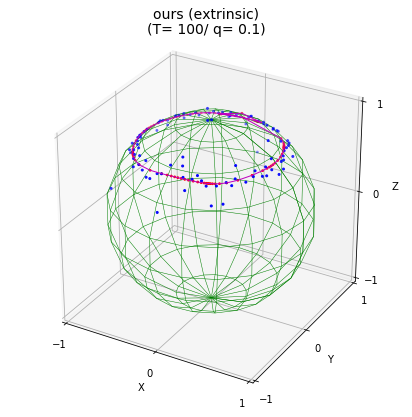

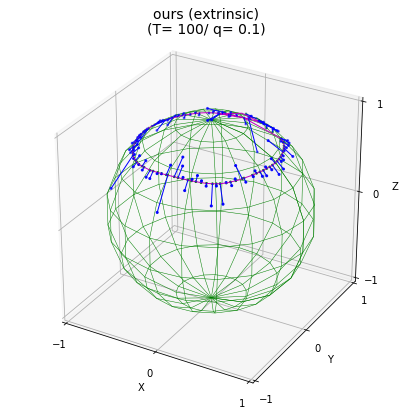


iteration ended at 9
total distance is 1.741
distinct projection : 98 / 100 
training time 26.976 s


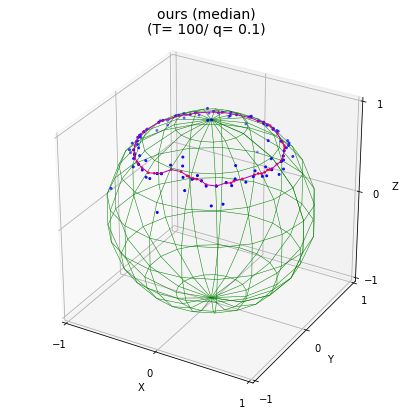

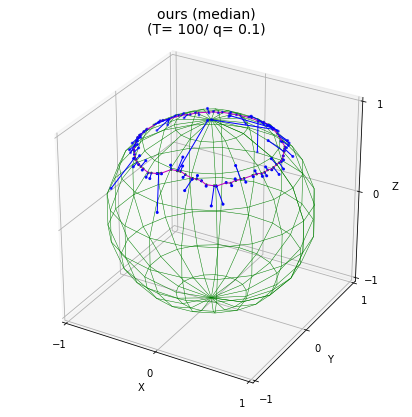


iteration ended at 2
total distance is 2.754
distinct projection : 99 / 100 
training time 11.742 s


In [152]:
n_points = [100]
q_list = [0.05, 0.1]
thres = 1e-2

# initialization (principal circle)
p_, p3 = pga_circle(x_theta, False)

for n in n_points:
    init_project = np.zeros(shape=[2, n])
    init_project[0, :] = p3
    init_project[1, :] = np.arange(0, 2*m.pi, 2*m.pi/n)
    init_project = inv_rotate(p_, rad2euclid(init_project))

    plot_sphere(x, "Initialization", extra= init_project)

    for q in q_list:
        # iteration
        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=False, median=False,
                                             print_last=True, save_fig=True, data_name="earthquake", thres=0.02)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=False, median=True,
                                             print_last=True, save_fig=True, data_name="earthquake", thres=0.02)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

3.46982103822


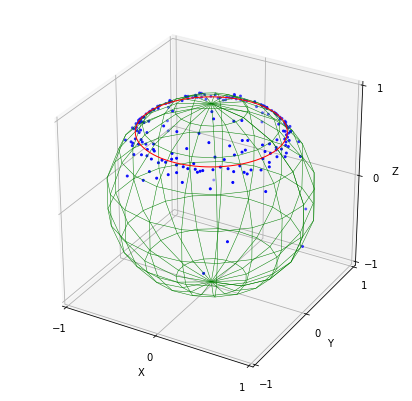

In [149]:
n_data = 200

# data generation
x = np.linspace(0,np.pi*2,n_data) + np.pi 
y = np.array([np.pi/4]*n_data)
data_sim2 = np.vstack((x, y))

noise1 = np.random.standard_cauchy(n_data) * 0.05
print(np.std(noise1))
noise2 = np.random.normal(0, 1, n_data)

t1= data_sim2[1]
t2= data_sim2[0]
x_true= np.vstack((np.sin(t1)*np.cos(t2), np.sin(t1)*np.sin(t2) ,np.cos(t1)))

t1= data_sim2[1,np.arange(n_data)] + noise1
t2= data_sim2[0,np.arange(n_data)] #+ noise2
x= np.vstack((np.sin(t1)*np.cos(t2), np.sin(t1)*np.sin(t2) ,np.cos(t1)))

x_theta= np.vstack((t1,t2))
data_len= x.shape[1]

plot_sphere(x, "", extra =x_true, line=True)

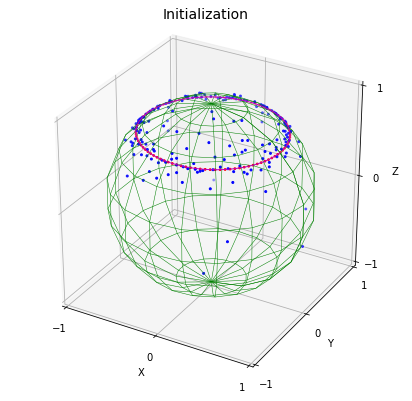

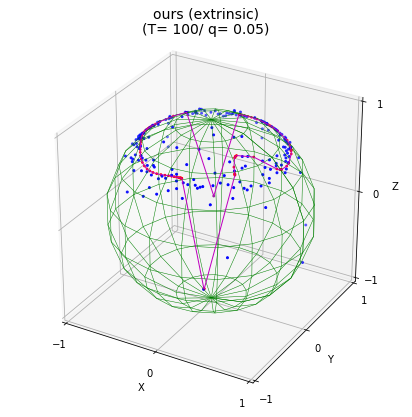

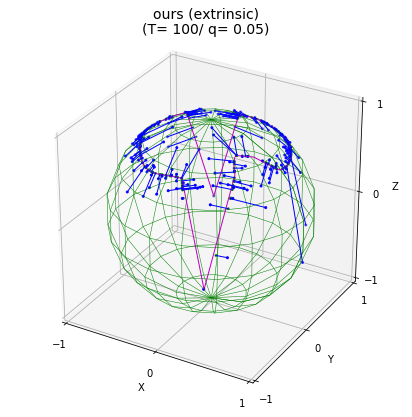


iteration ended at 9
total distance is 5.805
distinct projection : 198 / 200 
training time 54.172 s


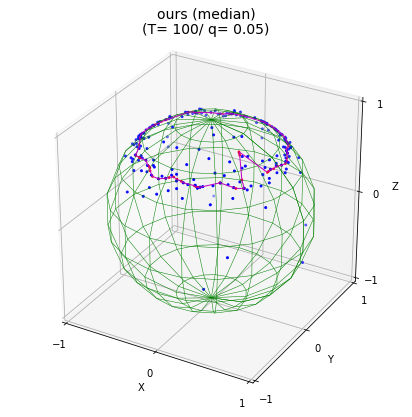

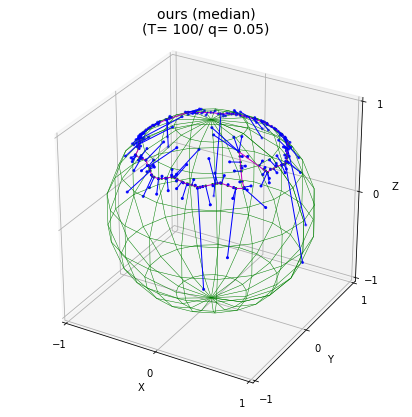


iteration ended at 3
total distance is 8.328
distinct projection : 186 / 200 
training time 26.561 s


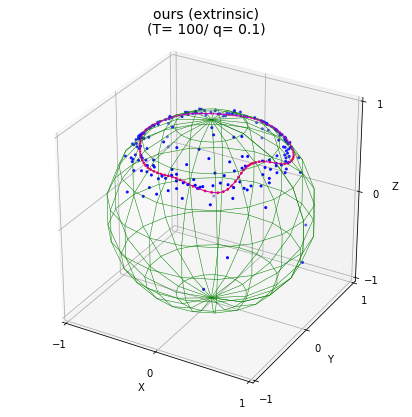

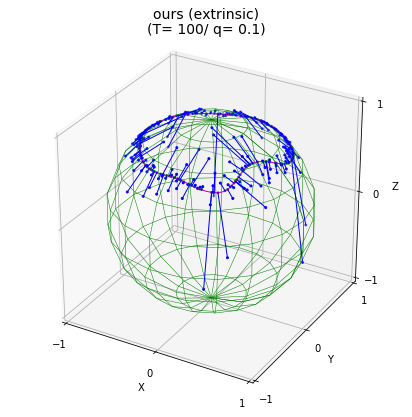


iteration ended at 3
total distance is 9.073
distinct projection : 198 / 200 
training time 25.042 s


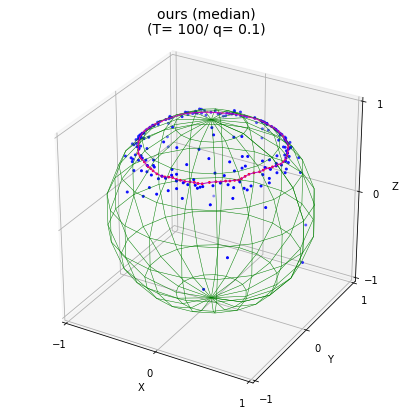

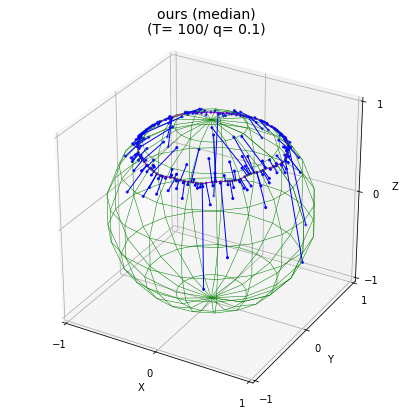


iteration ended at 0
total distance is 9.738
distinct projection : 191 / 200 
training time 10.764 s


In [150]:
n_points = [100]
q_list = [0.05, 0.1]
thres = 1e-2

# initialization (principal circle)
p_, p3 = pga_circle(x_theta, False)

for n in n_points:
    init_project = np.zeros(shape=[2, n])
    init_project[0, :] = p3
    init_project[1, :] = np.arange(0, 2*m.pi, 2*m.pi/n)
    init_project = inv_rotate(p_, rad2euclid(init_project))

    plot_sphere(x, "Initialization", extra= init_project)

    for q in q_list:
        # iteration
        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=False, median=False,
                                             print_last=True, save_fig=True, data_name="earthquake", thres=0.02)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=False, median=True,
                                             print_last=True, save_fig=True, data_name="earthquake", thres=0.02)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

#### PGA initialization

optimization is ended (iter : 10)
number of points: 77


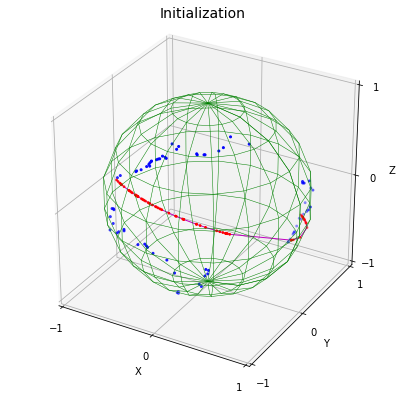

In [56]:
## calculate intrinsic mean
u = intrinsic_mean(x, weights= None, is_print=True)
projected= log_map(u, x)
# perform pca
u_svd, d_svd, v_svd= np.linalg.svd(np.dot(projected, projected.transpose())/x.shape[1])
explained_var= d_svd[0]/np.sum(d_svd)
pca_axis= u_svd[:,0]
pca_data= (np.dot(projected.transpose(), pca_axis).reshape((1,x.shape[1])))*(pca_axis.reshape((-1,1)))
pca_data= pca_data[:,np.argsort(pca_data[1,:])]

# map on sphere
init_project= exp_map(u, pca_data)

plot_sphere(x, "Initialization", extra= init_project)

c:\users\lg\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:47: DeprecationWarning: object of type <class 'numpy.float64'> cannot be safely interpreted as an integer.
c:\users\lg\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:44: DeprecationWarning: object of type <class 'numpy.float64'> cannot be safely interpreted as an integer.


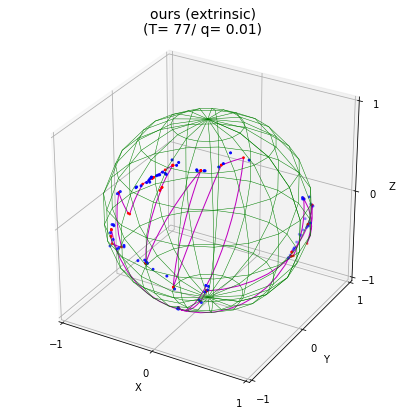

c:\users\lg\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:129: DeprecationWarning: object of type <class 'numpy.float64'> cannot be safely interpreted as an integer.
c:\users\lg\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:126: DeprecationWarning: object of type <class 'numpy.float64'> cannot be safely interpreted as an integer.


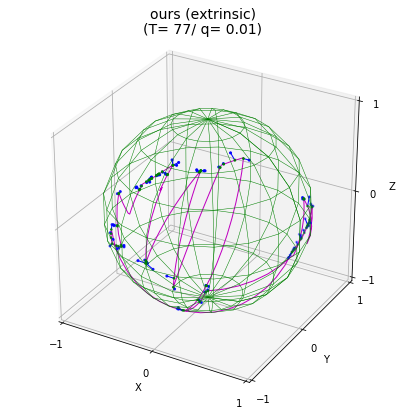


iteration ended at 6
total distance is 0.165
distinct projection : 73 / 77 
training time 40.163 s


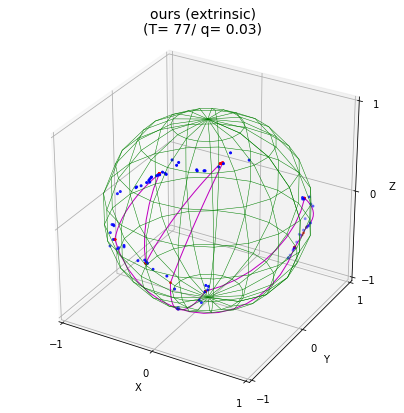

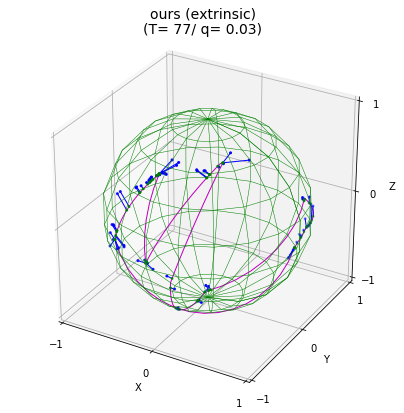


iteration ended at 9
total distance is 0.653
distinct projection : 62 / 77 
training time 54.146 s


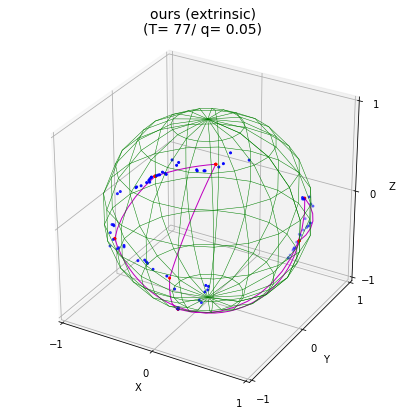

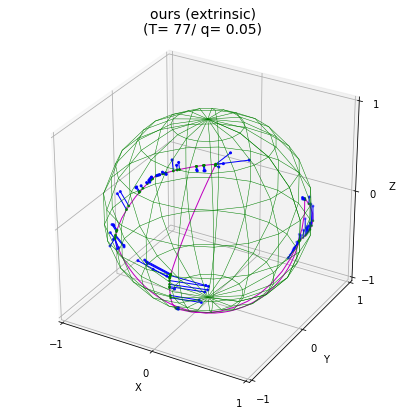


iteration ended at 9
total distance is 1.797
distinct projection : 65 / 77 
training time 54.463 s


In [57]:
neighs= [0.01, 0.03, 0.05]

for q in neighs:
    start_time= time.time()
    points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=False,
                                         print_last=True, save_fig=True, data_name='earthquake')
    end_time= time.time()
    print("training time %.3f s"%(end_time-start_time))

#### cross validation

In [13]:
# cross validation
neigh_ratio = [i*0.02 + 0.10 for i in range(23)]
errors = []
for neigh in neigh_ratio:
    print("\nneigh ratio: ", neigh)
    start_time= time.time()
    points, error= cv_train_principal_curve(x, init_project, iter=50, neigh_ratio=neigh, is_print=False)
    errors.append(error)
    end_time= time.time()
    print("training time %.3f s"%(end_time-start_time))


neigh ratio:  0.1
0
train total distance is 0.140
test total distance is 0.038
1
train total distance is 0.098
test total distance is 0.069
2
train total distance is 0.178
test total distance is 0.021
3
train total distance is 0.131
test total distance is 0.221
4
train total distance is 0.132
test total distance is 0.048
cv error : 0.079
training time 165.285 s

neigh ratio:  0.12000000000000001
0
train total distance is 0.190
test total distance is 0.027
1
train total distance is 0.116
test total distance is 0.076
2
train total distance is 0.092
test total distance is 0.130
3
train total distance is 0.135
test total distance is 0.070
4
train total distance is 0.118
test total distance is 0.098
cv error : 0.080
training time 147.953 s

neigh ratio:  0.14
0
train total distance is 0.171
test total distance is 0.027
1
train total distance is 0.213
test total distance is 0.048
2
train total distance is 0.207
test total distance is 0.121


KeyboardInterrupt: 

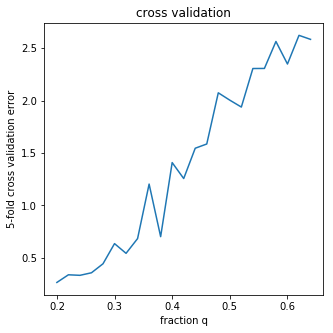

In [26]:
plt.figure(figsize=(5,5))
plt.plot(neigh_ratio, errors)
plt.xlabel("fraction q")
plt.ylabel("5-fold cross validation error")
plt.title("cross validation")
plt.show()

### 2) Simulation Data

### 2-1) Circle 
#### data generation

(2, 100)


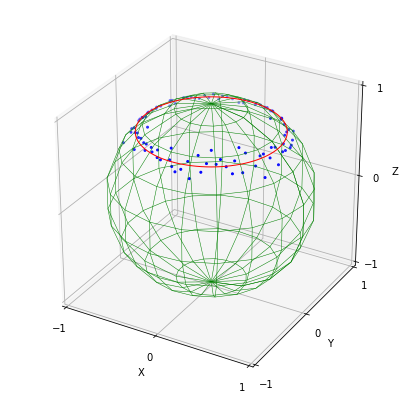

In [58]:
n_data = 100

# data generation
x = np.linspace(0,np.pi*2,n_data) + np.pi 
y = np.array([np.pi/4]*n_data)
data_sim2 = np.vstack((x, y))
print(data_sim2.shape)

noise1 = np.random.normal(0,0.07,n_data)
noise2 = np.random.normal(0,1,n_data)

t1= data_sim2[1]
t2= data_sim2[0]
x_true= np.vstack((np.sin(t1)*np.cos(t2), np.sin(t1)*np.sin(t2) ,np.cos(t1)))

t1= data_sim2[1,np.arange(n_data)] + noise1
t2= data_sim2[0,np.arange(n_data)] #+ noise2
x= np.vstack((np.sin(t1)*np.cos(t2), np.sin(t1)*np.sin(t2) ,np.cos(t1)))

x_theta= np.vstack((t1,t2))
data_len= x.shape[1]

plot_sphere(x, "", extra =x_true, line=True)

#### initialization and fitting

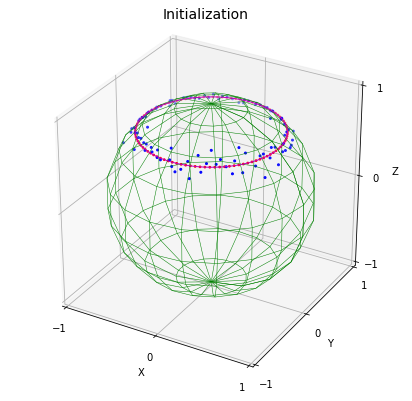

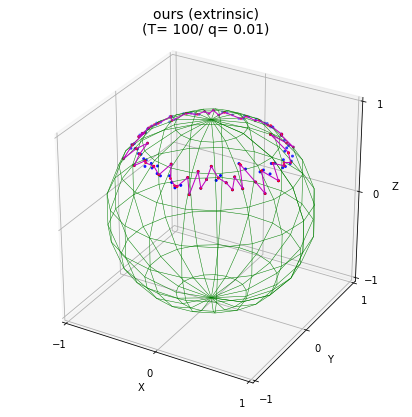

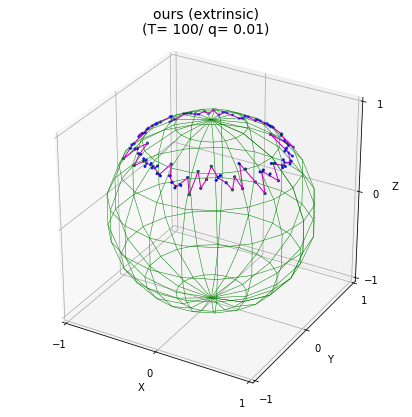


iteration ended at 9
total distance is 0.039
distinct projection : 100 / 100 
training time 27.144 s


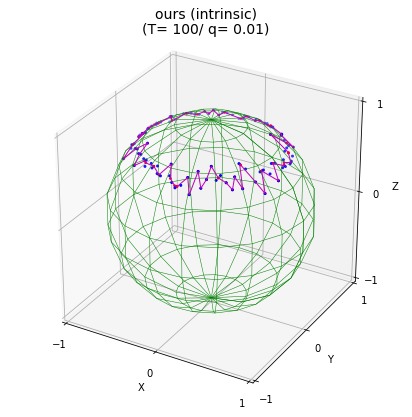

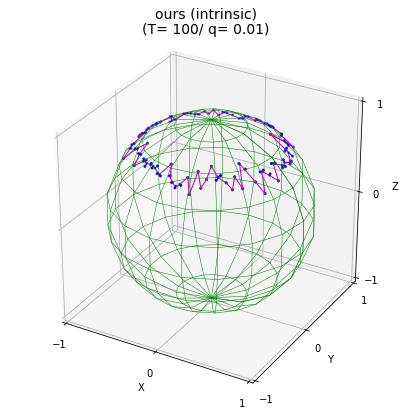


iteration ended at 9
total distance is 0.039
distinct projection : 100 / 100 
training time 27.441 s


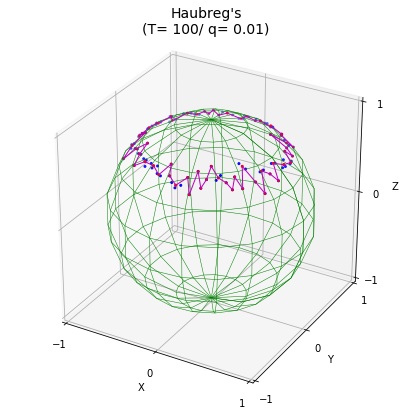

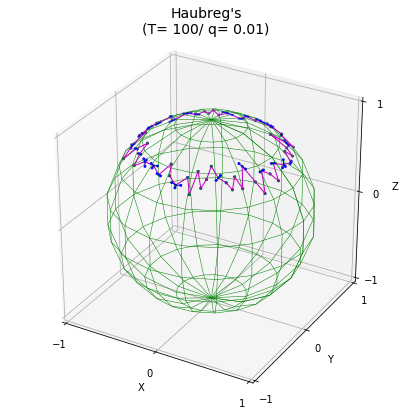


iteration ended at 8
total distance is 0.082
distinct projection : 65 / 100 
training time 6.384 s


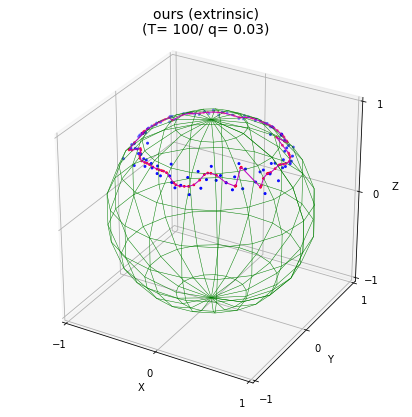

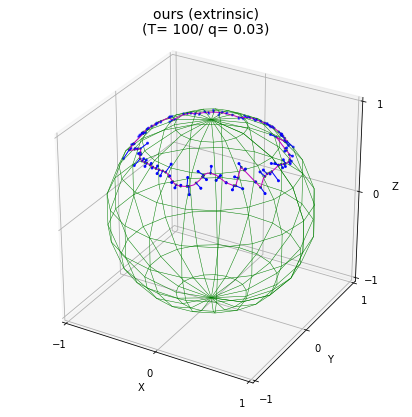


iteration ended at 4
total distance is 0.222
distinct projection : 99 / 100 
training time 15.090 s


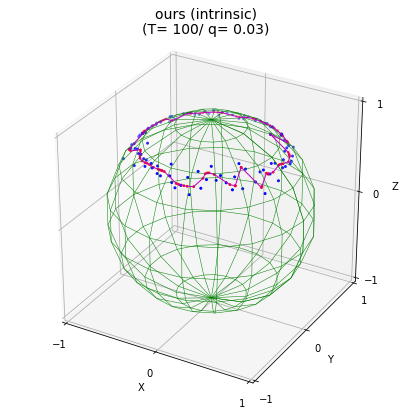

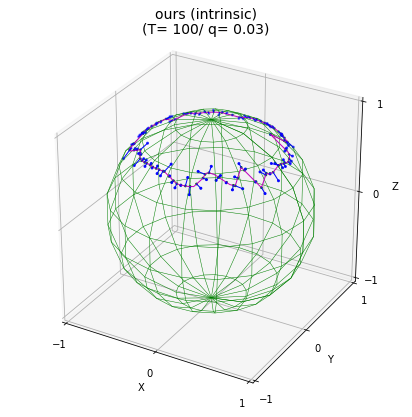


iteration ended at 7
total distance is 0.223
distinct projection : 99 / 100 
training time 22.580 s


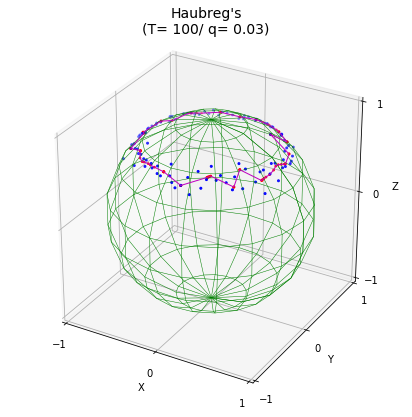

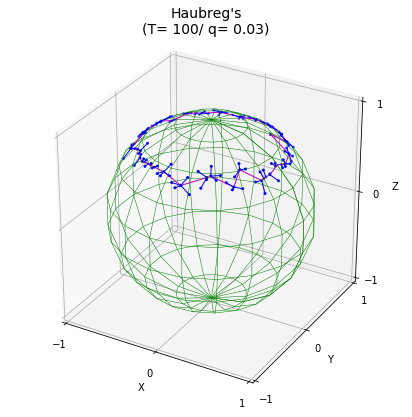


iteration ended at 9
total distance is 0.478
distinct projection : 48 / 100 
training time 6.962 s


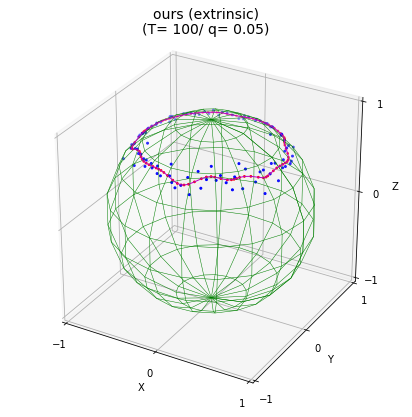

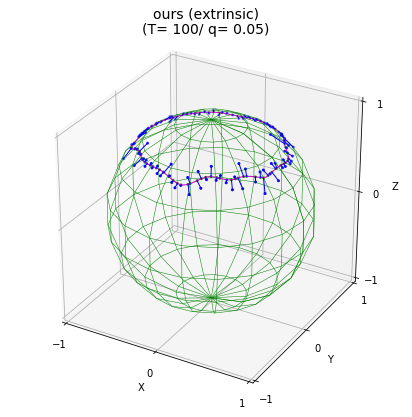


iteration ended at 3
total distance is 0.380
distinct projection : 100 / 100 
training time 12.688 s


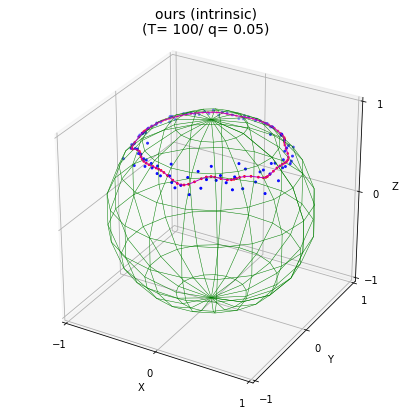

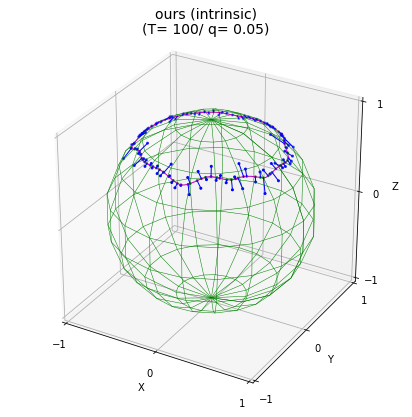


iteration ended at 3
total distance is 0.381
distinct projection : 100 / 100 
training time 12.823 s


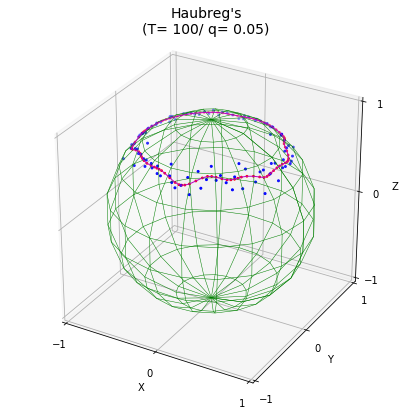

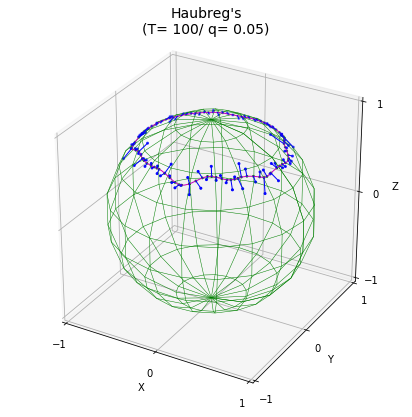


iteration ended at 2
total distance is 0.400
distinct projection : 90 / 100 
training time 2.847 s


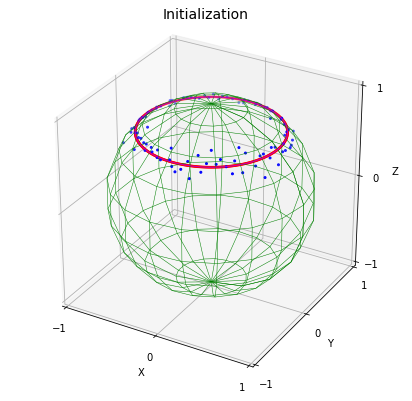

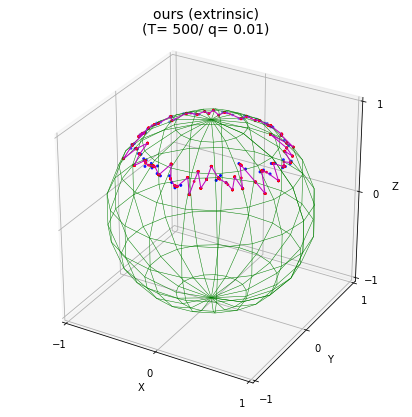

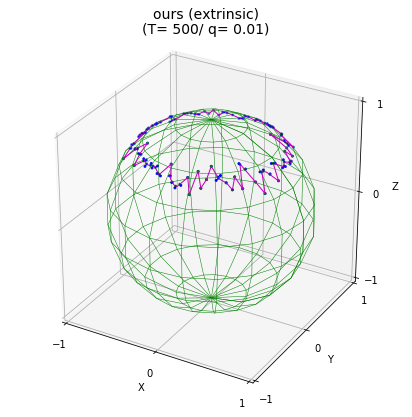


iteration ended at 9
total distance is 0.031
distinct projection : 100 / 100 
training time 135.886 s


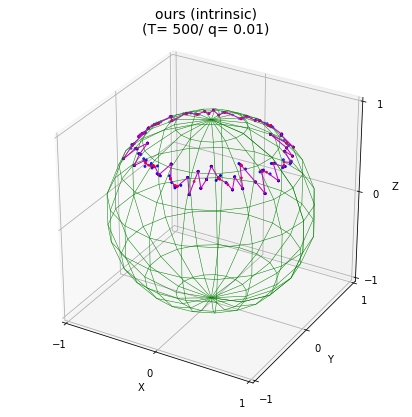

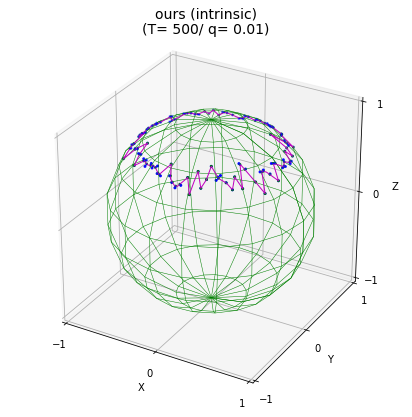


iteration ended at 9
total distance is 0.031
distinct projection : 100 / 100 
training time 135.402 s


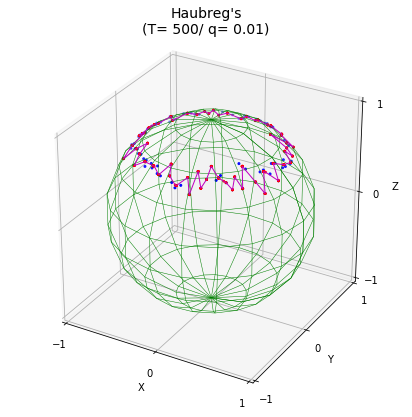

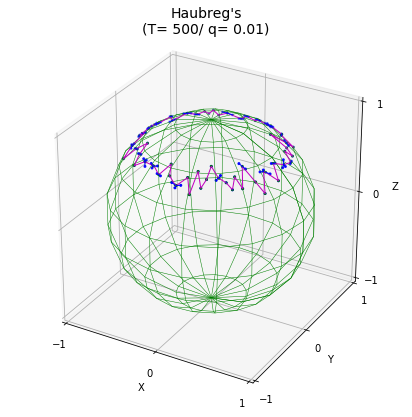


iteration ended at 9
total distance is 0.078
distinct projection : 76 / 100 
training time 32.147 s


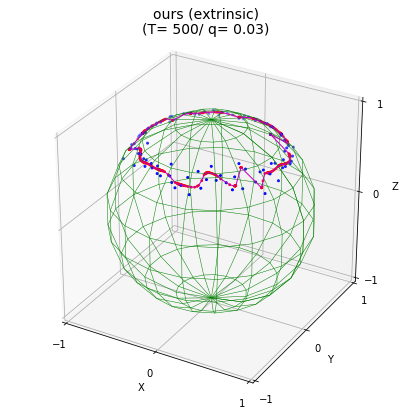

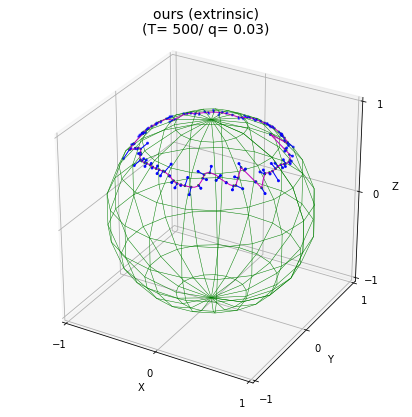


iteration ended at 9
total distance is 0.208
distinct projection : 100 / 100 
training time 135.172 s


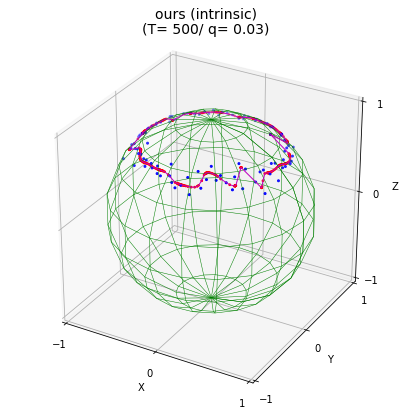

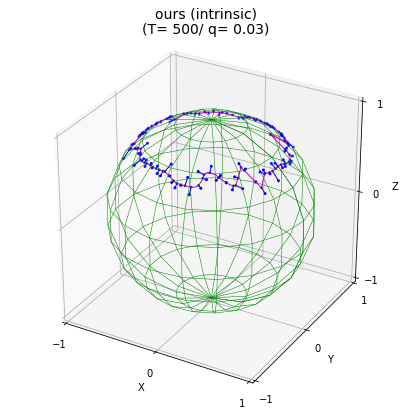


iteration ended at 9
total distance is 0.208
distinct projection : 100 / 100 
training time 136.432 s


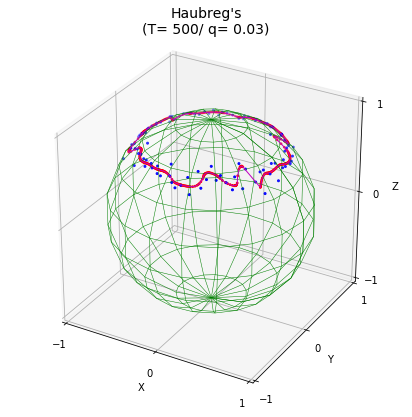

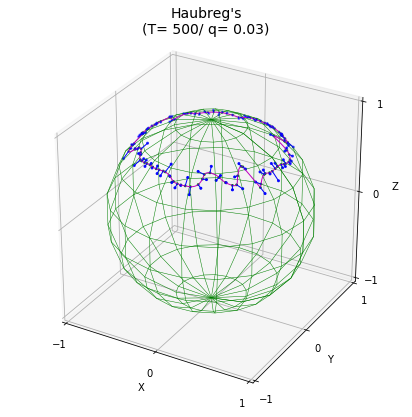


iteration ended at 4
total distance is 0.206
distinct projection : 98 / 100 
training time 17.685 s


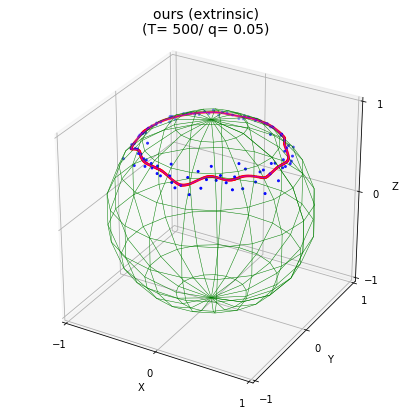

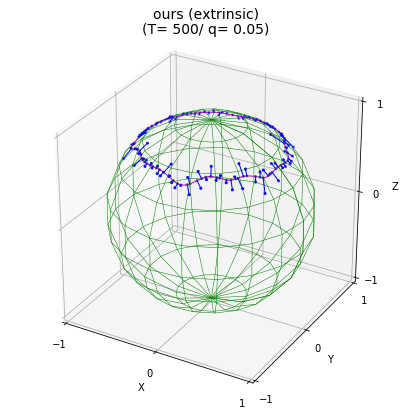


iteration ended at 3
total distance is 0.376
distinct projection : 100 / 100 
training time 61.430 s


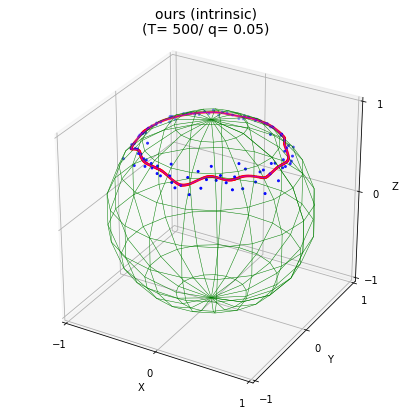

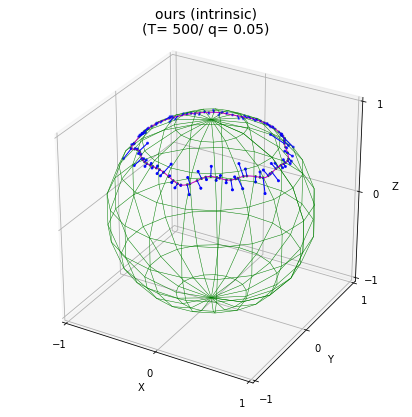


iteration ended at 3
total distance is 0.376
distinct projection : 100 / 100 
training time 62.152 s


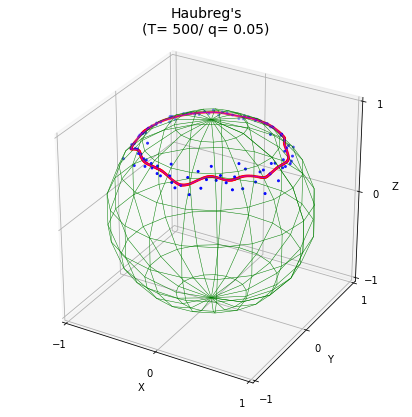

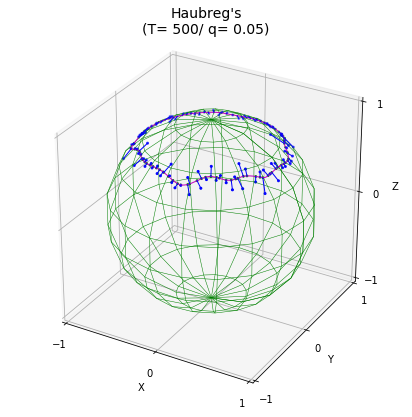


iteration ended at 3
total distance is 0.377
distinct projection : 99 / 100 
training time 14.801 s


In [59]:
n_points= [100, 500]; neighs= [0.01, 0.03, 0.05]
data_name= 'circle'

# initialization (principal circle)
p_, p3 = pga_circle(x_theta, False)

# initial projection
for n in n_points:
    init_project = np.zeros(shape=[2, n])
    init_project[0, :] = p3
    init_project[1, :] = np.arange(0, 2*m.pi, 2*m.pi/n)
    init_project = inv_rotate(p_, rad2euclid(init_project))

    plot_sphere(x, "Initialization", extra= init_project)
    
    for q in neighs:
        # iteration
        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=False,
                                             print_last=True, save_fig=True, data_name=data_name)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=True,
                                             print_last=True, save_fig=True, data_name=data_name)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=False, intrinsic=False,
                                             print_last=True, save_fig=True, data_name=data_name)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

### 2-2) wave form
#### data generation

(2, 1000)


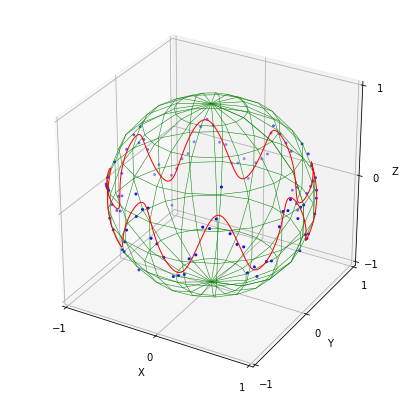

In [60]:
n_data = 100
wind = 10

# data generation
x = np.linspace(0,np.pi*2,n_data * wind)
data_sim1 = np.vstack((x, np.sin(x*8)/3))
print(data_sim1.shape)

noise1 = np.random.normal(0,0.1,n_data)
noise2 = np.random.normal(0,1,n_data)

t1= data_sim1[1] + np.pi/2
t2= data_sim1[0]
x_true= np.vstack((np.sin(t1)*np.cos(t2), np.sin(t1)*np.sin(t2) ,np.cos(t1)))

t1= data_sim1[1,np.arange(n_data)*wind] + np.pi/2 + noise1
t2= data_sim1[0,np.arange(n_data)*wind] #+ noise2
x= np.vstack((np.sin(t1)*np.cos(t2), np.sin(t1)*np.sin(t2) ,np.cos(t1)))

x_theta= np.vstack((t1,t2))
data_len= x.shape[1]

plot_sphere(x,"", extra =x_true, line=True)

#### initialization and fitting

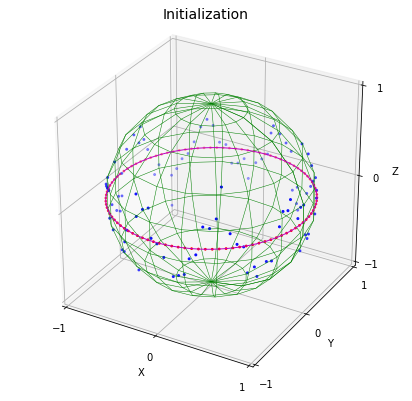

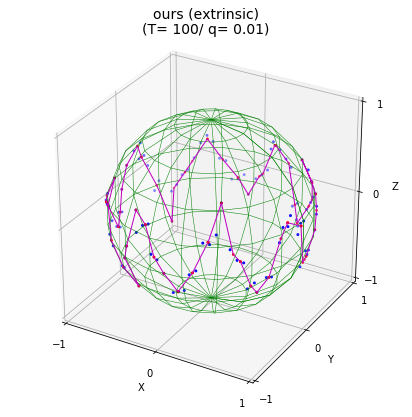

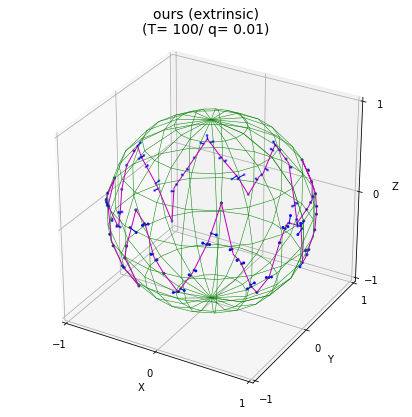


iteration ended at 9
total distance is 0.095
distinct projection : 100 / 100 
training time 27.511 s


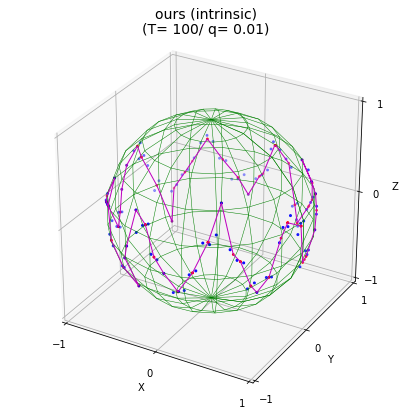

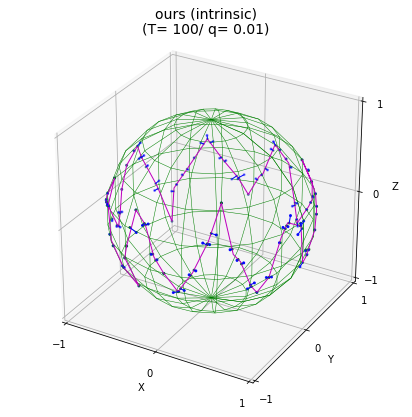


iteration ended at 9
total distance is 0.095
distinct projection : 100 / 100 
training time 27.568 s


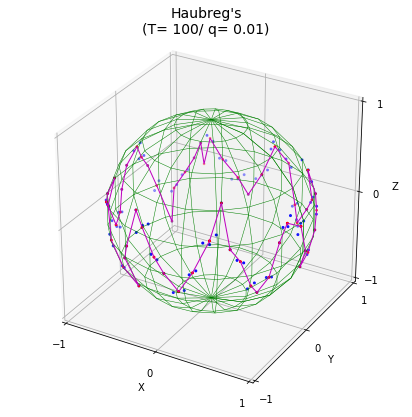

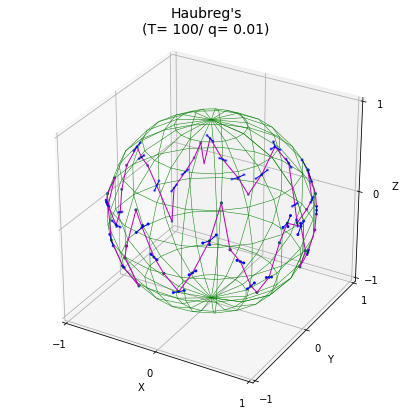


iteration ended at 6
total distance is 0.257
distinct projection : 65 / 100 
training time 5.160 s


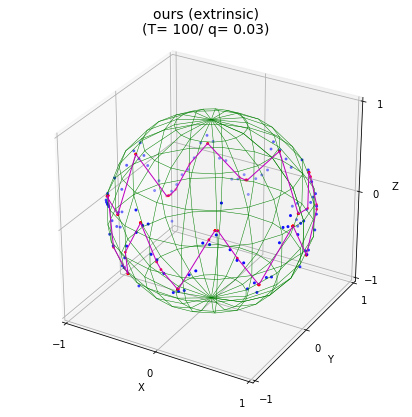

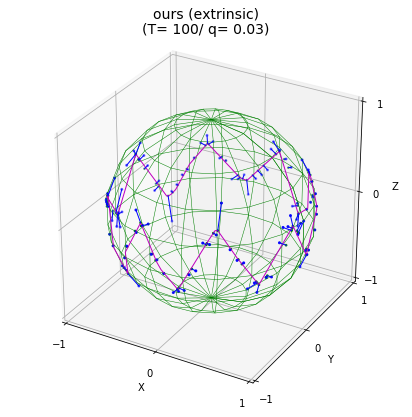


iteration ended at 7
total distance is 0.710
distinct projection : 94 / 100 
training time 22.318 s


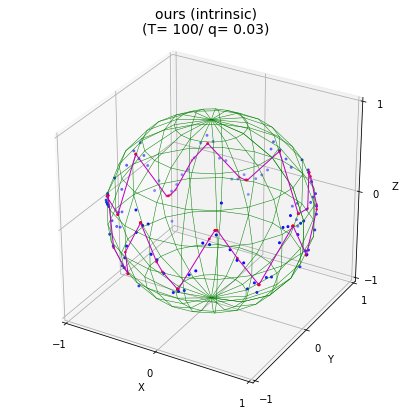

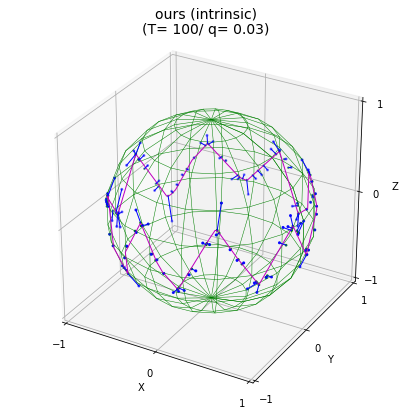


iteration ended at 7
total distance is 0.709
distinct projection : 94 / 100 
training time 22.718 s


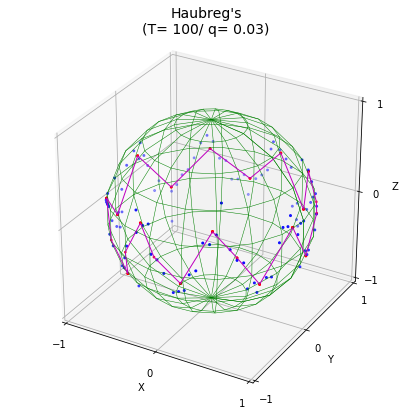

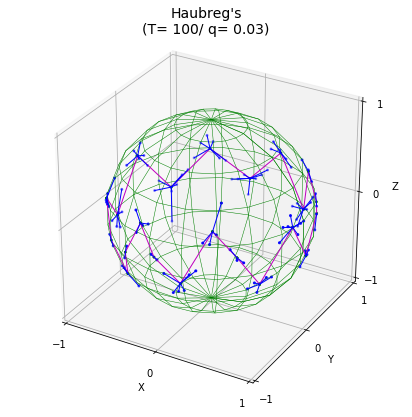


iteration ended at 9
total distance is 2.182
distinct projection : 27 / 100 
training time 7.004 s


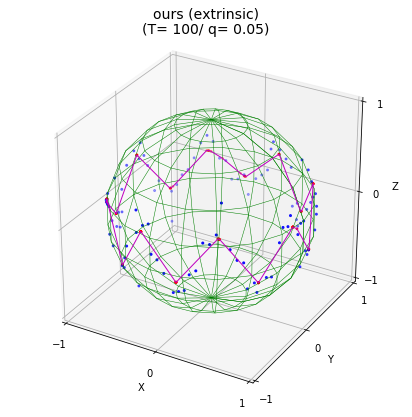

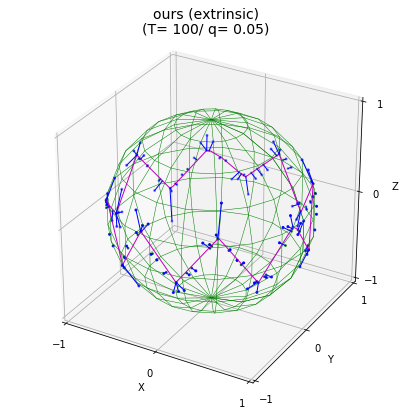


iteration ended at 7
total distance is 1.273
distinct projection : 87 / 100 
training time 22.422 s


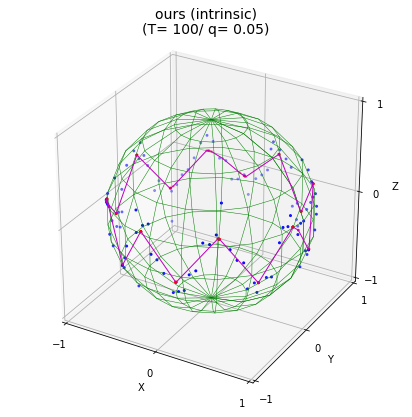

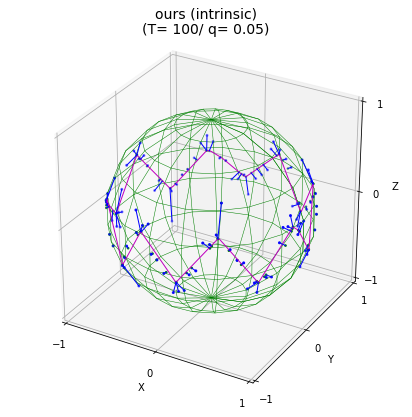


iteration ended at 7
total distance is 1.275
distinct projection : 90 / 100 
training time 22.682 s


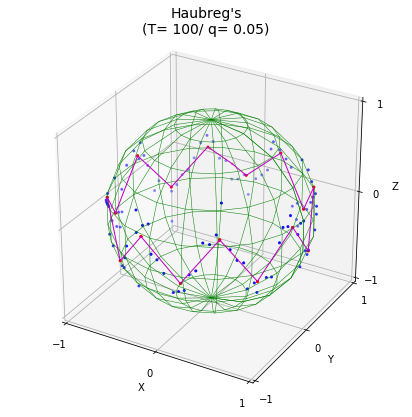

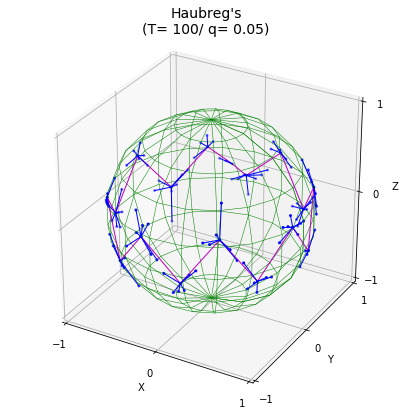


iteration ended at 8
total distance is 3.040
distinct projection : 21 / 100 
training time 6.285 s


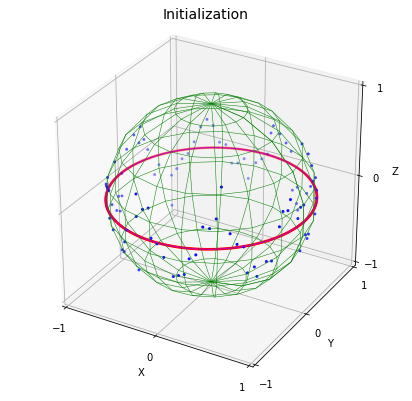

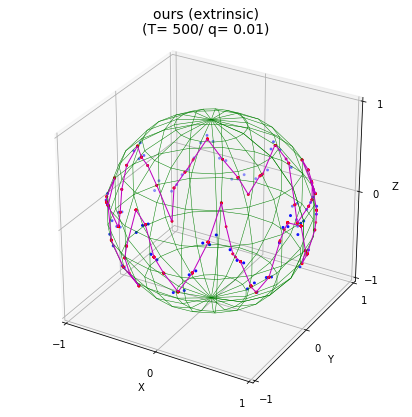

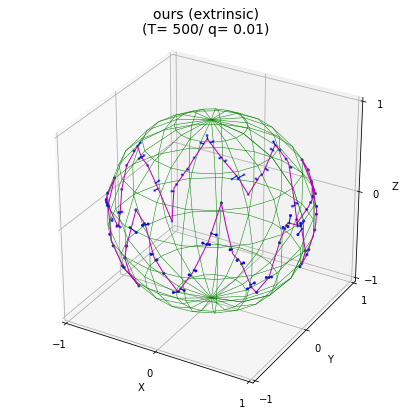


iteration ended at 9
total distance is 0.092
distinct projection : 100 / 100 
training time 136.071 s


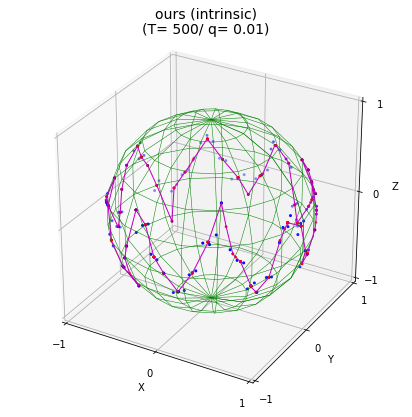

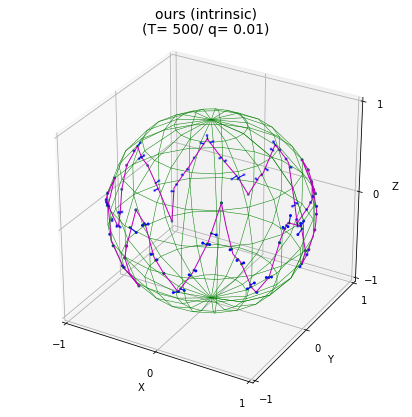


iteration ended at 9
total distance is 0.092
distinct projection : 100 / 100 
training time 135.200 s


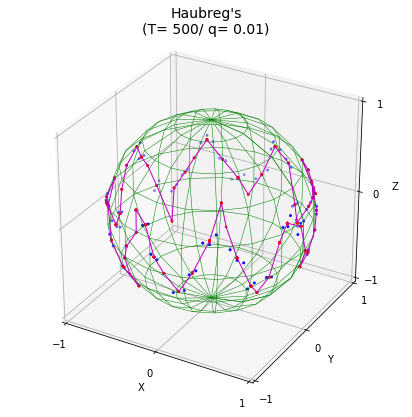

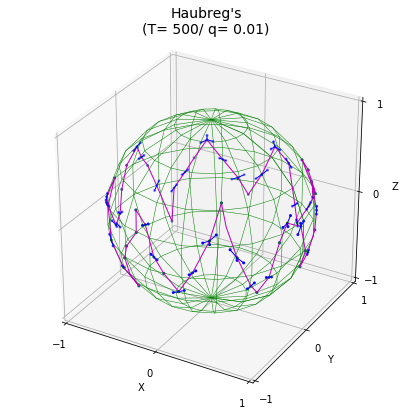


iteration ended at 9
total distance is 0.225
distinct projection : 69 / 100 
training time 32.429 s


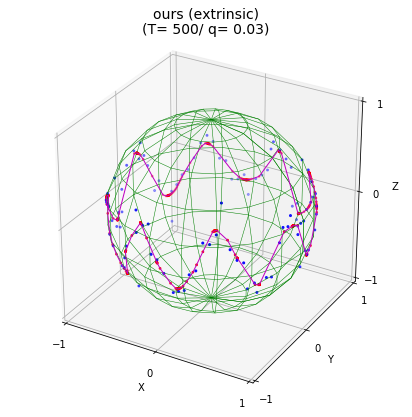

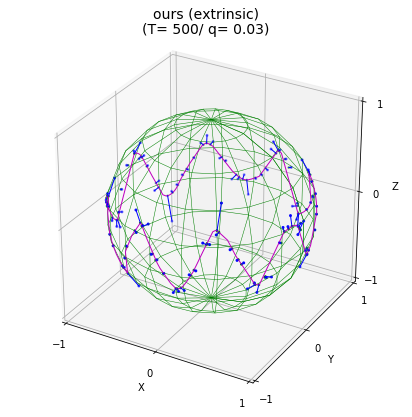


iteration ended at 5
total distance is 0.511
distinct projection : 100 / 100 
training time 86.175 s


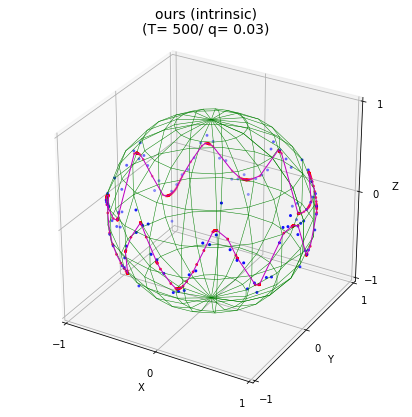

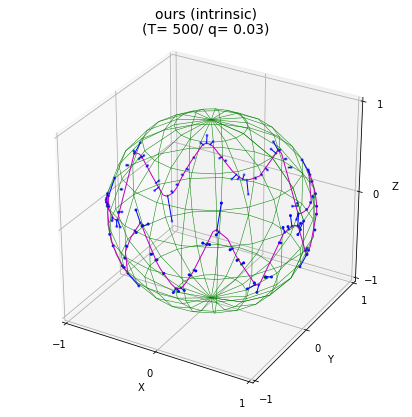


iteration ended at 5
total distance is 0.511
distinct projection : 100 / 100 
training time 86.932 s


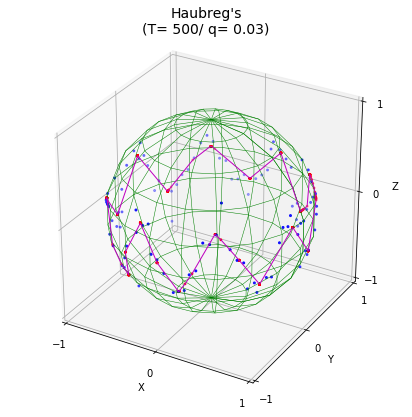

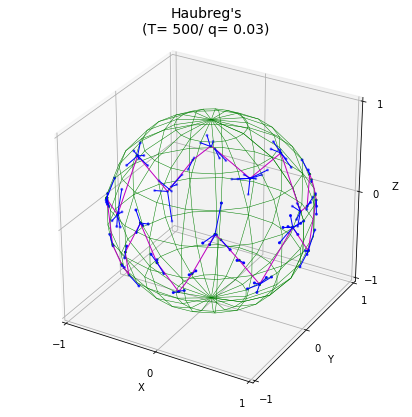


iteration ended at 9
total distance is 1.756
distinct projection : 44 / 100 
training time 32.276 s


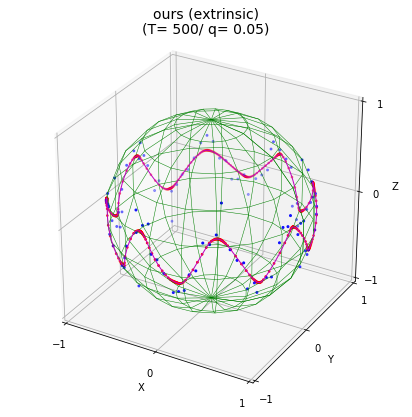

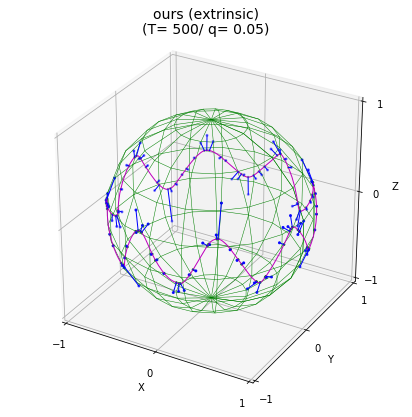


iteration ended at 2
total distance is 1.059
distinct projection : 100 / 100 
training time 49.107 s


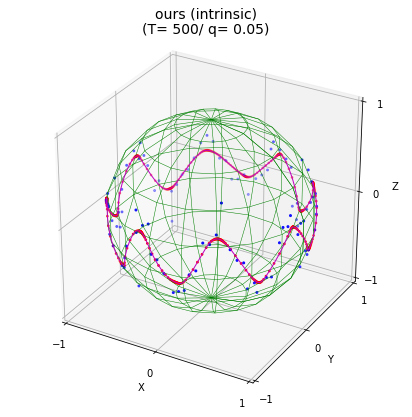

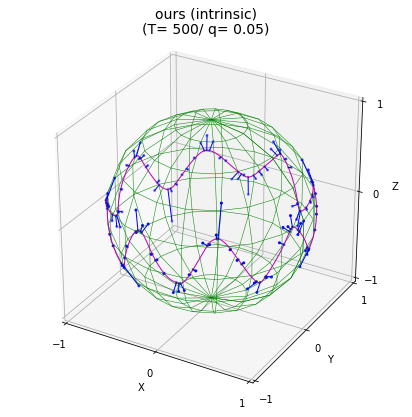


iteration ended at 2
total distance is 1.062
distinct projection : 100 / 100 
training time 49.724 s


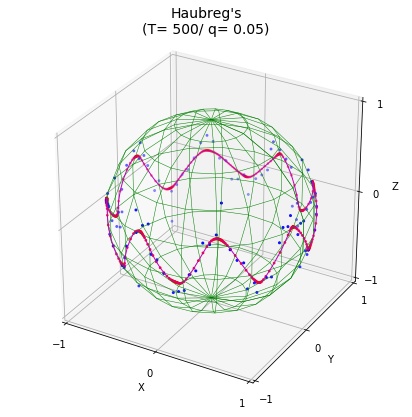

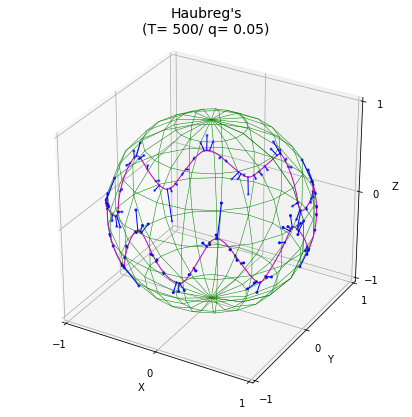


iteration ended at 2
total distance is 1.077
distinct projection : 95 / 100 
training time 12.016 s


In [61]:
n_points= [100, 500]; neighs= [0.01, 0.03, 0.05]
data_name= 'wave'

# initialization (principal circle)
p_, p3 = pga_circle(x_theta, False)

# initial projection
for n in n_points:
    init_project = np.zeros(shape=[2, n])
    init_project[0, :] = p3
    init_project[1, :] = np.arange(0, 2*m.pi, 2*m.pi/n)
    init_project = inv_rotate(p_, rad2euclid(init_project))

    plot_sphere(x, "Initialization", extra= init_project)
    
    for q in neighs:
        # iteration
        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=False,
                                             print_last=True, save_fig=True, data_name=data_name)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=True,
                                             print_last=True, save_fig=True, data_name=data_name)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=False, intrinsic=False,
                                             print_last=True, save_fig=True, data_name=data_name)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

#### another data setting (smaller frequency)

(2, 1000)


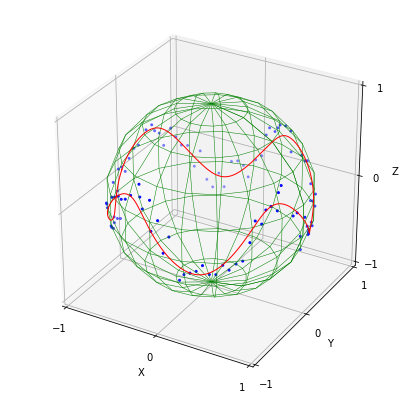

In [62]:
'''small frequency data generation'''
x = np.linspace(0,np.pi*2,1000)
data_sim1 = np.vstack((x+np.pi, np.sin(x*4)/3))
print(data_sim1.shape)

noise1 = np.random.normal(0,0.1,100)
noise2 = np.random.normal(0,1,100)

t1= data_sim1[1] + np.pi/2
t2= data_sim1[0]
x_true= np.vstack((np.sin(t1)*np.cos(t2), np.sin(t1)*np.sin(t2) ,np.cos(t1)))

t1= data_sim1[1,np.arange(100)*10] + np.pi/2 + noise1
t2= data_sim1[0,np.arange(100)*10] #+ noise2
x= np.vstack((np.sin(t1)*np.cos(t2), np.sin(t1)*np.sin(t2) ,np.cos(t1)))

x_theta= np.vstack((t1,t2))
data_len= x.shape[1]

plot_sphere(x,"", extra =x_true, line=True)

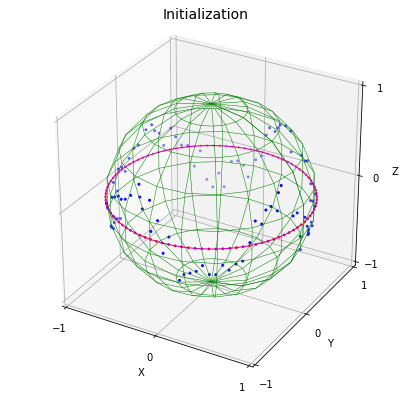

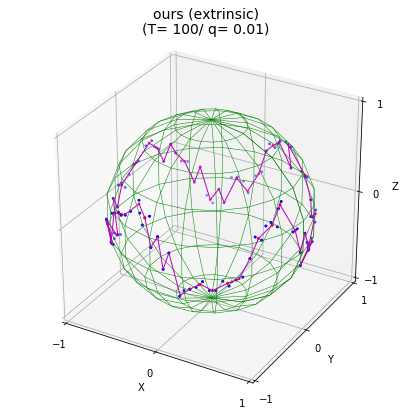

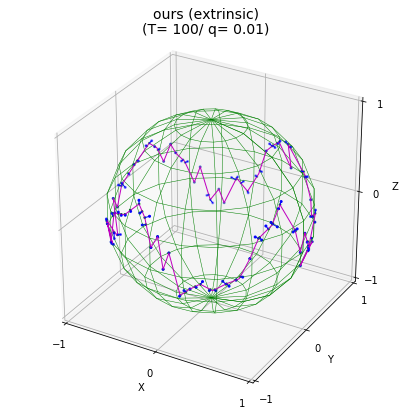


iteration ended at 9
total distance is 0.079
distinct projection : 100 / 100 
training time 27.161 s


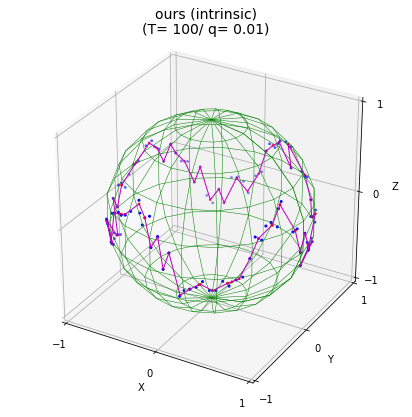

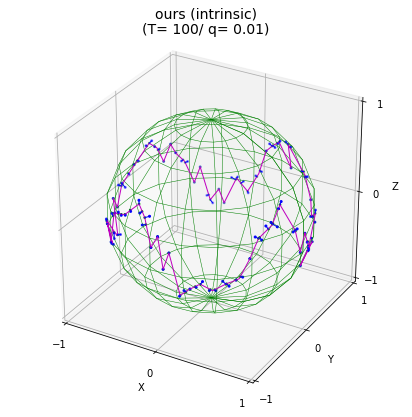


iteration ended at 9
total distance is 0.079
distinct projection : 100 / 100 
training time 27.476 s


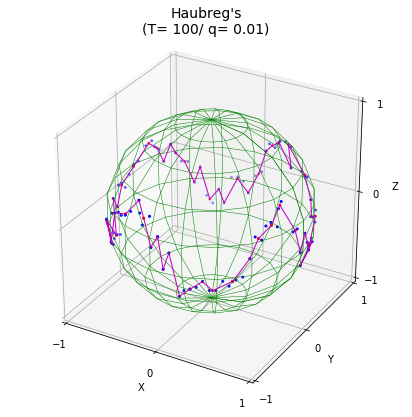

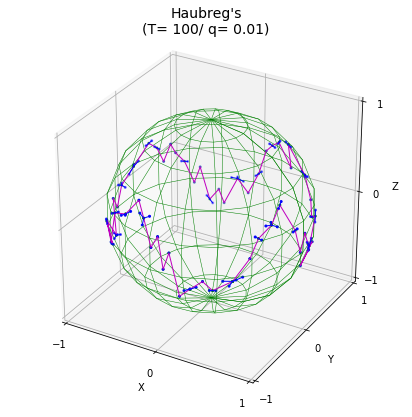


iteration ended at 9
total distance is 0.208
distinct projection : 63 / 100 
training time 6.867 s


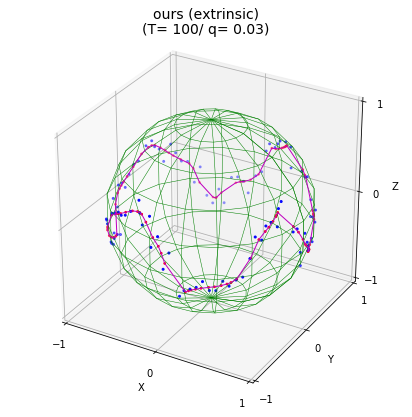

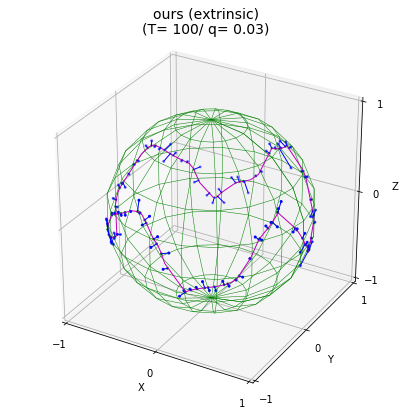


iteration ended at 2
total distance is 0.404
distinct projection : 99 / 100 
training time 10.656 s


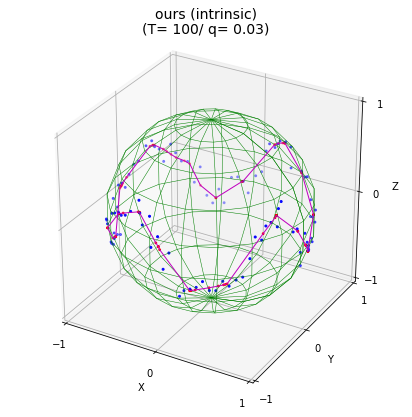

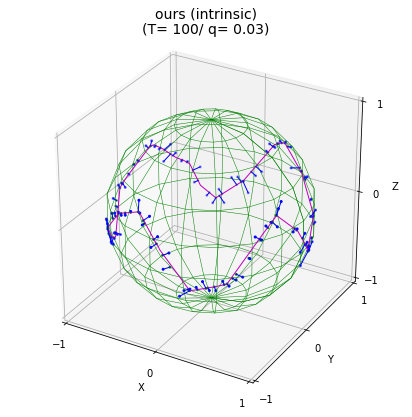


iteration ended at 9
total distance is 0.457
distinct projection : 100 / 100 
training time 27.407 s


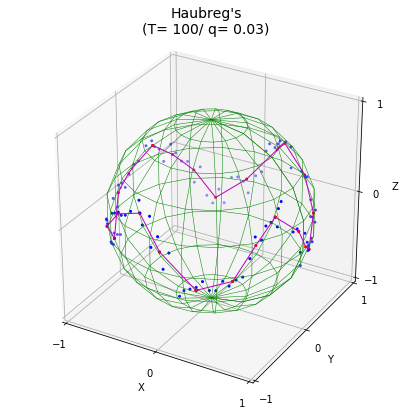

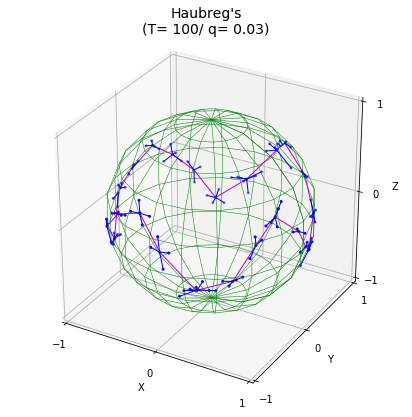


iteration ended at 9
total distance is 1.244
distinct projection : 39 / 100 
training time 6.998 s


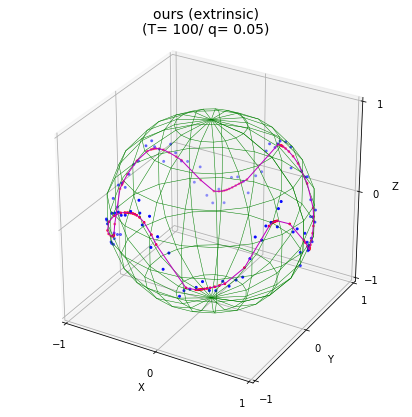

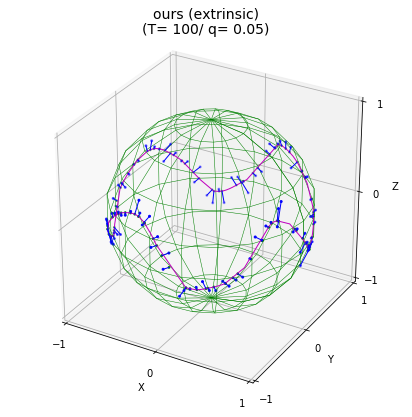


iteration ended at 4
total distance is 0.602
distinct projection : 99 / 100 
training time 15.266 s


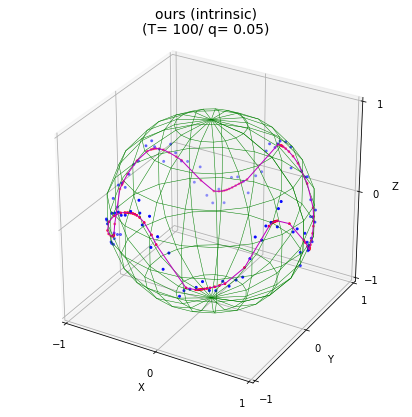

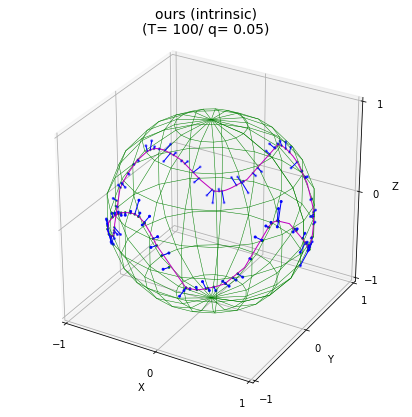


iteration ended at 4
total distance is 0.603
distinct projection : 99 / 100 
training time 15.241 s


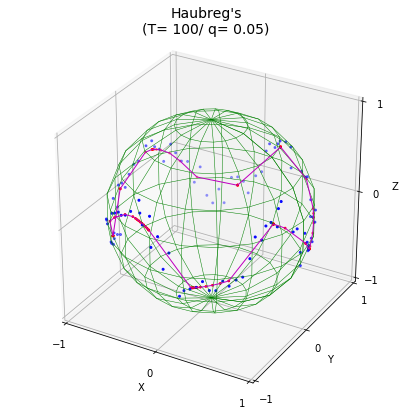

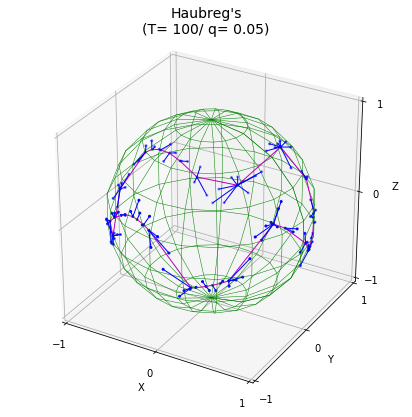


iteration ended at 9
total distance is 2.012
distinct projection : 41 / 100 
training time 6.892 s


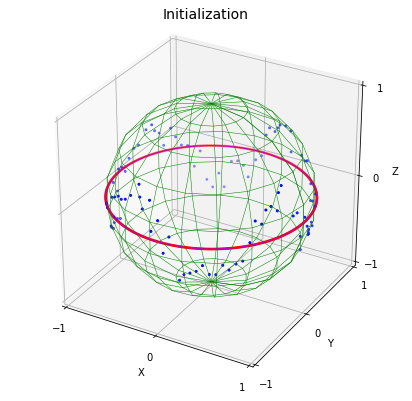

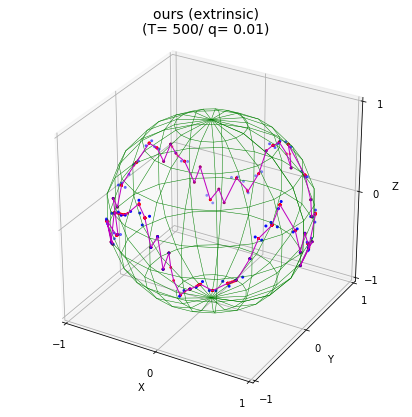

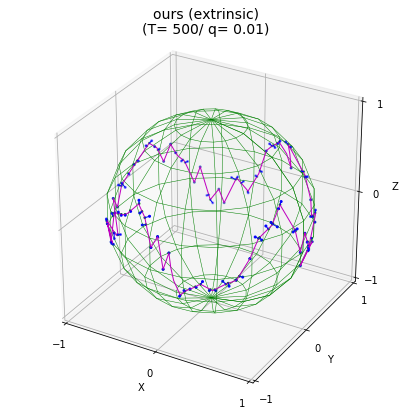


iteration ended at 9
total distance is 0.077
distinct projection : 100 / 100 
training time 136.111 s


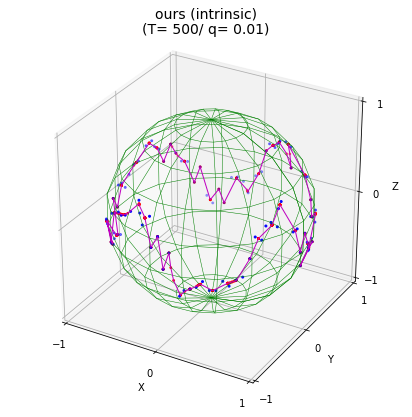

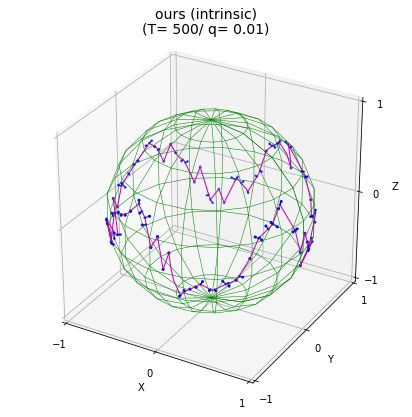


iteration ended at 9
total distance is 0.077
distinct projection : 100 / 100 
training time 136.033 s


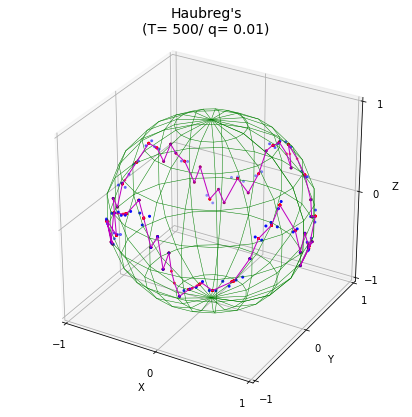

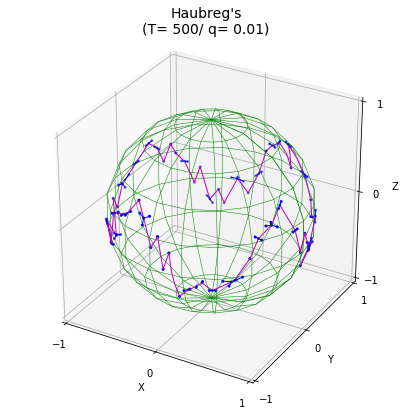


iteration ended at 9
total distance is 0.171
distinct projection : 76 / 100 
training time 32.118 s


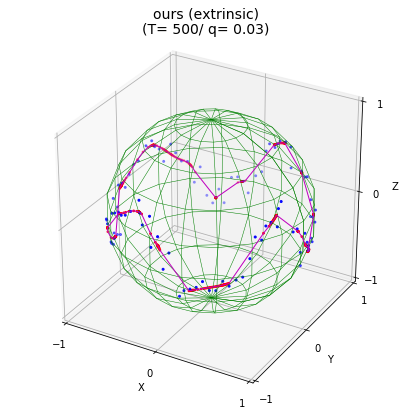

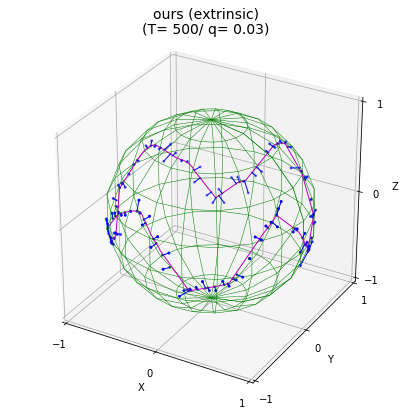


iteration ended at 9
total distance is 0.439
distinct projection : 99 / 100 
training time 136.178 s


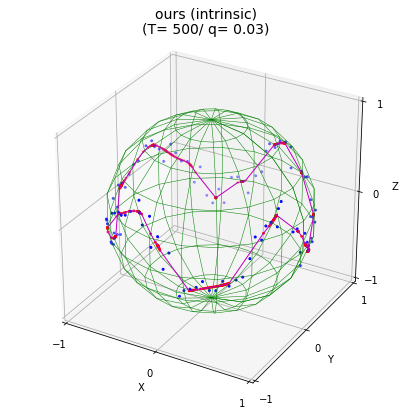

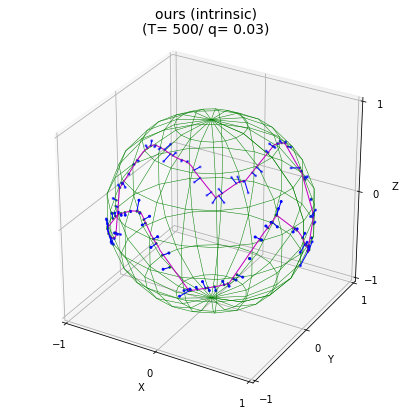


iteration ended at 9
total distance is 0.440
distinct projection : 99 / 100 
training time 136.677 s


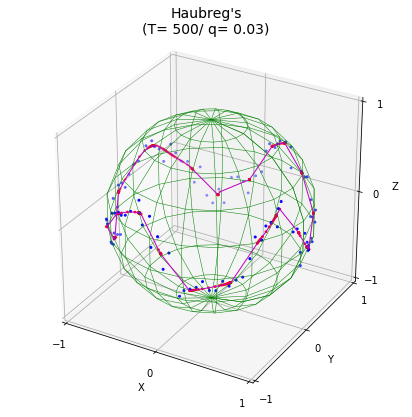

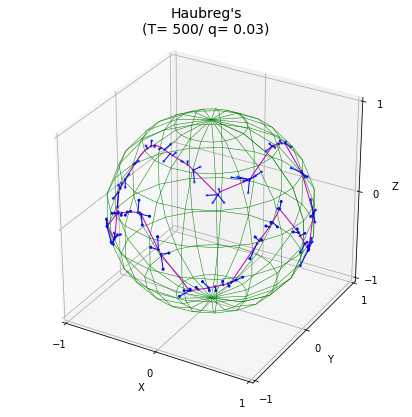


iteration ended at 9
total distance is 0.880
distinct projection : 61 / 100 
training time 32.685 s


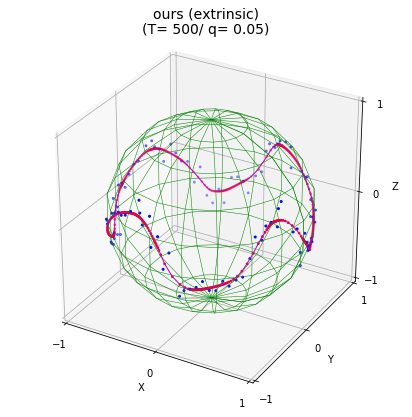

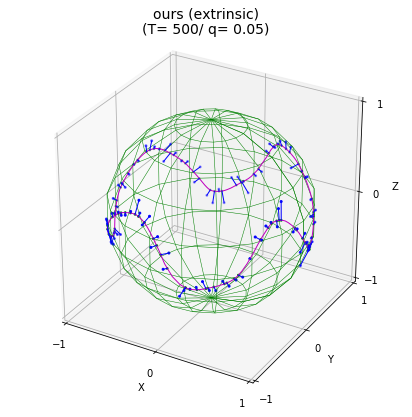


iteration ended at 3
total distance is 0.575
distinct projection : 100 / 100 
training time 61.141 s


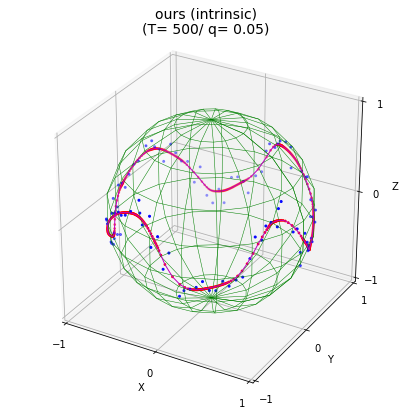

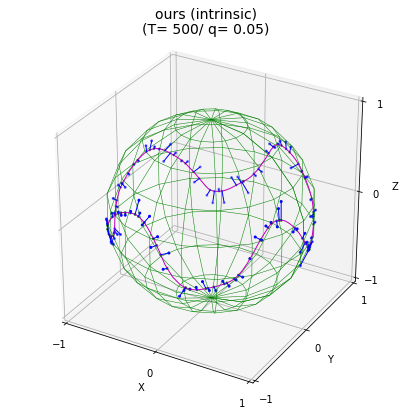


iteration ended at 3
total distance is 0.577
distinct projection : 100 / 100 
training time 62.088 s


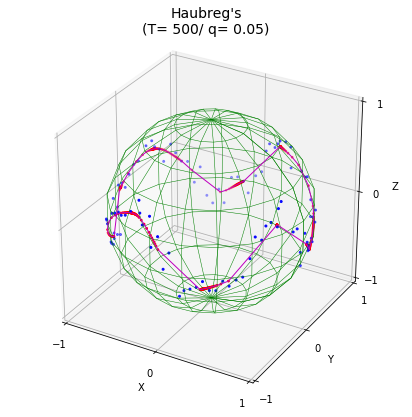

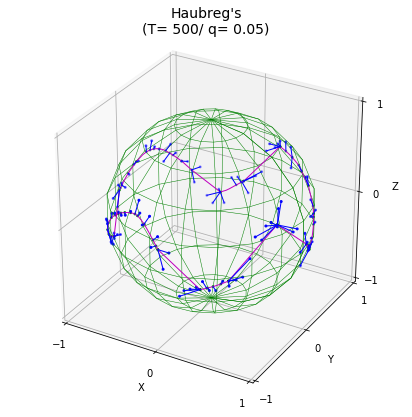


iteration ended at 9
total distance is 1.406
distinct projection : 66 / 100 
training time 32.247 s


In [63]:
n_points= [100, 500]; neighs= [0.01, 0.03, 0.05]
data_name= 'wave_small_freq'

# initialization (principal circle)
p_, p3 = pga_circle(x_theta, False)

# initial projection
for n in n_points:
    init_project = np.zeros(shape=[2, n])
    init_project[0, :] = p3
    init_project[1, :] = np.arange(0, 2*m.pi, 2*m.pi/n)
    init_project = inv_rotate(p_, rad2euclid(init_project))

    plot_sphere(x, "Initialization", extra= init_project)
    
    for q in neighs:
        # iteration
        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=False,
                                             print_last=True, save_fig=True, data_name=data_name)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=True,
                                             print_last=True, save_fig=True, data_name=data_name)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=False, intrinsic=False,
                                             print_last=True, save_fig=True, data_name=data_name)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

In [64]:
# plot_sphere(x,"", extra =x_true, line=True, extra2=points)

#### another data setting (smaller amplitude)

(2, 1000)


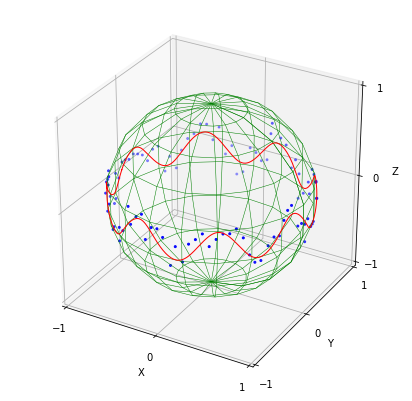

In [65]:
'''small amplitude data generation'''
x = np.linspace(0,np.pi*2,1000)
data_sim1 = np.vstack((x+np.pi, 1/2*np.sin(x*8)/3))
print(data_sim1.shape)

noise1 = np.random.normal(0,0.1,100)
noise2 = np.random.normal(0,1,100)

t1= data_sim1[1] + np.pi/2
t2= data_sim1[0]
x_true= np.vstack((np.sin(t1)*np.cos(t2), np.sin(t1)*np.sin(t2) ,np.cos(t1)))

t1= data_sim1[1,np.arange(100)*10] + np.pi/2 + noise1
t2= data_sim1[0,np.arange(100)*10] #+ noise2
x= np.vstack((np.sin(t1)*np.cos(t2), np.sin(t1)*np.sin(t2) ,np.cos(t1)))

x_theta= np.vstack((t1,t2))
data_len= x.shape[1]

plot_sphere(x,"", extra =x_true, line=True)

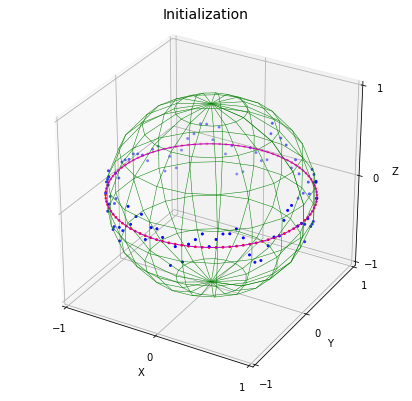

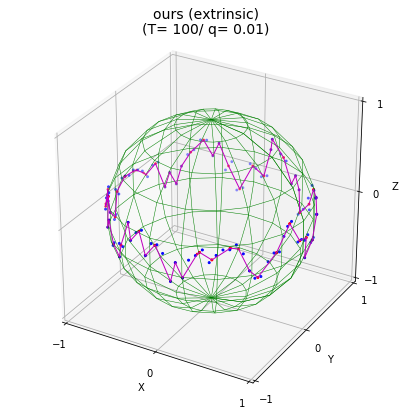

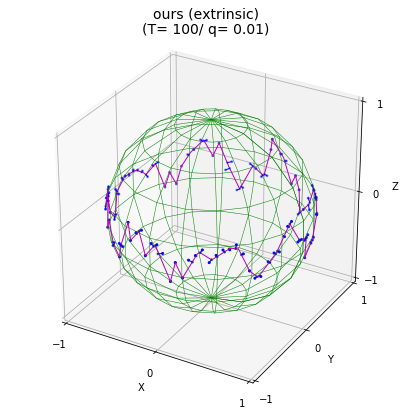


iteration ended at 9
total distance is 0.074
distinct projection : 100 / 100 
training time 27.429 s


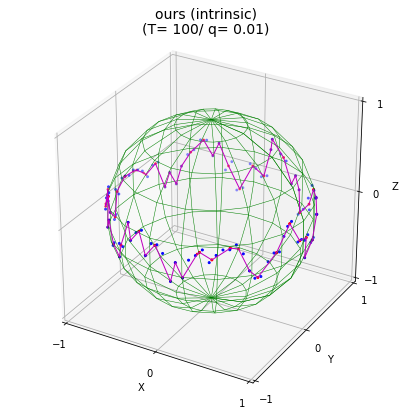

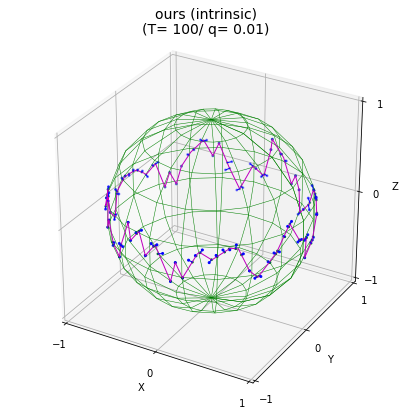


iteration ended at 9
total distance is 0.074
distinct projection : 100 / 100 
training time 27.446 s


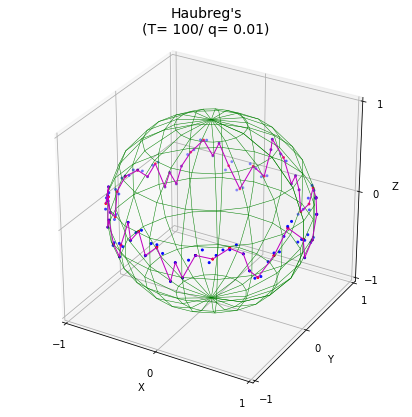

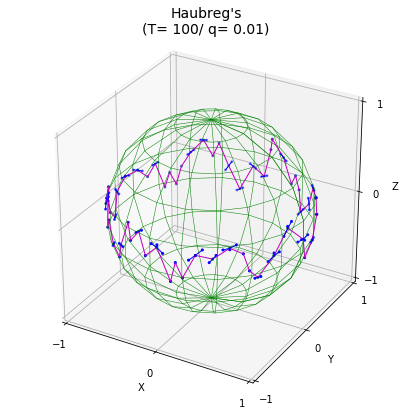


iteration ended at 9
total distance is 0.192
distinct projection : 62 / 100 
training time 6.881 s


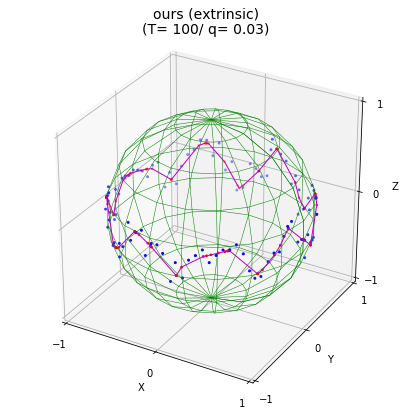

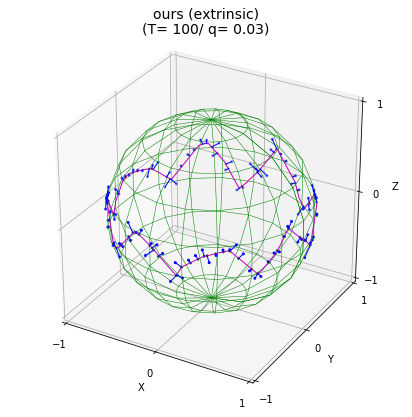


iteration ended at 6
total distance is 0.361
distinct projection : 100 / 100 
training time 20.099 s


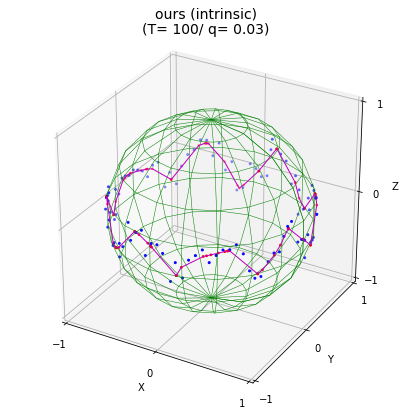

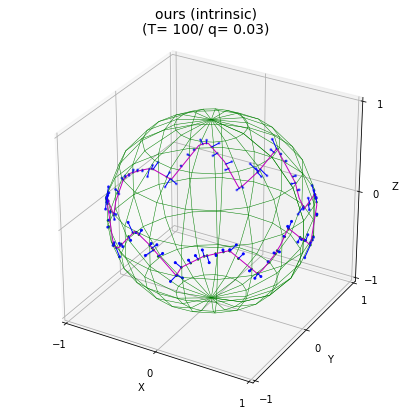


iteration ended at 6
total distance is 0.361
distinct projection : 100 / 100 
training time 20.148 s


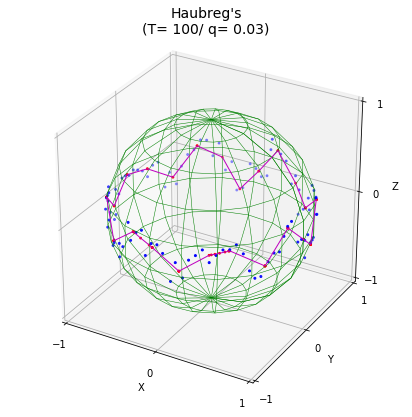

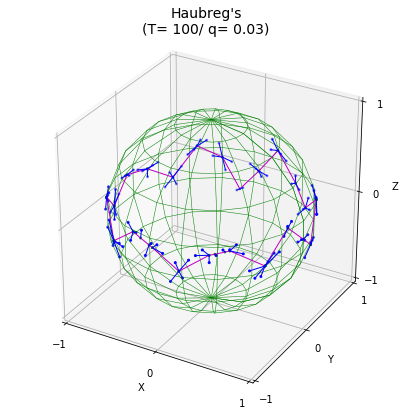


iteration ended at 9
total distance is 1.265
distinct projection : 34 / 100 
training time 7.036 s


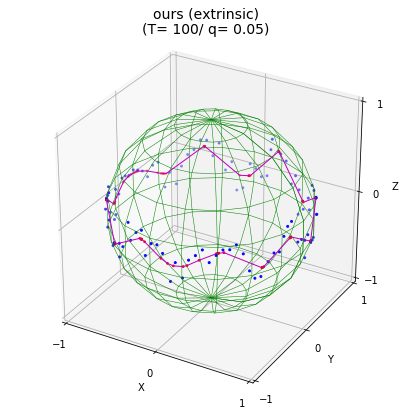

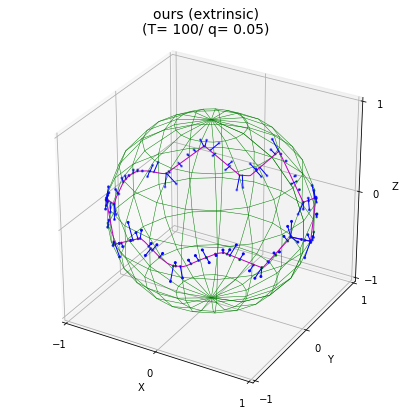


iteration ended at 9
total distance is 0.869
distinct projection : 92 / 100 
training time 27.277 s


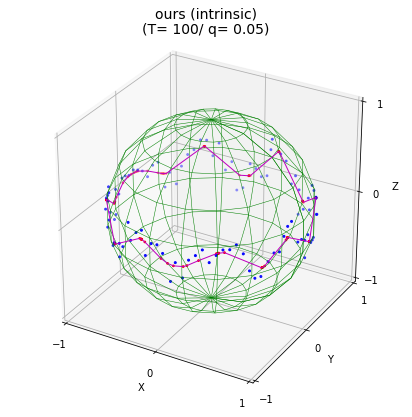

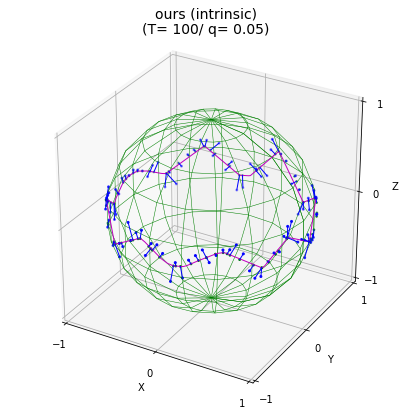


iteration ended at 9
total distance is 0.883
distinct projection : 92 / 100 
training time 27.687 s


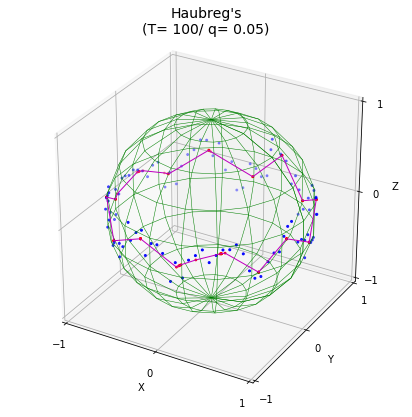

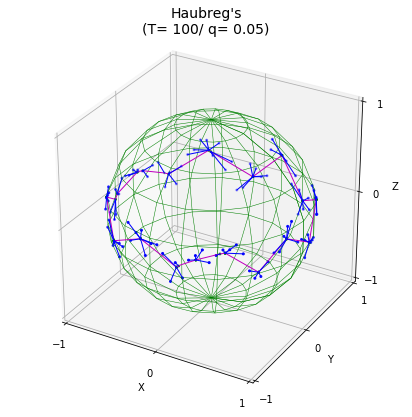


iteration ended at 9
total distance is 2.075
distinct projection : 30 / 100 
training time 6.894 s


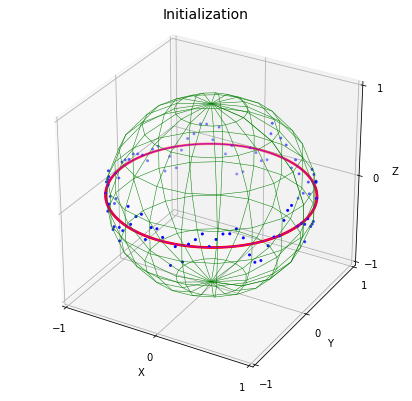

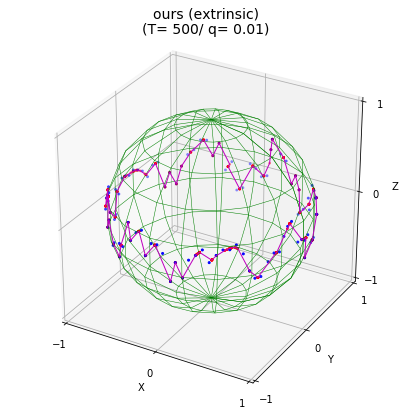

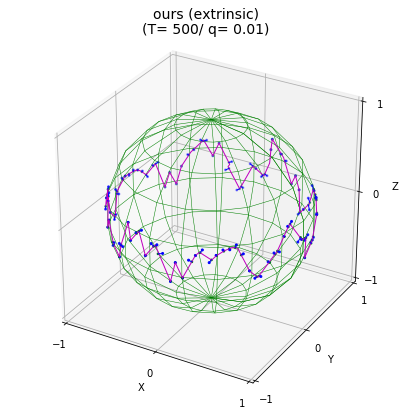


iteration ended at 9
total distance is 0.068
distinct projection : 100 / 100 
training time 135.683 s


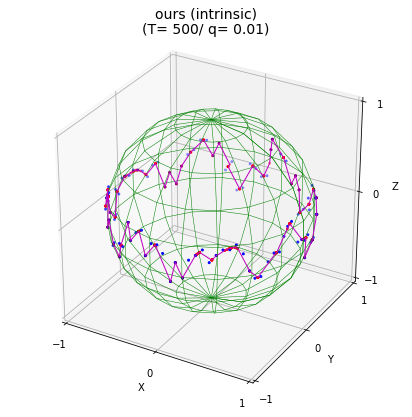

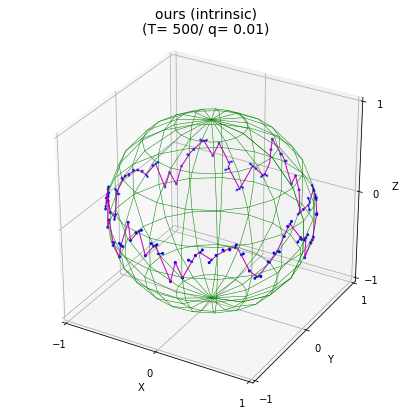


iteration ended at 9
total distance is 0.069
distinct projection : 100 / 100 
training time 135.465 s


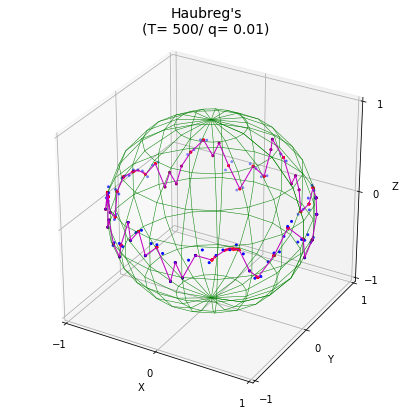

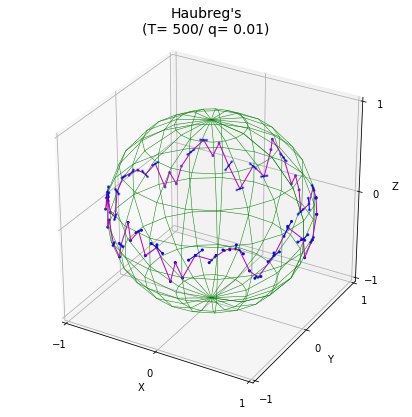


iteration ended at 9
total distance is 0.173
distinct projection : 77 / 100 
training time 32.375 s


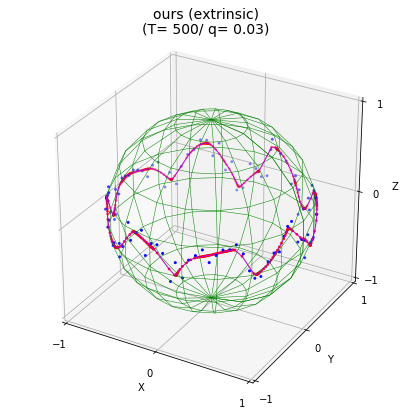

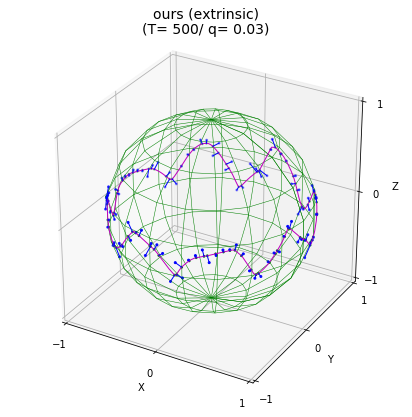


iteration ended at 3
total distance is 0.319
distinct projection : 100 / 100 
training time 61.704 s


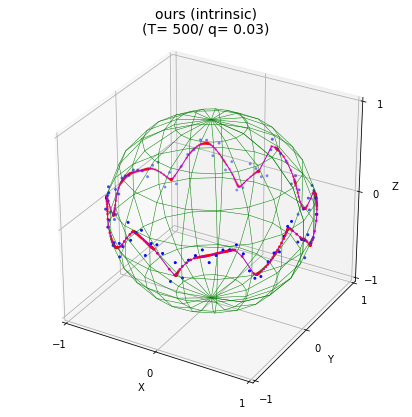

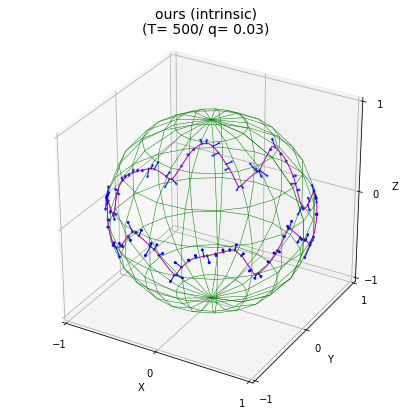


iteration ended at 3
total distance is 0.319
distinct projection : 100 / 100 
training time 62.144 s


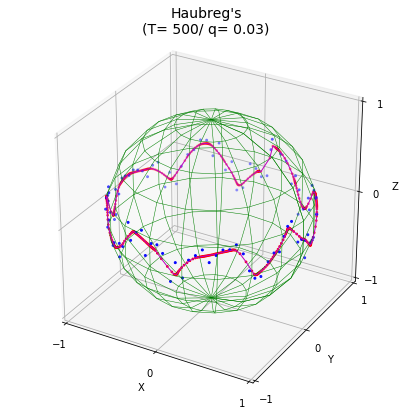

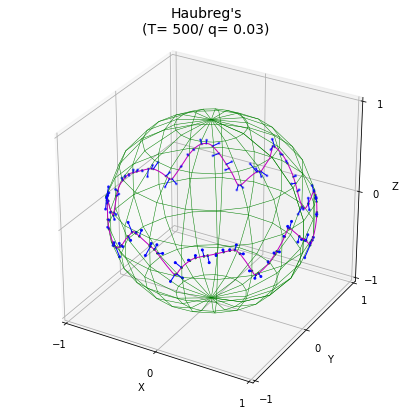


iteration ended at 2
total distance is 0.335
distinct projection : 99 / 100 
training time 12.007 s


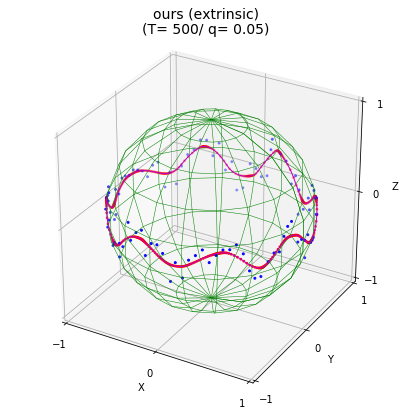

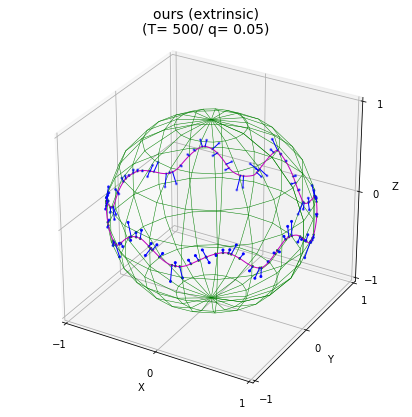


iteration ended at 3
total distance is 0.646
distinct projection : 99 / 100 
training time 61.551 s


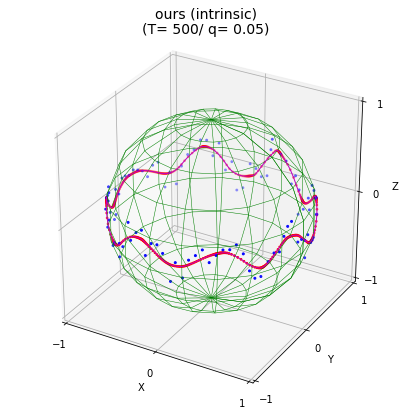

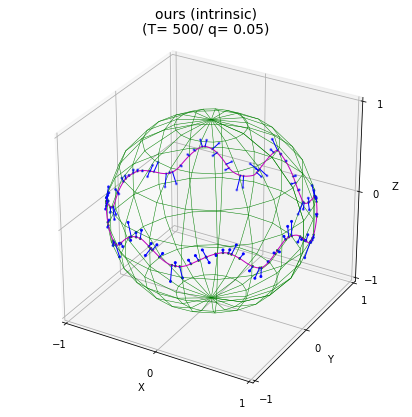


iteration ended at 3
total distance is 0.647
distinct projection : 100 / 100 
training time 62.291 s


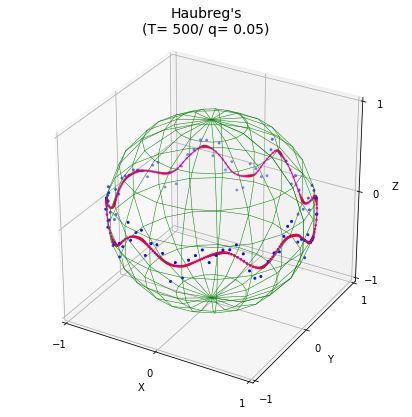

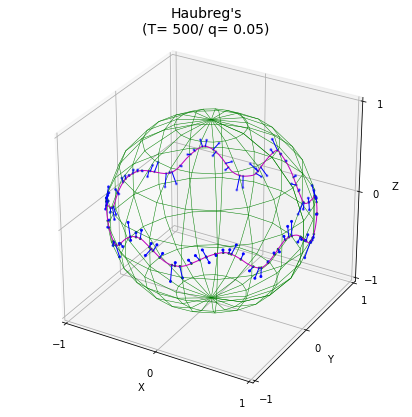


iteration ended at 3
total distance is 0.651
distinct projection : 93 / 100 
training time 14.931 s


In [66]:
n_points= [100, 500]; neighs= [0.01, 0.03, 0.05]
data_name= 'wave_small_amp'

# initialization (principal circle)
p_, p3 = pga_circle(x_theta, False)

# initial projection
for n in n_points:
    init_project = np.zeros(shape=[2, n])
    init_project[0, :] = p3
    init_project[1, :] = np.arange(0, 2*m.pi, 2*m.pi/n)
    init_project = inv_rotate(p_, rad2euclid(init_project))

    plot_sphere(x, "Initialization", extra= init_project)
    
    for q in neighs:
        # iteration
        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=False,
                                             print_last=True, save_fig=True, data_name=data_name)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=True,
                                             print_last=True, save_fig=True, data_name=data_name)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=False, intrinsic=False,
                                             print_last=True, save_fig=True, data_name=data_name)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

#### more sparse data points

(2, 1000)


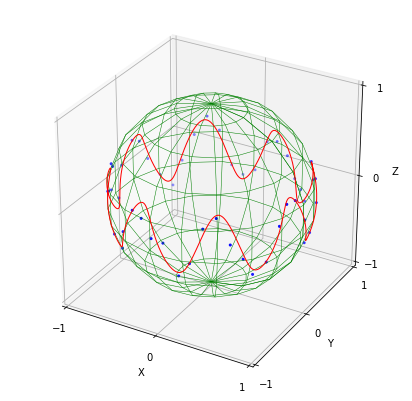

In [67]:
# data generation
data_num=50
x = np.linspace(0,np.pi*2,1000)
data_sim1 = np.vstack((x, np.sin(x*8)/3))
print(data_sim1.shape)

noise1 = np.random.normal(0,0.1,data_num)
noise2 = np.random.normal(0,1,data_num)

t1= data_sim1[1] + np.pi/2
t2= data_sim1[0]
x_true= np.vstack((np.sin(t1)*np.cos(t2), np.sin(t1)*np.sin(t2) ,np.cos(t1)))

t1= data_sim1[1,np.arange(data_num)*int(1000/data_num)] + np.pi/2 + noise1
t2= data_sim1[0,np.arange(data_num)*int(1000/data_num)] #+ noise2
x= np.vstack((np.sin(t1)*np.cos(t2), np.sin(t1)*np.sin(t2) ,np.cos(t1)))

x_theta= np.vstack((t1,t2))
data_len= x.shape[1]

plot_sphere(x,"", extra =x_true, line=True)

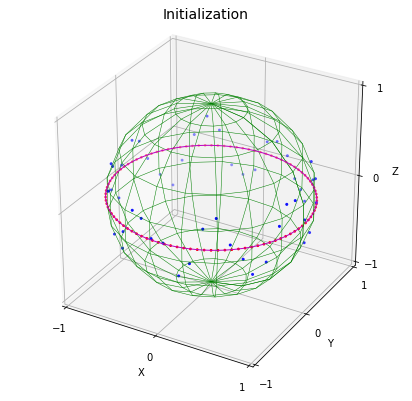

/home/janghyun/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:275: RuntimeWarning: divide by zero encountered in double_scalars


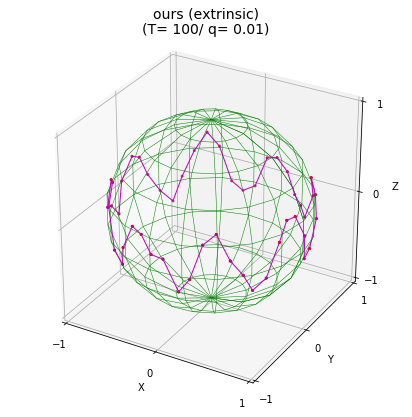

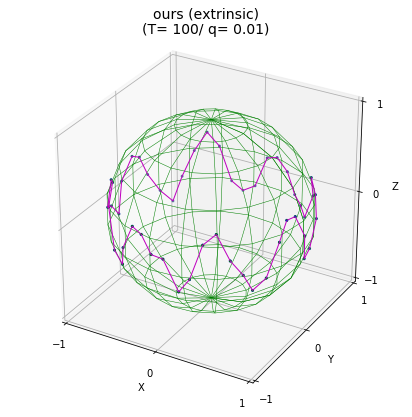


iteration ended at 4
total distance is 0.000
distinct projection : 50 / 50 
training time 7.747 s


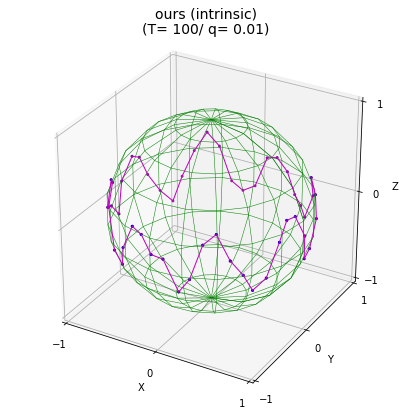

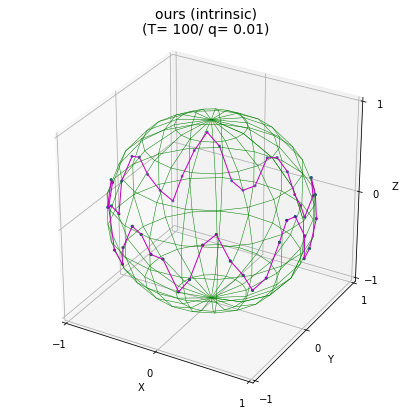


iteration ended at 4
total distance is 0.000
distinct projection : 50 / 50 
training time 7.798 s


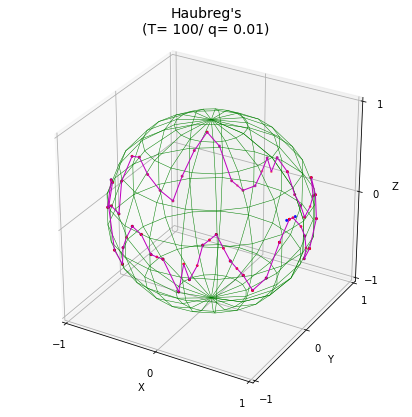

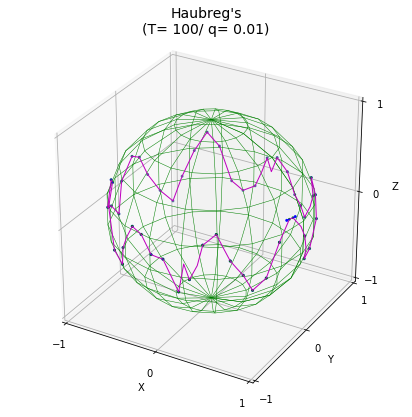


iteration ended at 9
total distance is 0.003
distinct projection : 50 / 50 
training time 3.658 s


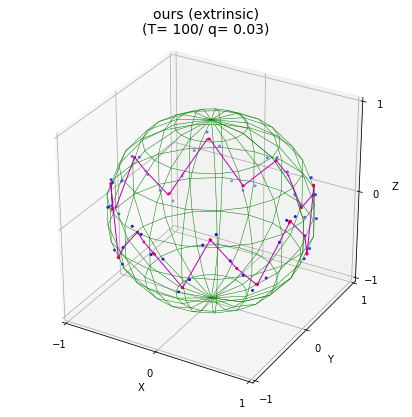

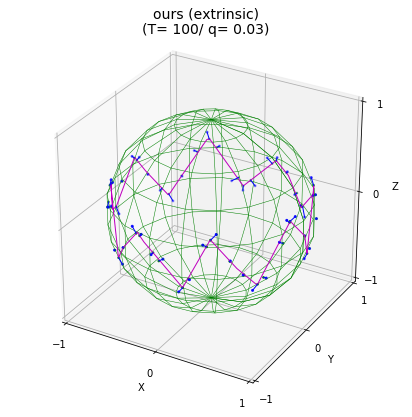


iteration ended at 7
total distance is 0.150
distinct projection : 50 / 50 
training time 11.468 s


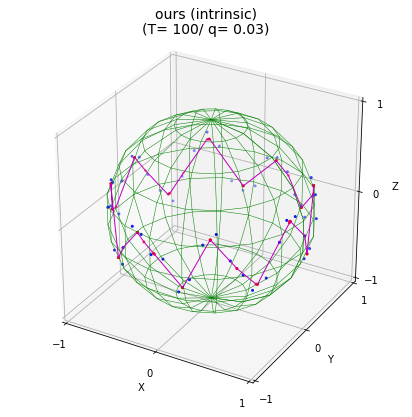

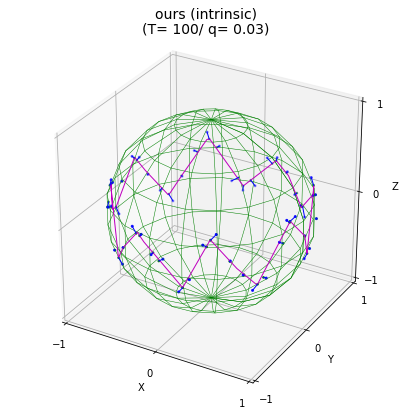


iteration ended at 7
total distance is 0.151
distinct projection : 50 / 50 
training time 11.787 s


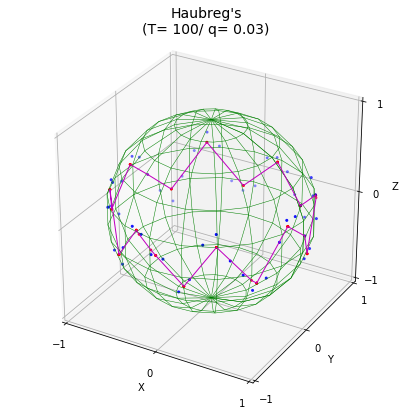

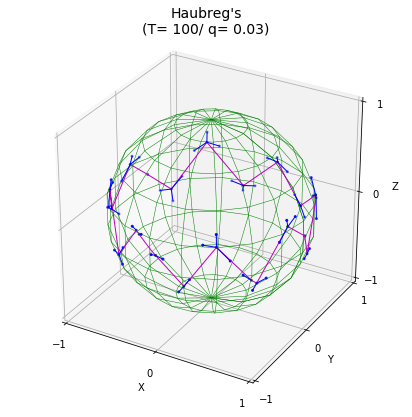


iteration ended at 9
total distance is 0.803
distinct projection : 28 / 50 
training time 3.658 s


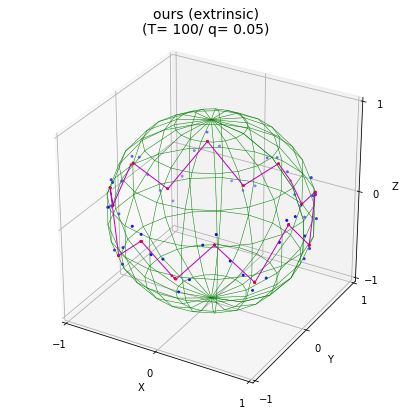

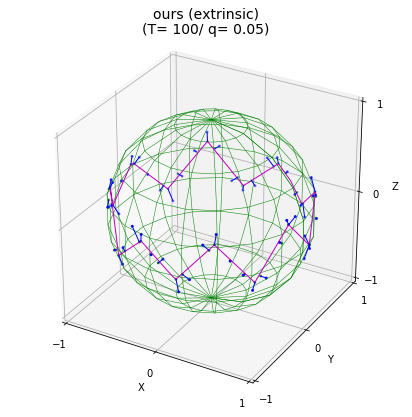


iteration ended at 9
total distance is 0.444
distinct projection : 49 / 50 
training time 13.887 s


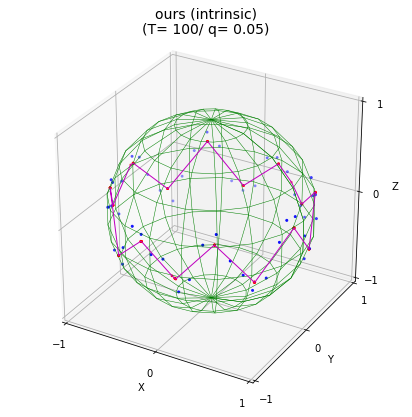

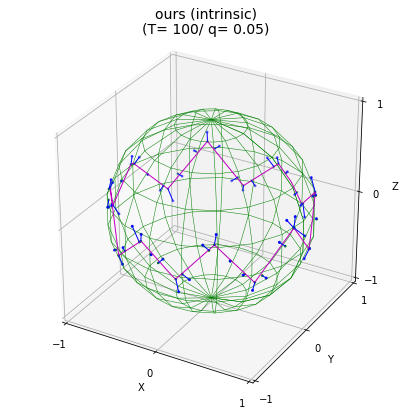


iteration ended at 9
total distance is 0.435
distinct projection : 49 / 50 
training time 14.021 s


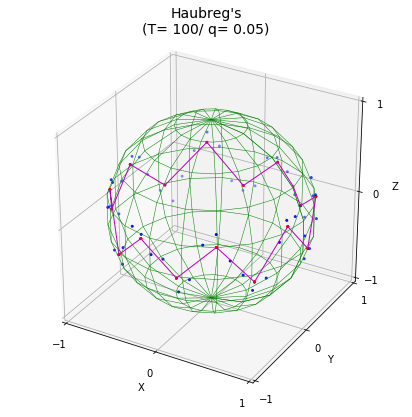

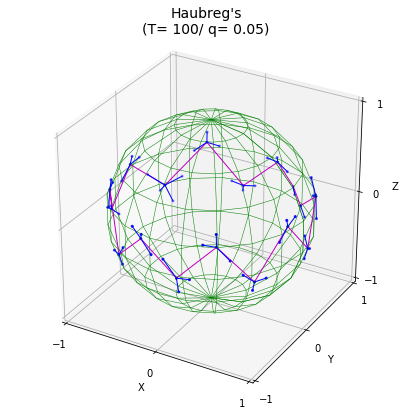


iteration ended at 9
total distance is 1.127
distinct projection : 22 / 50 
training time 3.762 s


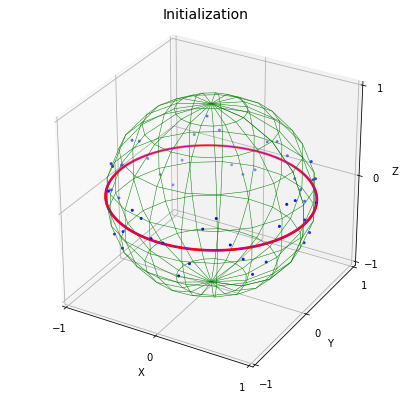

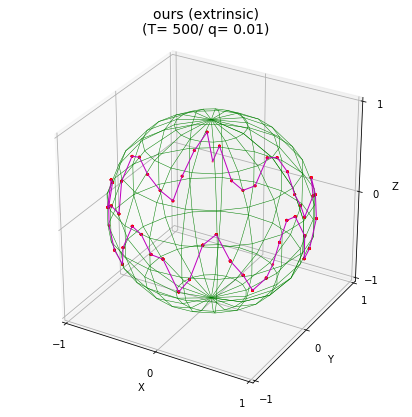

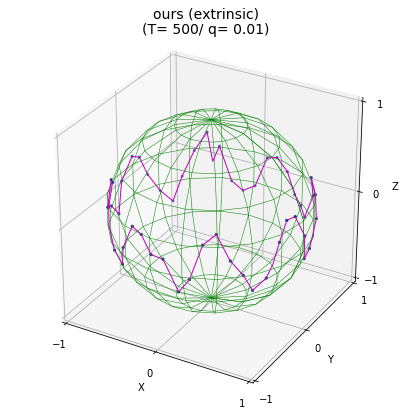


iteration ended at 7
total distance is 0.000
distinct projection : 50 / 50 
training time 55.990 s


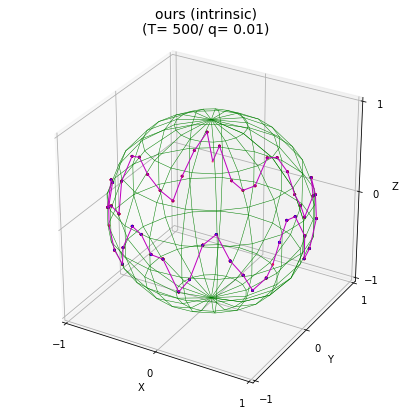

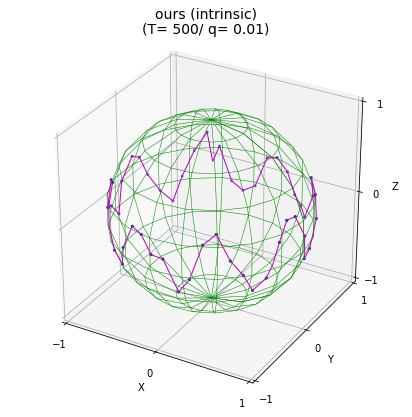


iteration ended at 7
total distance is 0.000
distinct projection : 50 / 50 
training time 55.961 s


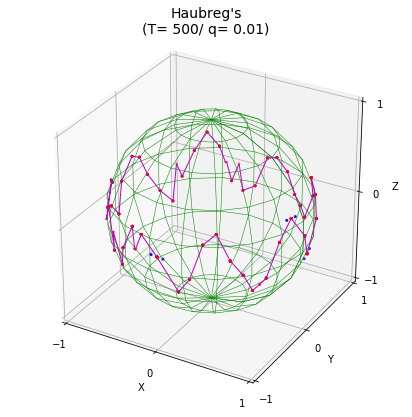

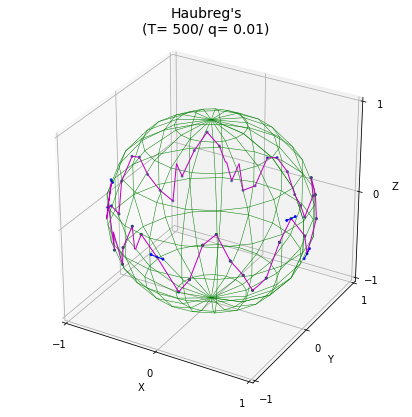


iteration ended at 9
total distance is 0.031
distinct projection : 49 / 50 
training time 16.518 s


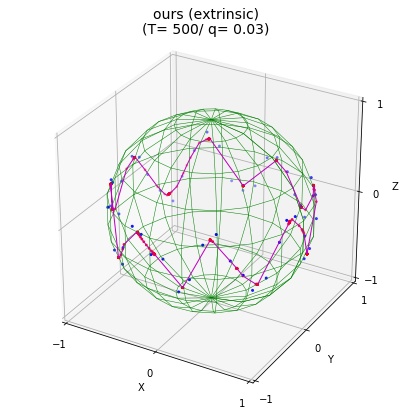

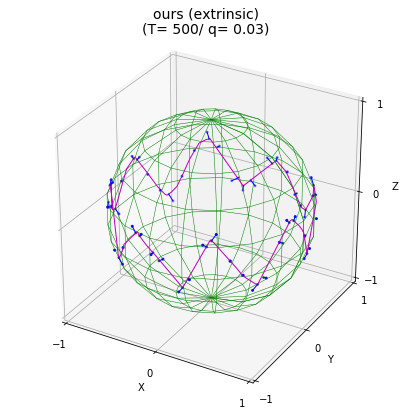


iteration ended at 8
total distance is 0.132
distinct projection : 50 / 50 
training time 61.611 s


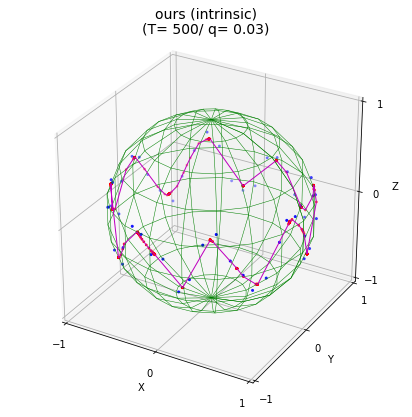

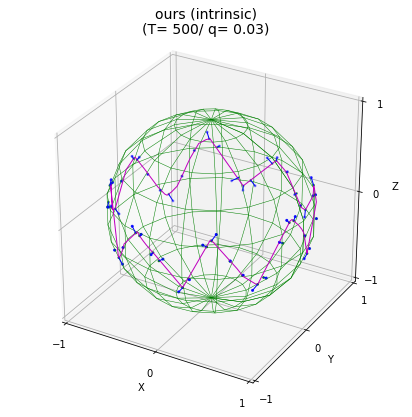


iteration ended at 8
total distance is 0.133
distinct projection : 50 / 50 
training time 63.096 s


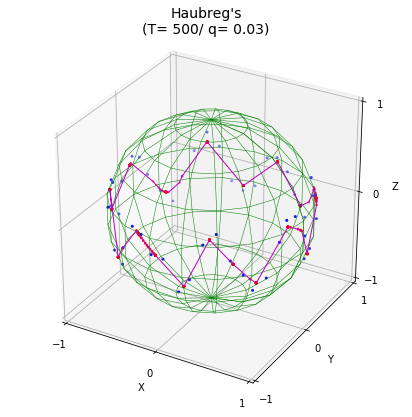

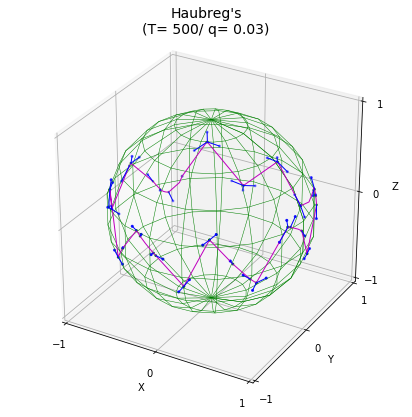


iteration ended at 9
total distance is 0.555
distinct projection : 40 / 50 
training time 16.697 s


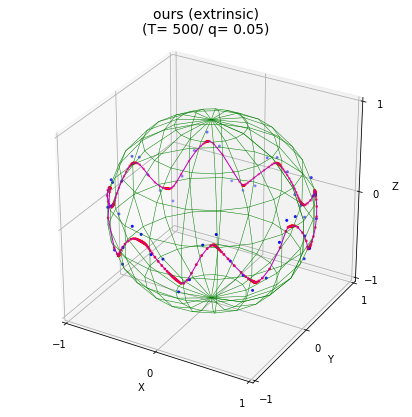

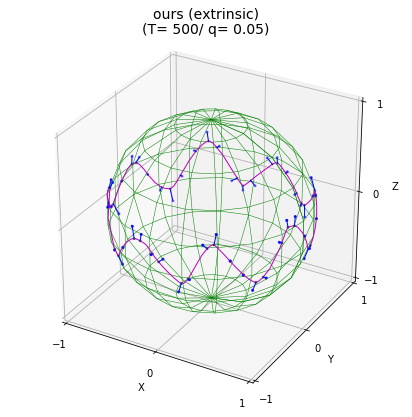


iteration ended at 3
total distance is 0.271
distinct projection : 50 / 50 
training time 31.256 s


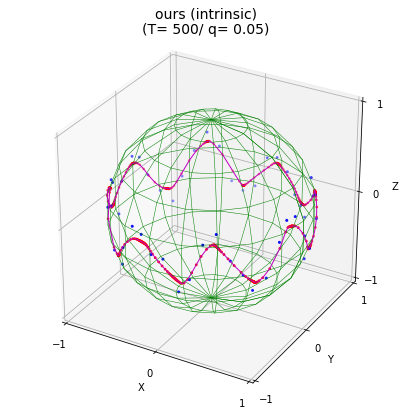

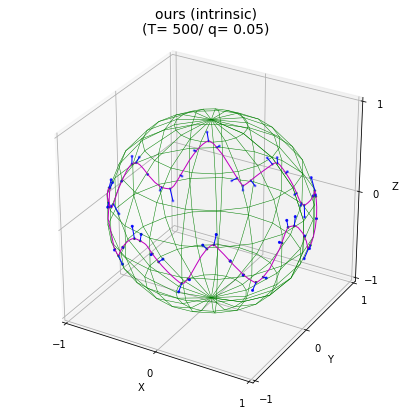


iteration ended at 3
total distance is 0.273
distinct projection : 50 / 50 
training time 31.645 s


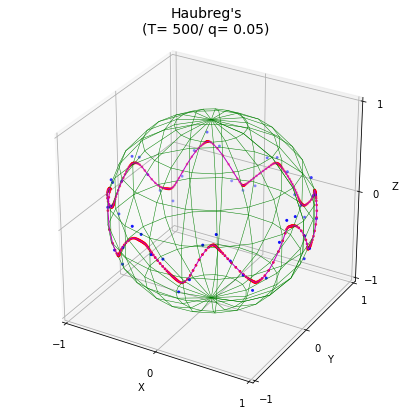

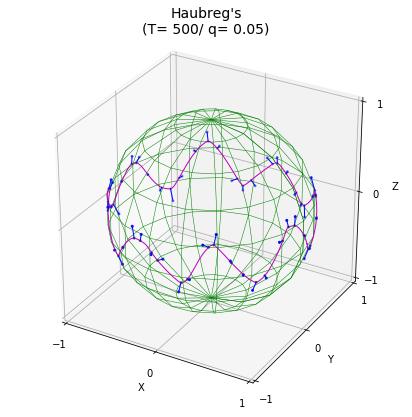


iteration ended at 2
total distance is 0.277
distinct projection : 50 / 50 
training time 6.258 s


In [68]:
n_points= [100, 500]; neighs= [0.01, 0.03, 0.05]
data_name= 'wave_sparse_data'

# initialization (principal circle)
p_, p3 = pga_circle(x_theta, False)

# initial projection
for n in n_points:
    init_project = np.zeros(shape=[2, n])
    init_project[0, :] = p3
    init_project[1, :] = np.arange(0, 2*m.pi, 2*m.pi/n)
    init_project = inv_rotate(p_, rad2euclid(init_project))

    plot_sphere(x, "Initialization", extra= init_project)
    
    for q in neighs:
        # iteration
        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=False,
                                             print_last=True, save_fig=True, data_name=data_name)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=True,
                                             print_last=True, save_fig=True, data_name=data_name)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=False, intrinsic=False,
                                             print_last=True, save_fig=True, data_name=data_name)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

### 2-3) spiral
#### dataset generation

(2, 1000)


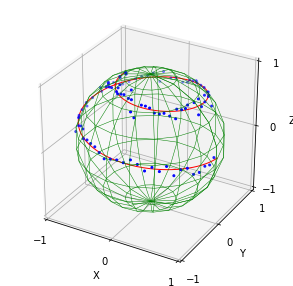

In [61]:
# data generation
x = np.linspace(0,np.pi*3,1000) + np.pi 
y = np.linspace(np.pi/8,np.pi/2,1000)
data_sim2 = np.vstack((x, y))
print(data_sim2.shape)

noise1 = np.random.normal(0,0.07,100)
noise2 = np.random.normal(0,1,100)

t1= data_sim2[1]
t2= data_sim2[0]
x_true= np.vstack((np.sin(t1)*np.cos(t2), np.sin(t1)*np.sin(t2) ,np.cos(t1)))

t1= data_sim2[1,np.arange(100)*10] + noise1
t2= data_sim2[0,np.arange(100)*10] #+ noise2
x= np.vstack((np.sin(t1)*np.cos(t2), np.sin(t1)*np.sin(t2) ,np.cos(t1)))

x_theta= np.vstack((t1,t2))
data_len= x.shape[1]

plot_sphere(x,"", extra =x_true, line=True)

#### initialization and fitting

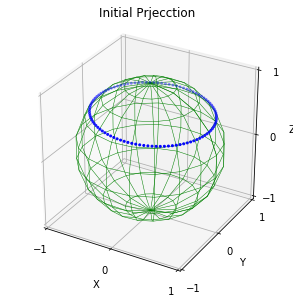

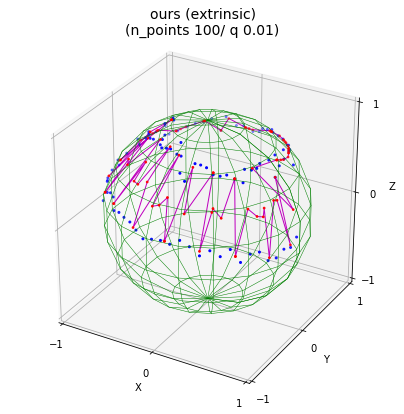

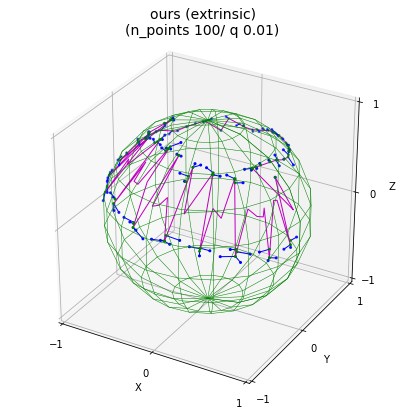


iteration ended at 6
total distance is 0.441
distinct projection : 94 / 100 
training time 45.380 s


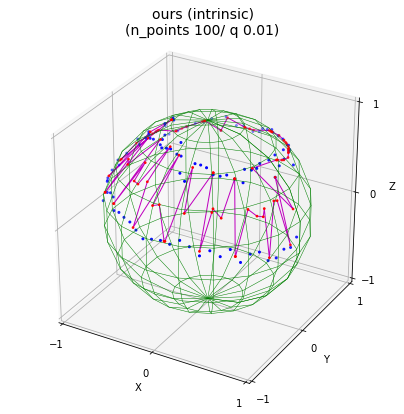

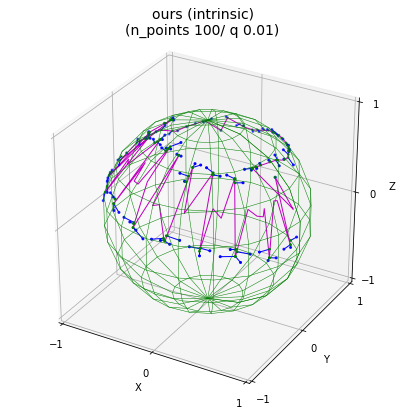


iteration ended at 5
total distance is 0.432
distinct projection : 95 / 100 
training time 39.765 s


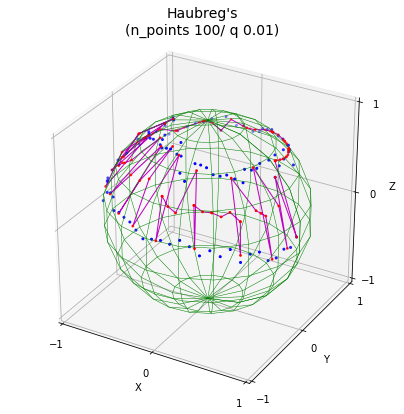

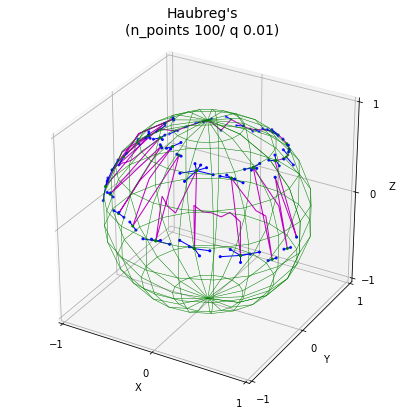


iteration ended at 3
total distance is 0.592
distinct projection : 52 / 100 
training time 4.716 s


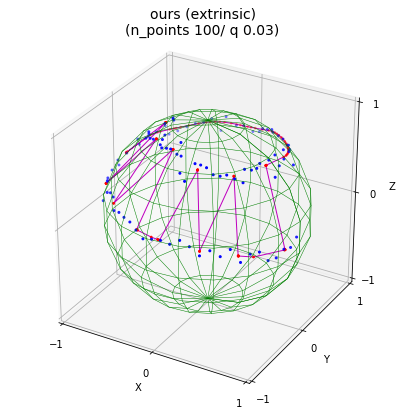

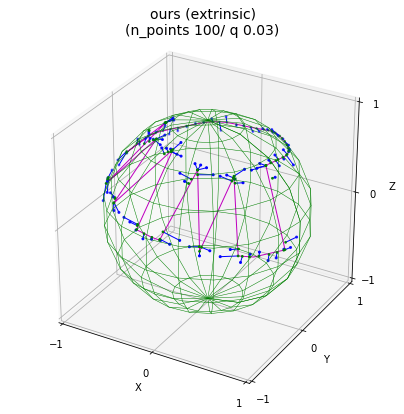


iteration ended at 9
total distance is 0.804
distinct projection : 95 / 100 
training time 62.602 s


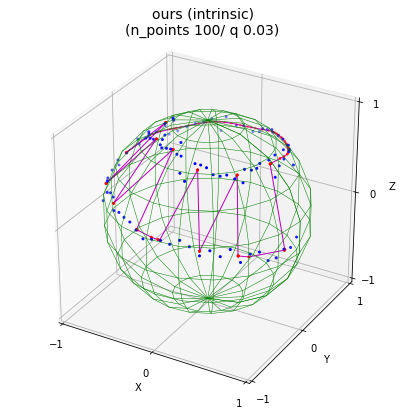

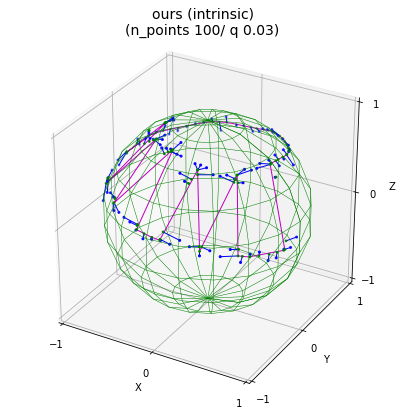


iteration ended at 9
total distance is 0.819
distinct projection : 96 / 100 
training time 61.845 s


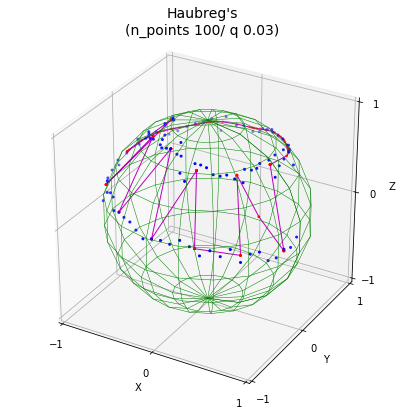

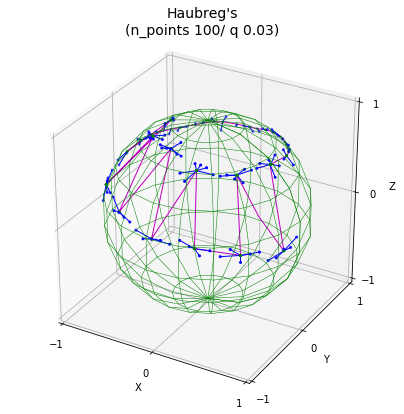


iteration ended at 8
total distance is 1.332
distinct projection : 38 / 100 
training time 8.353 s


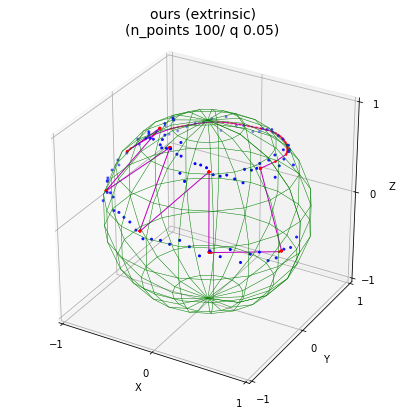

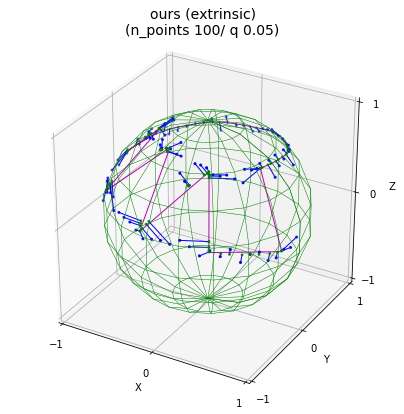


iteration ended at 9
total distance is 1.607
distinct projection : 92 / 100 
training time 62.187 s


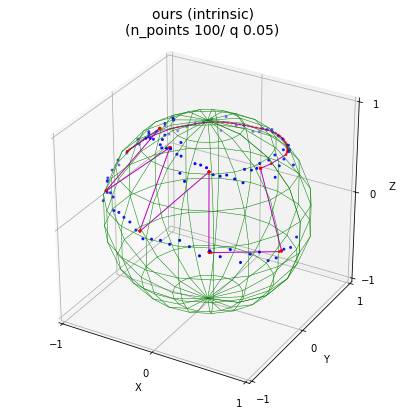

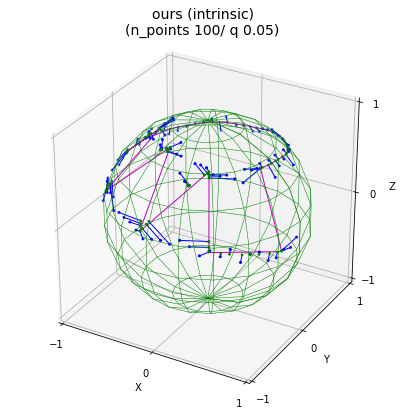


iteration ended at 9
total distance is 1.609
distinct projection : 94 / 100 
training time 62.247 s


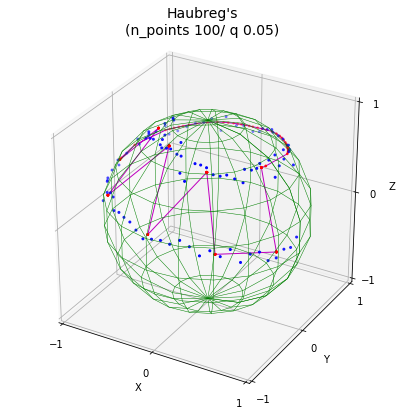

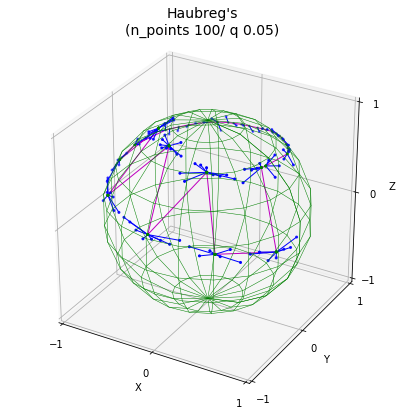


iteration ended at 9
total distance is 2.321
distinct projection : 36 / 100 
training time 9.140 s


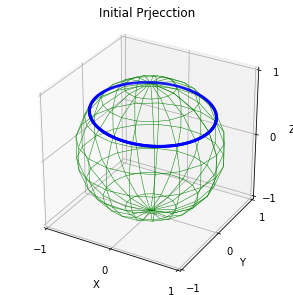

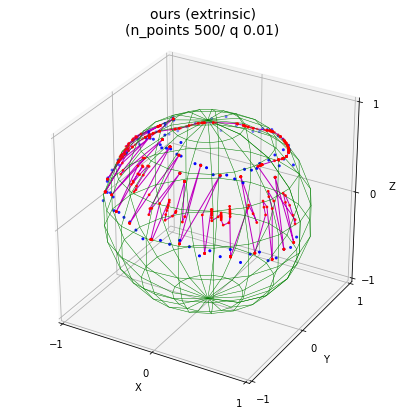

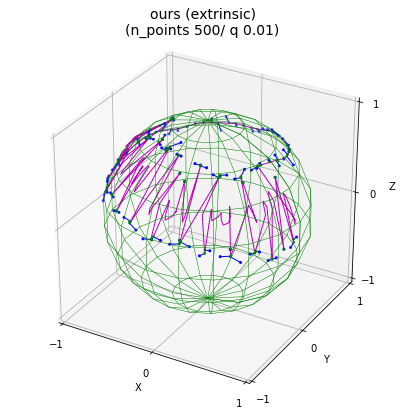


iteration ended at 4
total distance is 0.350
distinct projection : 98 / 100 
training time 195.723 s


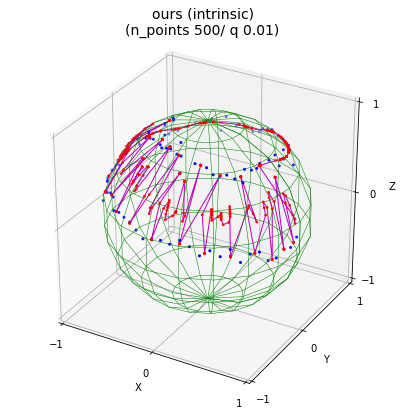

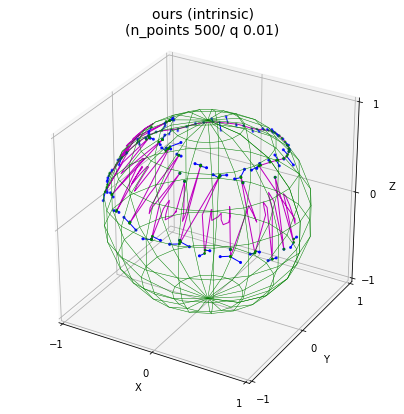


iteration ended at 6
total distance is 0.376
distinct projection : 96 / 100 
training time 228.911 s


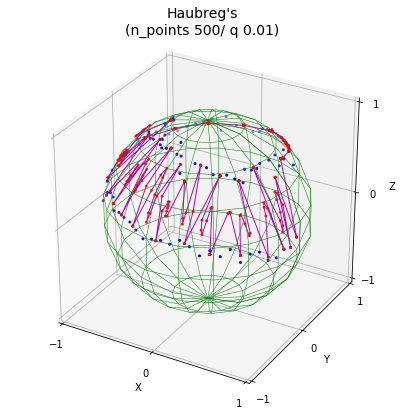

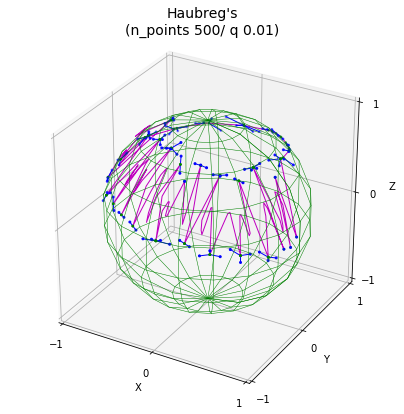


iteration ended at 9
total distance is 0.713
distinct projection : 44 / 100 
training time 43.003 s


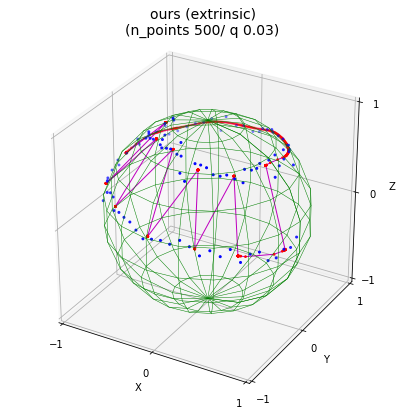

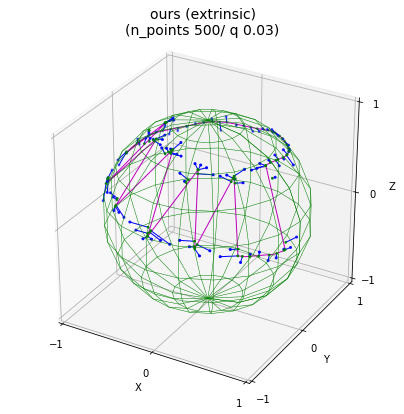


iteration ended at 9
total distance is 0.896
distinct projection : 93 / 100 
training time 331.499 s


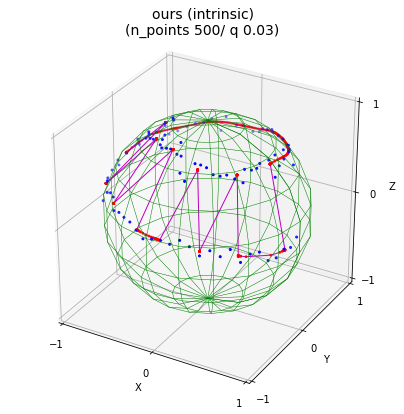

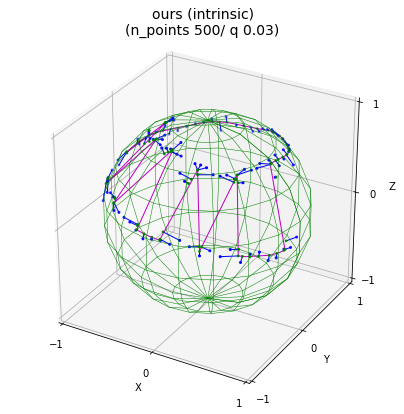


iteration ended at 9
total distance is 0.817
distinct projection : 95 / 100 
training time 332.712 s


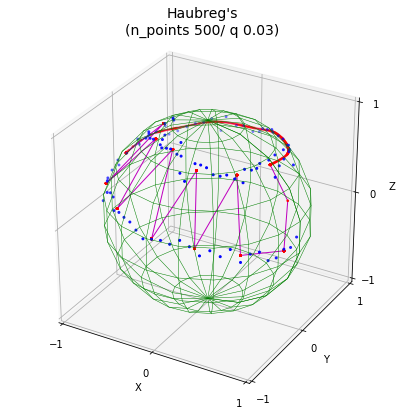

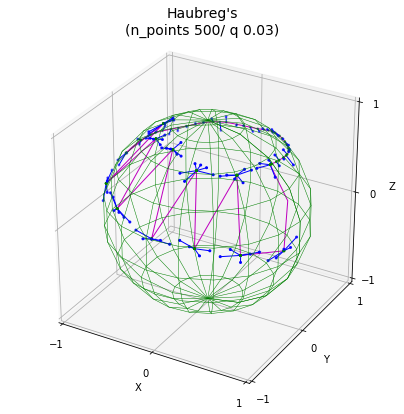


iteration ended at 9
total distance is 1.263
distinct projection : 50 / 100 
training time 51.812 s


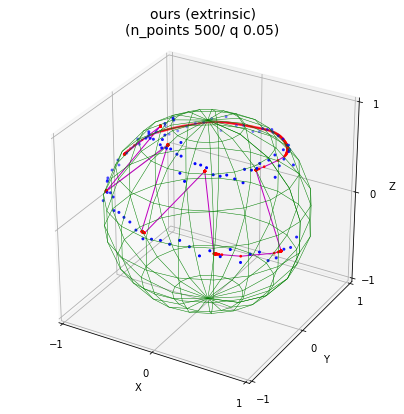

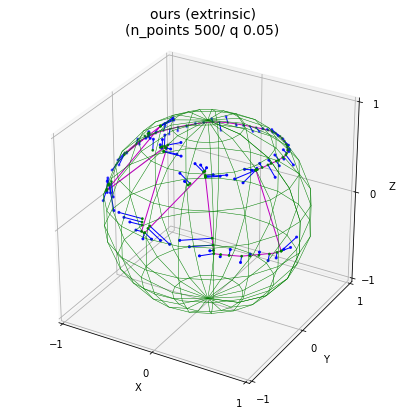


iteration ended at 9
total distance is 1.547
distinct projection : 91 / 100 
training time 332.902 s


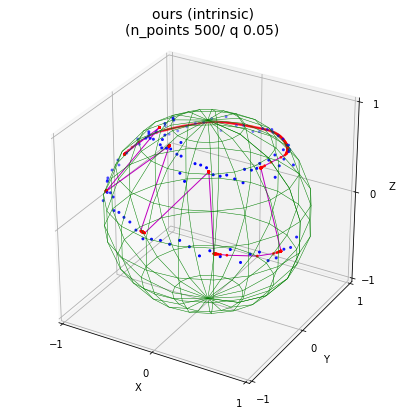

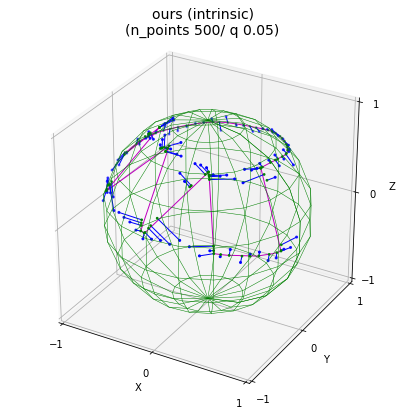


iteration ended at 9
total distance is 1.572
distinct projection : 95 / 100 
training time 337.315 s


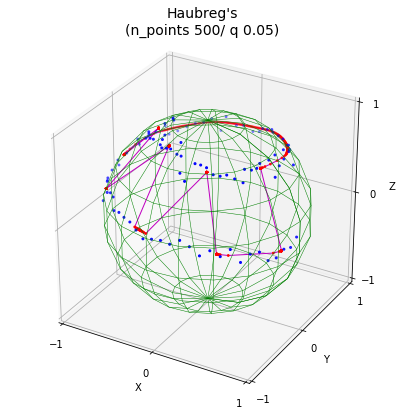

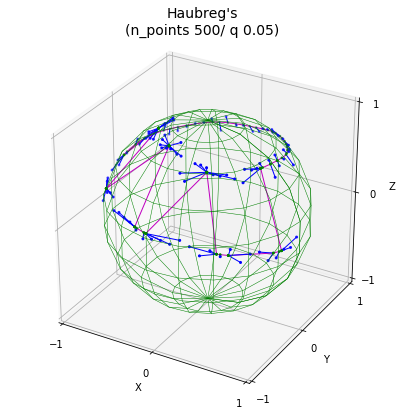


iteration ended at 9
total distance is 1.918
distinct projection : 50 / 100 
training time 49.308 s


In [62]:
n_points= [100, 500]; neighs= [0.01, 0.03, 0.05]
data_name= 'spiral'

# initialization (principal circle)
p_, p3 = pga_circle(x_theta, False)

# initial projection
for n in n_points:
    init_project = np.zeros(shape=[2, n])
    init_project[0, :] = p3
    init_project[1, :] = np.arange(0, 2*m.pi, 2*m.pi/n)
    init_project = inv_rotate(p_, rad2euclid(init_project))

    plot_sphere(init_project, "Initial Prjecction\n")

    for q in neighs:
        # iteration
        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=False,
                                             print_last=True, save_fig=True, data_name=data_name)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=True, intrinsic=True,
                                             print_last=True, save_fig=True, data_name=data_name)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

        start_time= time.time()
        points, _, _ = train_principal_curve(x, init_project, iter=10, neigh_ratio=q, exact=False, intrinsic=False,
                                             print_last=True, save_fig=True, data_name=data_name)
        end_time= time.time()
        print("training time %.3f s"%(end_time-start_time))

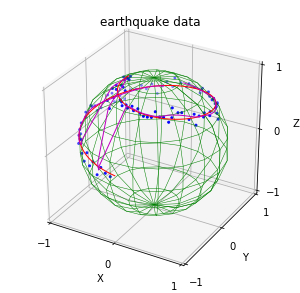

In [40]:
plot_sphere(x,"", extra =x_true, line=True, extra2=points)

## 4. Code Wrapper

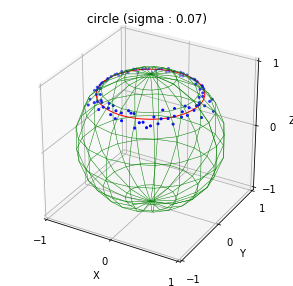

In [16]:
def simulated_data(d_type, sigma1=0.0, sigma2=0.07,  n=100, is_print=True, freq=8, amp=1/3, wind=1.5):
    # simulation data generation
    # input:= d_type: simulation data 종류 (circle, wave, spiral)
    #         그 외에는 각 데이터마다 필요한 hyper-parameter들
    #         sigma 1: 경도에 더해지는 noise의 분산
    #         sigma 2: 위도에 더해지는 noise의 분산
    #         n: data point 갯수
    #         freq: wave의 frequency
    #         amp: wave위 amplitude
    #         wind: spiral의 감는 수
    if d_type == "circle":
        theta = np.linspace(0,np.pi*2,n) + np.pi 
        phi = np.array([np.pi/4]*n)
    elif d_type == "wave":
        theta = np.linspace(0,np.pi*2,n)
        phi = np.sin(theta*freq)*amp + np.pi/2
    elif d_type =="spiral":
        theta = np.linspace(0,np.pi*2*wind,n) + np.pi
        phi = np.linspace(np.pi/8,np.pi/2,n)
    else :
        raise AssertionError("Wrong d_type !! d_type should be one of (circle, wave, spiral)")
        
    x_true= np.vstack((np.sin(phi)*np.cos(theta), np.sin(phi)*np.sin(theta) ,np.cos(phi)))

    noise1 = np.random.normal(0,sigma1,n)
    noise2 = np.random.normal(0,sigma2,n)
    theta= theta + noise1
    phi= phi + noise2
    x_noise= np.vstack((np.sin(phi)*np.cos(theta), np.sin(phi)*np.sin(theta) ,np.cos(phi)))

    x_polar= np.vstack((phi,theta))

    if is_print:
        plot_sphere(x_noise,title="{} (sigma : {})".format(d_type, sigma2), extra =x_true, line=True)
    
    return x_true, x_noise, x_polar
    
x_true, x_noise, x_polar = simulated_data(d_type="circle", n=100)

#### Simultaion (results will be saved in a excel file)


sigma : 0.07 is start !!
1 / 2 processing ...


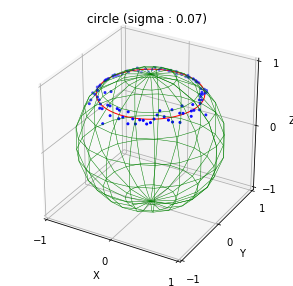

iteration ended at 6
total distance is 0.676
distinct projection : 98 / 100 
iteration ended at 6
total distance is 0.682
distinct projection : 99 / 100 
iteration ended at 9
total distance is 3.074
distinct projection : 60 / 100 
2 / 2 processing ...
iteration ended at 9
total distance is 0.649
distinct projection : 93 / 100 
iteration ended at 9
total distance is 0.560
distinct projection : 97 / 100 
iteration ended at 9
total distance is 3.547
distinct projection : 61 / 100 

sigma : 0.1 is start !!
1 / 2 processing ...


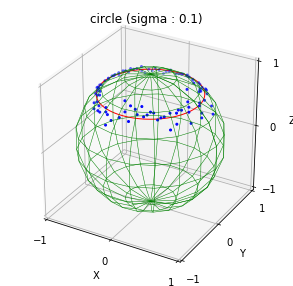

iteration ended at 9
total distance is 0.991
distinct projection : 98 / 100 
iteration ended at 9
total distance is 0.882
distinct projection : 94 / 100 
iteration ended at 9
total distance is 3.820
distinct projection : 57 / 100 
2 / 2 processing ...
iteration ended at 9
total distance is 1.263
distinct projection : 94 / 100 


c:\users\lg\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:119: RuntimeWarning: invalid value encountered in arccos
c:\users\lg\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in greater
c:\users\lg\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:161: RuntimeWarning: invalid value encountered in greater


iteration ended at 1
total distance is 0.666
distinct projection : 100 / 100 
iteration ended at 9
total distance is 3.569
distinct projection : 65 / 100 


In [18]:
import openpyxl

d_type= "circle"         # data type (circle, wave, spiral)  
sigma2_list= [0.07, 0.1] # 위도에 더해지는 noise의 분산 종류
q= 0.01                  # hyperparameter q (neighborhood)
n_point= 100            # curve point 갯수
repeat=2                # 몇번 반복실험 할건지

wb = openpyxl.Workbook()

for j, sigma2 in enumerate(sigma2_list):
    print("\nsigma : {} is start !!".format(sigma2))
    
    ws = wb.create_sheet("sigma {}".format(sigma2))
    ws.cell(row= 1,column= 1).value = 'repeat'
    ws.cell(row= 1,column= 2).value = 'Intrinsic'
    
    ws.cell(row= 2,column= 2).value = 'noisy recon'
    ws.cell(row= 2,column= 3).value = 'noisy projections'
    ws.cell(row= 2,column= 4).value = 'clean recon'
    ws.cell(row= 2,column= 5).value = 'clean projections'
    
    ws.cell(row= 1,column= 7).value = 'Extrinsic'
    
    ws.cell(row= 2,column= 7).value = 'noisy recon'
    ws.cell(row= 2,column= 8).value = 'noisy projections'
    ws.cell(row= 2,column= 9).value = 'clean recon'
    ws.cell(row= 2,column= 10).value = 'clean projections'

    ws.cell(row= 1,column= 12).value = 'Hauberg'
    
    ws.cell(row= 2,column= 12).value = 'noisy recon'
    ws.cell(row= 2,column= 13).value = 'noisy projections'
    ws.cell(row= 2,column= 14).value = 'clean recon'
    ws.cell(row= 2,column= 15).value = 'clean projections'

    for n in range(repeat):
        print("{} / {} processing ...".format(n+1, repeat))
        if n ==0 :
            x_true, x_noise, x_polar = simulated_data(d_type=d_type, sigma2=sigma2, is_print=True)
        else :
            x_true, x_noise, x_polar = simulated_data(d_type=d_type, sigma2=sigma2, is_print=False)

        # initialization (principal circle)
        p_, p3 = pga_circle(x_polar, False)

        # initial projection
        init_project = np.zeros(shape=[2, n_point])
        init_project[0, :] = p3
        init_project[1, :] = np.arange(0, 2*m.pi, 2*m.pi/n_point)
        init_project = inv_rotate(p_, rad2euclid(init_project))

        # exact (extrinsic)
        points, train_dist, lambda_arr= train_principal_curve(data=x_noise, init_project=init_project, iter=10,
                                                              neigh_ratio=q, intrinsic=False, exact=True, is_print=False)
        proj_num_train = len(np.unique(lambda_arr))

        d, points, lambda_arr, _, _= project_curve(x_true, points, exact = True)
        test_dist = sum(d**2)
        proj_num_test = len(np.unique(lambda_arr))

        ws.cell(row= n+3,column= 1).value = n+1
        ws.cell(row= n+3,column= 2).value = train_dist
        ws.cell(row= n+3,column= 3).value = proj_num_train
        ws.cell(row= n+3,column= 4).value = test_dist
        ws.cell(row= n+3,column= 5).value = proj_num_test
        
        # exact (intrinsic)
        points, train_dist, lambda_arr= train_principal_curve(data=x_noise, init_project=init_project, iter=10,
                                                              neigh_ratio=q, intrinsic=True, exact=True, is_print=False)
        proj_num_train = len(np.unique(lambda_arr))

        d, points, lambda_arr, _, _= project_curve(x_true, points, exact = True)
        test_dist = sum(d**2)
        proj_num_test = len(np.unique(lambda_arr))

        ws.cell(row= n+3,column= 7).value = train_dist
        ws.cell(row= n+3,column= 8).value = proj_num_train
        ws.cell(row= n+3,column= 9).value = test_dist
        ws.cell(row= n+3,column= 10).value = proj_num_test

        # not exact (Haubergs)
        points, train_dist, lambda_arr= train_principal_curve(x_noise, init_project, iter=10,
                                                              neigh_ratio=q, intrinsic=False, exact=False, is_print=False)
        proj_num_train = len(np.unique(lambda_arr))
      
        d, points, lambda_arr, _, _= project_curve(x_true, points, exact = False)
        test_dist = sum(d**2)
        proj_num_test = len(np.unique(lambda_arr))

        # save as excel file
        ws.cell(row= n+3,column= 12).value = train_dist
        ws.cell(row= n+3,column= 13).value = proj_num_train
        ws.cell(row= n+3,column= 14).value = test_dist
        ws.cell(row= n+3,column= 15).value = proj_num_train
                                     
        wb.save("results/{}_points{}_neigh{}.xlsx".format(d_type, n_point, q))
wb.close()

## Extra) projection process plot

In [28]:
def geoseg(a_0,b_0):
    a_0 = a_0/np.sqrt(np.sum(a_0**2))
    b_0 = b_0/np.sqrt(np.sum(b_0**2))

    rot_a = rotate(a_0, np.stack([a_0,b_0], axis=1))
    a_1 = rot_a[:,0]
    b_1 = rot_a[:,1]

    c= rad2euclid(np.array([np.pi/2., euclid2rad(rot_a)[1,1] + np.pi/2.]))
    rot_c = rotate(c, rot_a)
    a_2 = rot_c[:,0]
    b_2 = rot_c[:,1]

    n = euclid2rad(rot_c)[1,0]
    m =  euclid2rad(rot_c)[1,1]
    
    if (np.maximum(n,m)- np.minimum(n,m) < np.pi ):
        line_2 = np.linspace(np.minimum(n,m), np.maximum(n,m), num=100)
    else :
        line_2 = np.linspace(np.maximum(n,m), np.minimum(n,m) + 2*np.pi, num=100)
    line_2 = rad2euclid(np.stack((np.zeros(line_2.shape)+np.pi/2, line_2), axis=0))

    return inv_rotate(a_0, inv_rotate(c, line_2))

In [29]:
x_0 = np.array([1,-2,-3])
b_0 = np.array([-2,-2,-1])
a_0 = np.array([1,-1,0.5])
x_0 = x_0/np.sqrt(np.sum(x_0**2))
a_0 = a_0/np.sqrt(np.sum(a_0**2))
b_0 = b_0/np.sqrt(np.sum(b_0**2))

rot_a = rotate(a_0, np.stack([x_0,a_0,b_0], axis=1))
x_1 = rot_a[:,0]
a_1 = rot_a[:,1]
b_1 = rot_a[:,2]

c= rad2euclid(np.array([np.pi/2., euclid2rad(rot_a)[1,2] + np.pi/2.]))
rot_c = rotate(c, rot_a)
x_2 = rot_c[:,0]
a_2 = rot_c[:,1]
b_2 = rot_c[:,2]

proj_2 = np.copy(x_2)
proj_2 = euclid2rad(proj_2)
proj_2[0] = np.pi/2
proj_2 = rad2euclid(proj_2)
proj_1 = inv_rotate(c, proj_2)
proj_0 = inv_rotate(a_0, proj_1)

line_0 = geoseg(a_0, b_0)
line_1 = geoseg(a_1, b_1)
line_2 = geoseg(a_2, b_2)
pline_2 = geoseg(proj_2, x_2)
pline_1 = geoseg(proj_1, x_1)
pline_0 = geoseg(proj_0, x_0)

c2 = rotate(c, c)

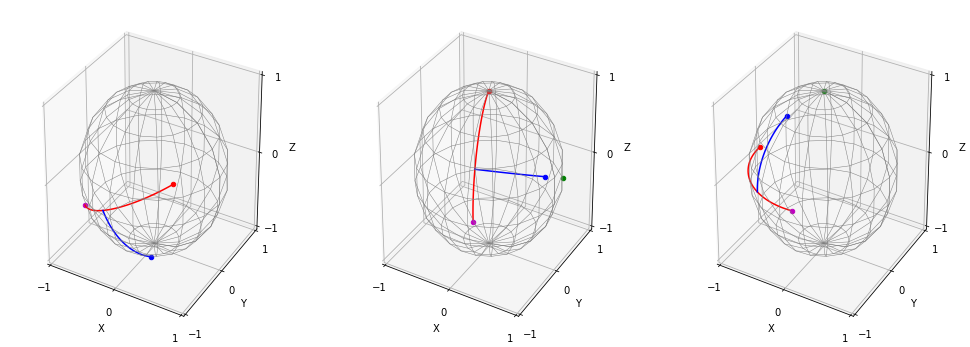

In [32]:
fig = plt.figure(figsize = (17,6))
ax = fig.add_subplot(131, projection='3d')

# plot sphere
u1, v1 = np.mgrid[0:2*np.pi:20j, 0:np.pi:10j]
x_ = np.cos(u1)*np.sin(v1)
y_ = np.sin(u1)*np.sin(v1)
z_ = np.cos(v1)
ax.plot_wireframe(x_, y_, z_, color="gray", linewidth= 0.5)

ax.scatter(x_0[0], x_0[1], x_0[2], c= 'b', s=20)
ax.scatter(a_0[0], a_0[1], a_0[2], c= 'r', s=20)
ax.scatter(b_0[0], b_0[1], b_0[2], c= 'm', s=20)
ax.plot(line_0[0,:],line_0[1,:],line_0[2,:], c='r')
ax.plot(pline_0[0,:],pline_0[1,:],pline_0[2,:], c='b')


#plot data
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

ax.set_xlim([-1,1])
ax.set_ylim([-1,1])
ax.set_zlim([-1,1])

ax.set_xticks([-1, 0, 1])
ax.set_yticks([-1, 0, 1])
ax.set_zticks([-1, 0, 1])

ax = fig.add_subplot(132, projection='3d')

# plot sphere
u1, v1 = np.mgrid[0:2*np.pi:20j, 0:np.pi:10j]
x_ = np.cos(u1)*np.sin(v1)
y_ = np.sin(u1)*np.sin(v1)
z_ = np.cos(v1)
ax.plot_wireframe(x_, y_, z_, color="gray", linewidth= 0.5)

ax.scatter(x_1[0], x_1[1], x_1[2], c= 'b', s=20)
ax.scatter(a_1[0], a_1[1], a_1[2], c= 'r', s=20)
ax.scatter(b_1[0], b_1[1], b_1[2], c= 'm', s=20)
ax.plot(line_1[0,:],line_1[1,:],line_1[2,:], c='r')
ax.scatter(c[0], c[1], c[2], c= 'g', s=20)
ax.plot(pline_1[0,:],pline_1[1,:],pline_1[2,:], c='b')

#plot data
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

ax.set_xlim([-1,1])
ax.set_ylim([-1,1])
ax.set_zlim([-1,1])

ax.set_xticks([-1, 0, 1])
ax.set_yticks([-1, 0, 1])
ax.set_zticks([-1, 0, 1])

ax = fig.add_subplot(133, projection='3d')

# plot sphere
u1, v1 = np.mgrid[0:2*np.pi:20j, 0:np.pi:10j]
x_ = np.cos(u1)*np.sin(v1)
y_ = np.sin(u1)*np.sin(v1)
z_ = np.cos(v1)
ax.plot_wireframe(x_, y_, z_, color="gray", linewidth= 0.5)

ax.scatter(x_2[0], x_2[1], x_2[2], c= 'b', s=20)
ax.scatter(a_2[0], a_2[1], a_2[2], c= 'r', s=20)
ax.scatter(b_2[0], b_2[1], b_2[2], c= 'm', s=20)
ax.plot(line_2[0,:],line_2[1,:],line_2[2,:], c='r')
ax.scatter(c2[0], c2[1], c2[2], c= 'g', s=20)
ax.plot(pline_2[0,:],pline_2[1,:],pline_2[2,:], c='b')

#plot data
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

ax.set_xlim([-1,1])
ax.set_ylim([-1,1])
ax.set_zlim([-1,1])

ax.set_xticks([-1, 0, 1])
ax.set_yticks([-1, 0, 1])
ax.set_zticks([-1, 0, 1])

plt.show()